In [ ]:
import anndata as ad
import matplotlib.pyplot as plt
import muon as mu
import pandas as pd
import scanpy as sc
import numpy as np
import scirpy as ir
import os
import seaborn as sns
import matplotlib as mpl
import matplotlib.ticker as ticker
mpl.rcParams['font.family'] = 'Arial'
figPath = "../figures/figure6"
os.makedirs(figPath, exist_ok=True)
datapath = '../data'
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 14

In [ ]:
adata_YBC_native_Fib = sc.read_h5ad(f"{datapath}/adata-YBC-native-Fib-4.21.h5ad")
adata_YBC_exter_Fib = sc.read_h5ad(f"{datapath}/adata-YBC-exter-Fib-4.21.h5ad")
adata_OBC_exter_Fib = sc.read_h5ad(f"{datapath}/adata-OBC-exter-Fib-4.21.h5ad")

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [3]:
def clu(adata, key_added="majorType-fix", 
        n_neighbors=50, n_pcs=30, 
        rep='X_pca_harmony', 
        do_har=False, 
        max_iter=20, 
        do_scrublet=False, 
        har_key='batch', 
        resolution=1):
    # Computing the neighborhood graph
    if do_scrublet:
        n0 = adata.shape[0]
        print("{0} Cell number: {1}".format(key_added, n0))
        sc.external.pp.scrublet(adata)
        adata = adata[adata.obs['predicted_doublet']==False,:].copy()
        print("{0} Cells retained after scrublet, {1} cells reomved.".format(adata.shape[0], n0-adata.shape[0]))
    else:
        print("Ignoring processing doublet cells...")
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    sc.pp.pca(adata, svd_solver='arpack', use_highly_variable=True)
    if do_har and len(adata.obs[har_key].cat.categories) > 1:
        sc.external.pp.harmony_integrate(adata, key=har_key,max_iter_harmony=max_iter)
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    else:
        print("Evaluating neighbors only...")
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    # Run UMAP
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=resolution, key_added=key_added)
    sc.pl.umap(adata, color=key_added, legend_fontoutline=True, palette=sc.pl.palettes.default_20, legend_loc="on data")
    return adata

def anno(adata:ad.AnnData, annoDict:dict, obsKey='cnv_status', obsVal='cnv_leiden', default="Unknown"):
  if default is not None:
    adata.obs[obsKey] = default
  for key in annoDict.keys():
    adata.obs.loc[adata.obs[obsVal].isin(annoDict[key]), obsKey] = key
  return adata

In [4]:
# 自定义加权欧氏距离计算器
class AnomalyAwareDistance:
    def __init__(self, alpha=1.0, epsilon=1e-8):
        self.alpha = alpha
        self.epsilon = epsilon  # 数值稳定系数
        
    def _safe_zscore(self, X):
        """带数值稳定的Z-Score计算"""
        mean = np.nanmean(X, axis=0)
        std = np.nanstd(X, axis=0)
        std = np.where(std < self.epsilon, self.epsilon, std)
        return np.abs((X - mean) / std)
    
    def _robust_weights(self, X):
        """带异常处理的权重计算"""
        z_scores = self._safe_zscore(X)
        weights = np.power(z_scores, self.alpha)
        
        # 处理全零权重列
        max_weights = np.max(weights, axis=0)
        max_weights = np.where(max_weights == 0, 1, max_weights)
        return weights / max_weights
    
    def __call__(self, u, v):
        X = np.vstack([u, v])
        weights = self._robust_weights(X)
        final_weights = np.max(weights, axis=0)
        return np.sqrt(np.nansum(final_weights * (u - v)**2))

In [270]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import numpy as np
import pandas as pd
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
import matplotlib.pyplot as plt
def get_batch_groups(adata, groupby:str, clusters:str, key_added:str):
    """
    对adata数据集中的样本进行分组，并进行层次聚类分析。

    Args:
        adata (AnnData): 包含样本数据的AnnData对象。
        groupby (str): 用于分组的列名。
        clusters (str): 用于分类的列名。
        key_added (str): 将在adata.obs中添加的键名，用于存储聚类结果。

    Returns:
        AnnData: 包含聚类结果的adata对象。

    """
    barlabels = adata.obs[groupby].cat.categories
    cell_types = adata.obs[clusters].cat.categories
    age_df = pd.DataFrame(columns = list(cell_types))
    for bar in barlabels:
        d1 = pd.DataFrame([len(adata[(adata.obs[clusters] == ct) & (adata.obs[groupby] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
        age_df = pd.concat([age_df, d1])
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    scaler = StandardScaler()
    age_scaledf = scaler.fit_transform(age_normdf)
    age_scaledf = pd.DataFrame(age_scaledf, columns=age_normdf.columns, index = age_normdf.index)
    age_scaledf = age_scaledf.T
    # 创建自定义距离计算器
    custom_dist = AnomalyAwareDistance(alpha=2.0)

    # 计算距离矩阵
    distance_matrix = pdist(age_scaledf.T, metric=custom_dist)

    # 执行层次聚类
    Z = linkage(distance_matrix, method='ward')

    # 可视化树状图
    plt.figure(figsize=(8, 3))
    gr = dendrogram(Z, 
                    color_threshold=0.5*max(Z[:,2]),
                    labels=age_scaledf.columns.tolist(),
                    leaf_font_size=12)
    group_list = [gr['ivl'][i] if gr['leaves_color_list'][i] == 'C0' else gr['leaves_color_list'][i] for i in range(len(gr['ivl']))]
    plt.savefig(f"figures/B2G_tree.svg", bbox_inches='tight')

    annot = {}
    for i, batch in enumerate(gr['ivl']):
        if group_list[i] in annot.keys():
            annot[group_list[i]].append(batch)
        else:
            annot[group_list[i]] = [batch]
    adata = anno(adata, annot, key_added, groupby)
    adata.obs[key_added] = adata.obs[key_added].astype('category')
    return adata

In [19]:
adata_YBC_native_Fib.obs['batch'].cat.categories

Index(['1T', '2T', '3T', '5N', '5T', '6N', '6T', '8T', '9T', '10T', '10N',
       '11T', '12N', '12T', '13T', '15T', '16N', '16T', '17T', '19T', '20T',
       '21T', '22T'],
      dtype='object')

In [20]:
adata_YBC_native_Fib = adata_YBC_native_Fib[adata_YBC_native_Fib.obs['batch'].isin([
  '5N', '6N','10N','12N',  '16N','1T', '2T', '3T',  '5T', '6T', '8T', '9T', '10T','15T','17T', '20T',
  '21T', '22T'
])]

In [22]:
adata_YBC_native_Fib.obs['sample'] = adata_YBC_native_Fib.obs['batch']

Ignoring processing doublet cells...
Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


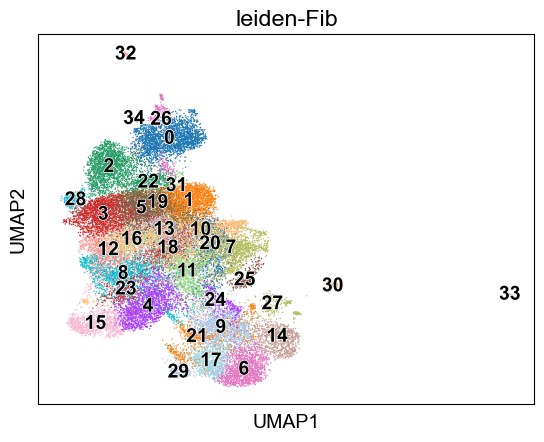

In [50]:
adata_YBC_native_Fib.obs['tech'] = '5'
adata_YBC_native_Fib.obs.loc[adata_YBC_native_Fib.obs['sample'].isin(['1T', '2T', '3T']), 'tech'] = '3'
adata_YBC_native_Fib.obs['tech'] = adata_YBC_native_Fib.obs['tech'].astype('category')
adata_YBC_native_Fib = clu(adata_YBC_native_Fib, 'leiden-Fib', n_pcs=30, har_key='tech', do_har=False, resolution=2, rep='X_pca')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


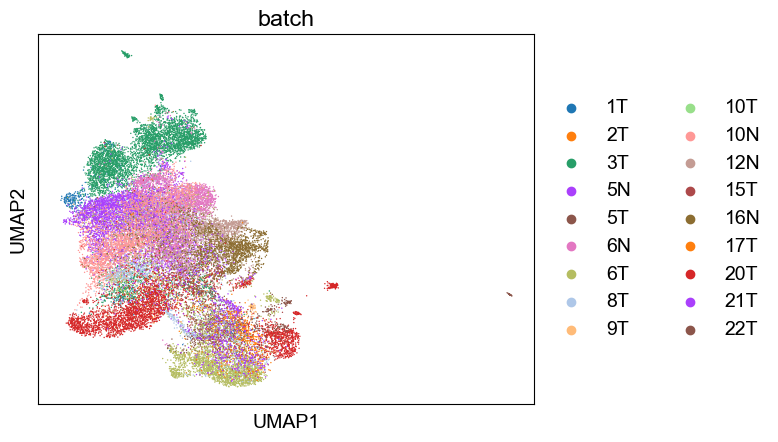

In [25]:
sc.pl.umap(adata_YBC_native_Fib, color=['batch'])

In [ ]:
annot = {
  'C1': ['3T'],
  'C2': ['5T'],
  'C3': ['20T'],
  'C4': ['5N', '6N', '10N', '12N', '16N'],
  'C5': ['9T'],
  'C6': ['22T'],
}
adata_YBC_native_Fib = anno(adata_YBC_native_Fib, annot, 'groups', 'batch')
adata_YBC_native_Fib.obs['groups'] = adata_YBC_native_Fib.obs['groups'].astype('category')
adata_YBC_native_Fib = clu(adata_YBC_native_Fib, 'leiden-Mye', n_pcs=30, har_key='groups', do_har=True, resolution=1)

Ignoring processing doublet cells...
Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


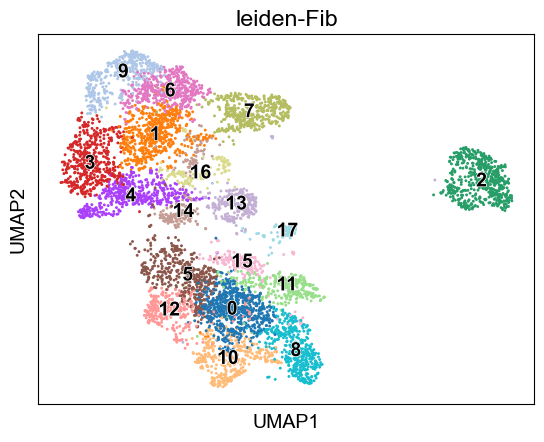

Ignoring processing doublet cells...
Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


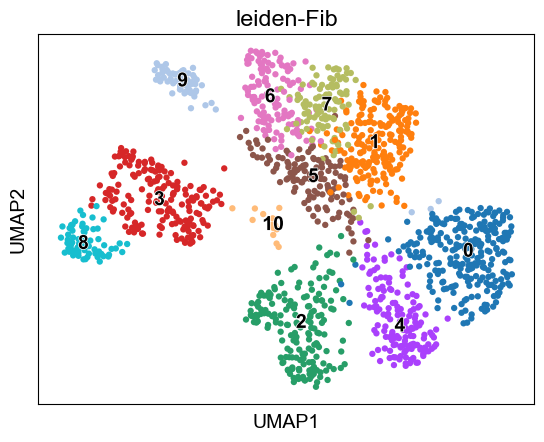

In [24]:
adata_OBC_exter_Fib = clu(adata_OBC_exter_Fib, 'leiden-Fib', n_pcs=30, har_key='batch', do_har=False, resolution=1, rep='X_pca')
adata_YBC_exter_Fib = clu(adata_YBC_exter_Fib, 'leiden-Fib', n_pcs=30, har_key='batch', do_har=False, resolution=1, rep='X_pca')

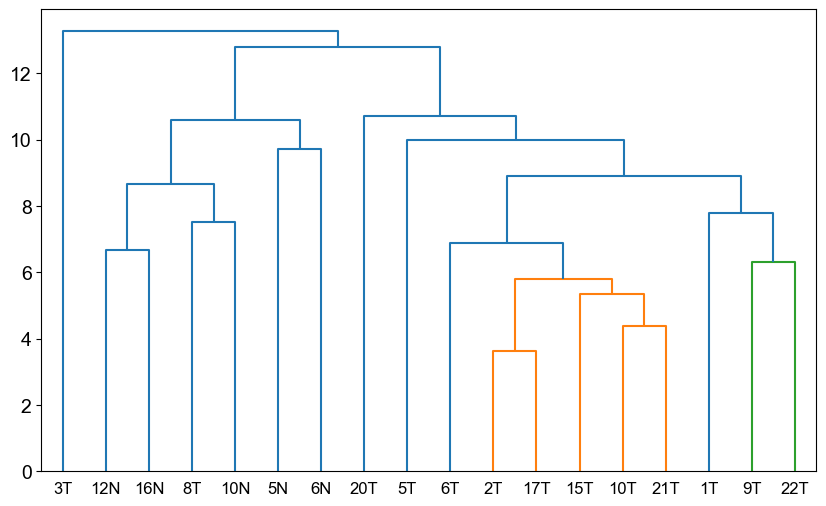

In [51]:
adata_YBC_native_Fib = get_batch_groups(adata_YBC_native_Fib, 'batch', 'leiden-Fib', 'groups')
# adata_YBC_exter_Fib = get_batch_groups(adata_YBC_exter_Fib, 'batch', 'leiden-Fib', 'groups')
# adata_OBC_exter_Fib = get_batch_groups(adata_OBC_exter_Fib, 'batch', 'leiden-Fib', 'groups')

Ignoring processing doublet cells...


2025-04-22 07:00:35,315 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-22 07:00:46,097 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-22 07:00:46,235 - harmonypy - INFO - Iteration 1 of 20
2025-04-22 07:00:52,325 - harmonypy - INFO - Iteration 2 of 20
2025-04-22 07:00:58,209 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


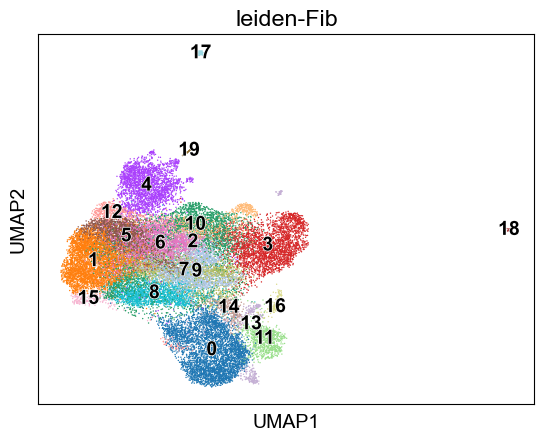

In [52]:
adata_YBC_native_Fib = clu(adata_YBC_native_Fib, 'leiden-Fib', n_pcs=30, har_key='groups', do_har=True, resolution=1)

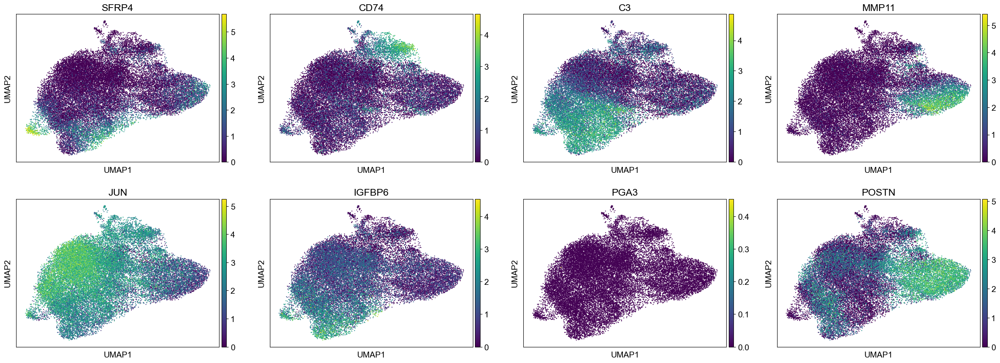

In [97]:
sc.pl.umap(adata_YBC_native_Fib, color=['SFRP4','CD74', 'C3', 'MMP11', 'JUN', 'IGFBP6', 'PGA3', 'POSTN'], size=10)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


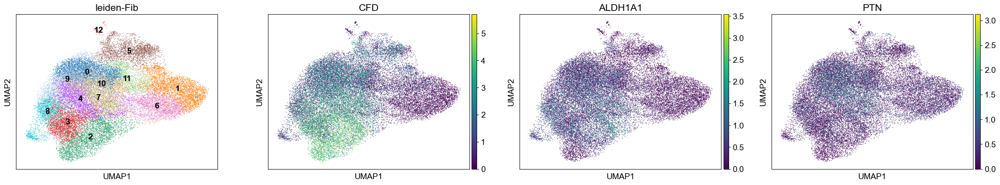

In [103]:
sc.pl.umap(adata_YBC_native_Fib, color=['leiden-Fib', 'CFD', 'ALDH1A1', 'PTN'], legend_loc='on data')

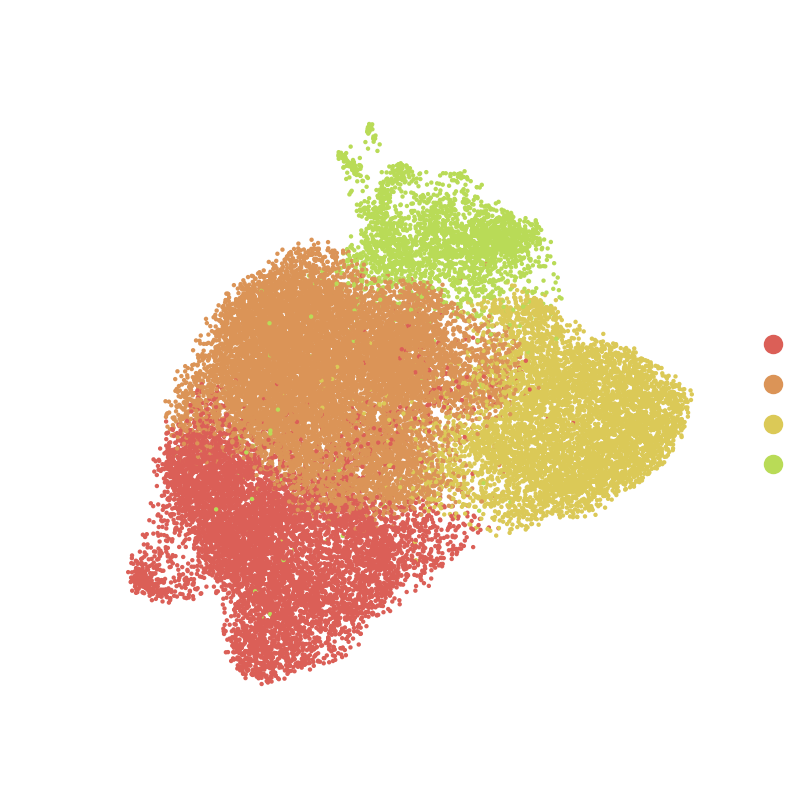

In [352]:
annot = {
  's01_stCAF_C3': ['2', '3', '8'],
  's02_iCAF_DLK1': ['0', '4', '7', '9', '10', '11'],
  's03_mCAF_LRRC15': ['1', '6'],
  's04_apCAF_CD74': ['5', '12'],
}
adata_YBC_native_Fib = anno(adata_YBC_native_Fib, annot, 'anno-Fib', 'leiden-Fib')
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
palette = sns.color_palette("hls", 15)
sc.pl.umap(adata_YBC_native_Fib, color=['anno-Fib'], palette=palette,size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_Fib.png', dpi=400, bbox_inches='tight')

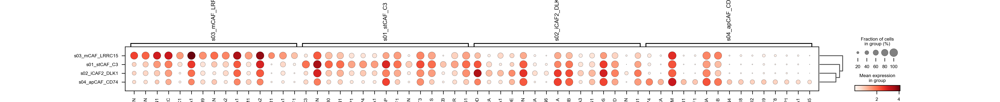

In [79]:
sc.tl.rank_genes_groups(adata_YBC_native_Fib, groupby='anno-Fib')
sc.tl.dendrogram(adata_YBC_native_Fib, groupby='anno-Fib')
sc.pl.rank_genes_groups_dotplot(adata_YBC_native_Fib, n_genes=15)

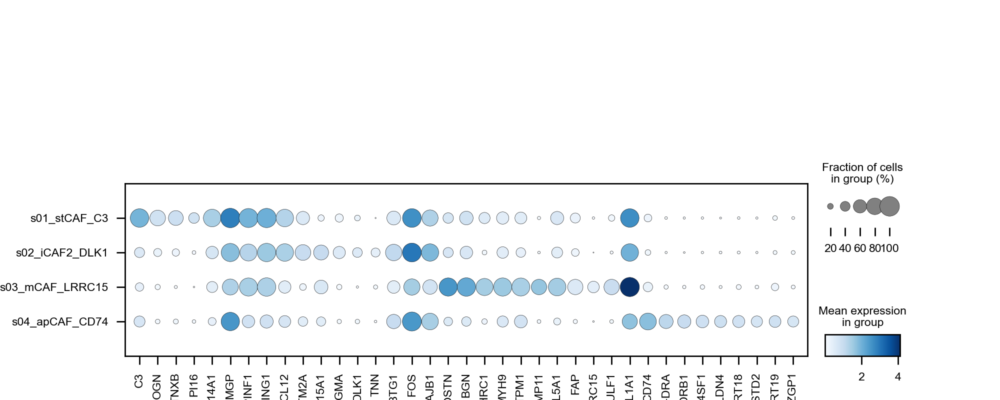

In [112]:
fig, ax = plt.subplots(1,1, figsize=(10,4))
sc.pl.dotplot(adata_YBC_native_Fib, cmap='Blues', groupby='anno-Fib',var_names=[
  'C3', 'OGN', 'TNXB', 'PI16','COL14A1','MGP', 'SERPINF1', 'SERPING1', 'CXCL12', 
  'ITM2A', 'COL15A1', 'RGMA', 'DLK1','TNN','BTG1', 'FOS', 'DNAJB1',
  'POSTN', 'BGN', 'CTHRC1', 'MYH9', 'TPM1', 'MMP11', 'COL5A1','FAP', 'LRRC15', 'SULF1','COL1A1',
  'CD74', 'HLA-DRA', 'HLA-DRB1', 'TM4SF1', 'CLDN4', 'KRT18', 'TACSTD2', 'KRT19', 'AZGP1',
], ax=ax,)
fig.savefig(f"{figPath}/Fib-heatmap.svg", bbox_inches='tight')

In [94]:
def propPlot(age_df, barlabels, ax, colors=sc.pl.palettes.default_20, xlabel='Patient ID', show_y=True, xrotate=90):
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    age_cumdf = pd.DataFrame([np.cumsum(age_normdf.loc[i,:]) for i in barlabels], index=barlabels)
    norm_gdfs = age_normdf
    cum_gdfs = age_cumdf
    for i, col in enumerate(age_df.columns):
        height = norm_gdfs[col]
        starts = cum_gdfs[col] - height
        rects = ax.barh(barlabels, height, left=starts, height=0.9, color=colors[i], edgecolor='white', linewidth=0.5,
                        label=col, alpha=1)
    
        # ax.bar_label(rects,age_df.loc[:, col], label_type='center', color='lightgrey', fontsize=14)
    ax.legend( bbox_to_anchor=(1, 0.3), 
              handletextpad=0.5, frameon=False,
                          borderpad=0.4,
                          columnspacing=1,
                          handlelength=0.65,
              loc='lower left')
    if show_y:
        ax.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1,decimals=0))
        ax.set_xlabel('Cell proportions')
    else:
        ax.yaxis.set_visible(False)
    ax.set_ylabel(xlabel)
    # ax.set_yticks(barlabels)
    # ax.set_xticklabels(labels=barlabels,rotation=xrotate)
    ax.spines.top.set_visible(False)
    ax.spines.right.set_visible(False)

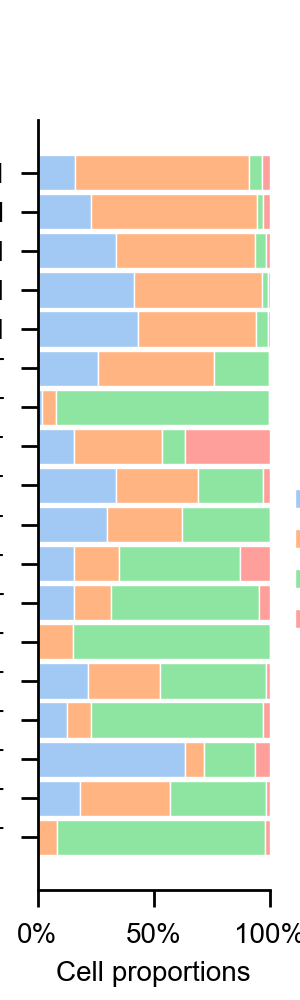

In [113]:
barlabels = ['5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T']
barlabels.reverse()
cell_types = list(adata_YBC_native_Fib.obs['anno-Fib'].unique())
cell_types.sort()
colors = sns.color_palette("pastel", 4)
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_YBC_native_Fib.obs["anno-Fib"] == ct) & (adata_YBC_native_Fib.obs["batch"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors= colors)
fig0.savefig(f"{figPath}/Fib_attr_proportions.svg",bbox_inches='tight')

In [114]:
import memento
import anndata as ad
import pandas as pd
def DE_memento_1d(adata: ad.AnnData, ctleft: list, ctright: list, groupby='annotation'):
  """
  使用 Memento 包分析单细胞测序数据中的动态变化。

  Args:
      adata (ad.AnnData): 单细胞测序数据的 AnnData 对象,adata.X requires raw data。
      ctleft (list): 左条件列表，表示刺激前的细胞类型或状态。
      ctright (list): 右条件列表，表示刺激后的细胞类型或状态。
      groupby (str, optional): 用于分组的注释列名。默认为 'annotation'。

  Returns:
      pd.DataFrame: Memento 分析的结果，包括差异表达分析、HT 1D moments 分析等。

  """
  _adata = adata[adata.obs[groupby].isin(ctleft + ctright)].copy()
  _adata = ad.AnnData(_adata.X, obs = _adata.obs, var = _adata.var)
  _adata.obs['stim'] = _adata.obs[groupby].isin(ctright)
  _adata.obs['stim'] = _adata.obs['stim'].astype('int')
  _adata.obs['capture_rate'] = 0.07
  memento.setup_memento(_adata, q_column='capture_rate')
  memento.create_groups(_adata, label_columns=['stim'])
  memento.compute_1d_moments(_adata, min_perc_group=.7)
  meta_df = memento.get_groups(_adata)
  meta_df['intercept'] = 1
  convariate = meta_df[['intercept']]
  treatment = (meta_df[['stim']] == 1).astype(float)
  
  memento.ht_1d_moments(_adata,
  covariate=convariate,
  treatment=treatment,
  num_cpus=16,
  resample_rep=False,
  )
  memento_results = memento.get_1d_ht_result(_adata)
  return(memento_results)

import scanpy as sc
import gseapy as gp
from gseapy import Msigdb
def prep_enrichr(adata, groupby):
  # de analysis
  sc.tl.rank_genes_groups(adata, groupby=groupby)
  sc.tl.dendrogram(adata, groupby=groupby)
  # get deg result
  result = adata.uns['rank_genes_groups']
  groups = result['names'].dtype.names
  degs = pd.DataFrame(
      {group + '_' + key: result[key][group]
      for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})
  return degs

def run_enrichr_genelist(genelist):
  kegg = gp.enrichr(genelist,
                  gene_sets='KEGG_2021_Human',
                  outdir=None)
  cc = gp.enrichr(genelist,
                      gene_sets='GO_Cellular_Component_2023',
                      outdir=None)
  hm = gp.enrichr(genelist,
                      gene_sets=['MSigDB_Hallmark_2020'],
                      outdir=None)
  mf = gp.enrichr(genelist,
                      gene_sets='GO_Molecular_Function_2023',
                      outdir=None)
  bp = gp.enrichr(genelist,
                      gene_sets=['GO_Biological_Process_2023'],
                      outdir=None)
  return kegg, cc, hm, mf, bp

def run_enrichr_scanpy(degs, group,direction='up', top_term=15, all_term=False, plot=True, threshold=0.5):
  # subset up or down regulated genes
  degs_sig = degs[degs[f'{group}_pvals_adj'] < 0.05]
  degs_up = degs_sig[degs_sig[f'{group}_logfoldchanges'] > threshold]
  degs_dw = degs_sig[degs_sig[f'{group}_logfoldchanges'] < -threshold]
  degs_used = degs_up[f'{group}_names'] if direction == 'up' else degs_dw[f'{group}_names']
  kegg, cc, hm, mf, bp = run_enrichr_genelist(degs_used)
  go_res = pd.concat([kegg.res2d.head(top_term),
                    hm.res2d.head(top_term), 
                    cc.res2d.head(top_term), 
                    bp.res2d.head(top_term), 
                    mf.res2d.head(top_term)])
  if plot:
    ax = gp.barplot(go_res, figsize=(6,20),
                group ='Gene_set',
                top_term=top_term,
                color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
                title ="The Most Enriched Terms")
  else:
    ax = None
  if all_term:
    go_res = pd.concat([kegg.res2d, hm.res2d, cc.res2d, bp.res2d, mf.res2d])
  return go_res, ax
  
def run_enrichr_memento(memento_results,direction='up', top_term=15):
  memento_sig = memento_results[memento_results['de_pval'] < 0.05]
  memento_up = memento_sig[memento_sig['de_coef'] > 0]
  memento_dw = memento_sig[memento_sig['de_coef'] < 0]
  degs_used = memento_up['gene'] if direction == 'up' else memento_dw['gene']
  kegg, cc, hm, mf, bp = run_enrichr_genelist(degs_used)
  go_res = pd.concat([kegg.res2d.head(15),
                      hm.res2d.head(15), 
                      cc.res2d.head(15), 
                      bp.res2d.head(15), 
                      mf.res2d.head(15)])
  ax = gp.barplot(go_res, figsize=(6,20),
              group ='Gene_set',
              top_term=top_term,
              color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
              title ="The Most Enriched Terms")
  return go_res, ax

In [ ]:
degs = prep_enrichr(adata_YBC_native_Fib, "anno-Fib")

In [ ]:
# degs = prep_enrichr(adata_YBC_native_Fib, "anno-Fib")
# gores_list = []
cell_types = ['C4_aCAF_CD74']
for ct in cell_types:
  print("Running enrichment for {}...".format(ct))
  go_res, _ = run_enrichr_scanpy(degs, ct,direction='up', top_term=15, all_term=True, plot=False)
  go_res = go_res =  go_res[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
  go_res['anno'] = ct
  gores_list.append(go_res)
gores = pd.concat(gores_list, axis=0, ignore_index=True)
gores

In [ ]:
gores[gores['anno'] == 'C2_iCAF2_DLK1'].sort_values(by='P-value')

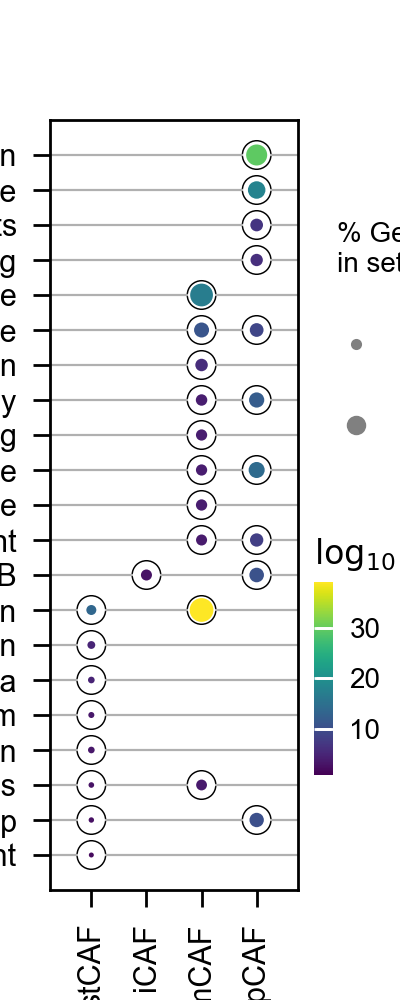

In [135]:
from gseapy.scipalette import SciPalette
sci = SciPalette()
NbDr = sci.create_colormap() 
ax = gp.dotplot(gores[gores['Gene_set'].isin(['MSigDB_Hallmark_2020'])],figsize=(2,5),
                x='anno',
                title="",
                size=2.5,
                cmap='viridis',
                top_term=10,
                show_ring=True)
ax.set_xticklabels(['stCAF', 'iCAF', 'mCAF', 'apCAF'],rotation=90, fontsize=11)
ax.set_yticklabels(ax.get_yticklabels(),rotation=0, fontsize=11)
ax.set_xlabel('')
ax.figure.savefig(f"{figPath}/Fib_MSigDB_Hallmark_2020.svg", bbox_inches='tight')

In [136]:
def prepare_miloR(adata:ad.AnnData, conDict:dict, condName, condVal, batch='batch'):
  adata_no_knn = adata.copy()
  adata_no_knn.obsp = None
  adata_no_knn.uns.pop("neighbors")
  adata_no_knn = anno(adata_no_knn, annoDict=conDict, obsKey=condName, obsVal=condVal, default=None)
  adata_no_knn.obs[condName] = adata_no_knn.obs[condName].astype('category')
  used_cond = adata_no_knn.obs[condName].cat.categories
  adata_no_knn = adata_no_knn[adata_no_knn.obs[condName].isin(used_cond)]  # only use conditions condDict 
  print(adata_no_knn.obs[condName].cat.categories)
  knn_adjacency = adata.obsp["connectivities"]
  design_df = adata_no_knn.obs[[batch,condName]]
  design_df.drop_duplicates(inplace=True)
  design_df.index = design_df['batch']
  return adata_no_knn, knn_adjacency, design_df

In [138]:
annoDict = {
  'Non-tumoral': ['5N', '6N', '10N', '12N', '16N'],
  'TNBC': ['1T', '2T', '3T', '8T', '9T', ],
  'HR+HER2-': ['5T', '6T', '10T', '15T',],
  'HR+HER2+': ['20T', '21T', '22T',],
  'HR-HER2+': ['17T',],
}
adata_YBC_native_Fib = anno(adata_YBC_native_Fib, annoDict, 'IHC', 'batch')
adata_YBC_native_Fib.obs['IHC'] = adata_YBC_native_Fib.obs['IHC'].astype('category')

In [139]:
conDict = {
  'left': ['Non-tumoral',],
  'right': ['HR+HER2+', 'TNBC', 'HR-HER2+', 'HR+HER2-']
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_YBC_native_Fib, conDict, 'TorN', 'IHC')
adata_no_knn.obs = adata_no_knn.obs[['batch',  'anno-Fib', 'IHC', 'TorN']]
adata_no_knn

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_3871064/749089994.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


AnnData object with n_obs × n_vars = 29452 × 41733
    obs: 'batch', 'anno-Fib', 'IHC', 'TorN'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Fib-type_colors', 'batch_colors', 'dendrogram_Fib-type', 'dendrogram_leiden', 'gender_colors', 'hvg', 'leiden', 'leiden-Fib_colors', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'minor_type_colors', 'molecular_type_colors', 'pca', 'rank_genes_groups', 'scrublet', 'umap', 'dendrogram_leiden-Fib', 'anno-Fib_colors', 'dendrogram_anno-Fib'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'

In [141]:
conDict = {
  'left': ['Non-tumoral',],
  'right': ['HR+HER2+', 'TNBC', 'HR-HER2+', 'HR+HER2-']
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_YBC_native_Fib, conDict, 'TorN', 'IHC')
adata_no_knn.obs = adata_no_knn.obs[['batch',  'anno-Fib', 'IHC', 'TorN']]
adata_no_knn

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_3871064/749089994.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


AnnData object with n_obs × n_vars = 29452 × 41733
    obs: 'batch', 'anno-Fib', 'IHC', 'TorN'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Fib-type_colors', 'batch_colors', 'dendrogram_Fib-type', 'dendrogram_leiden', 'gender_colors', 'hvg', 'leiden', 'leiden-Fib_colors', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'minor_type_colors', 'molecular_type_colors', 'pca', 'rank_genes_groups', 'scrublet', 'umap', 'dendrogram_leiden-Fib', 'anno-Fib_colors', 'dendrogram_anno-Fib'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'

In [142]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

In [143]:
anndata2ri.activate()

/tmp/ipykernel_3871064/4016445965.py:1: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [144]:
%load_ext rpy2.ipython

In [145]:
%%R -i adata_no_knn
library(miloR)
library(igraph)
library(ggplot2)
library(ggbeeswarm)
library(colorspace)
milo <- Milo(adata_no_knn)

/usr/lib/python3.10/functools.py:889: NotConvertedWarning: Conversion 'py2rpy' not defined for objects of type '<class 'NoneType'>'
  return dispatch(args[0].__class__)(*args, **kw)


Loading required package: edgeR
Loading required package: limma

Attaching package: ‘limma’

The following object is masked from ‘package:BiocGenerics’:

    plotMA


Attaching package: ‘edgeR’

The following object is masked from ‘package:SingleCellExperiment’:

    cpm


Attaching package: ‘igraph’

The following object is masked from ‘package:miloR’:

    graph

The following object is masked from ‘package:GenomicRanges’:

    union

The following object is masked from ‘package:IRanges’:

    union

The following object is masked from ‘package:S4Vectors’:

    union

The following objects are masked from ‘package:BiocGenerics’:

    normalize, path, union

The following objects are masked from ‘package:stats’:

    decompose, spectrum

The following object is masked from ‘package:base’:

    union



In [146]:
%%R -i knn_adjacency
milo_graph <- buildFromAdjacency(knn_adjacency, k=20, is.binary=TRUE)
graph(milo) <- miloR::graph(milo_graph)

milo <- buildGraph(milo, k=20, d=30)

## Define neighbourhoods
milo <- makeNhoods(milo, prop = 0.1, k = 20, d=30, refined = TRUE)
## Count cells in neighbourhoods
milo <- countCells(milo, meta.data = data.frame(colData(milo)), sample="batch")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
milo <- calcNhoodDistance(milo, d=30)

Constructing kNN graph with k:20
Checking valid object
Running refined sampling with reduced_dim
Checking meta.data validity
Counting cells in neighbourhoods
'as(<dgTMatrix>, "dgCMatrix")' is deprecated.
Use 'as(., "CsparseMatrix")' instead.
See help("Deprecated") and help("Matrix-deprecated").


In [161]:
conDict = {
  'left': ['Non-tumoral','HR+HER2-', 'HR+HER2+' ,'TNBC', ],
  'right': ['HR-HER2+']
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_YBC_native_Fib, conDict, 'TorN', 'IHC')
adata_no_knn.obs = adata_no_knn.obs[['batch',  'anno-Fib', 'IHC', 'TorN']]
adata_no_knn

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_3871064/749089994.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


AnnData object with n_obs × n_vars = 29452 × 41733
    obs: 'batch', 'anno-Fib', 'IHC', 'TorN'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Fib-type_colors', 'batch_colors', 'dendrogram_Fib-type', 'dendrogram_leiden', 'gender_colors', 'hvg', 'leiden', 'leiden-Fib_colors', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'minor_type_colors', 'molecular_type_colors', 'pca', 'rank_genes_groups', 'scrublet', 'umap', 'dendrogram_leiden-Fib', 'anno-Fib_colors', 'dendrogram_anno-Fib'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'

In [162]:
%%R -i design_df -o DA_results

## Test for differential abundance
DA_results <- testNhoods(milo, design = ~ TorN, design.df = design_df)

## Annotate differential abundance
milo <- buildNhoodGraph(milo)
DA_results <- annotateNhoods(milo, DA_results, coldata_col = "anno.Fib")

Using TMM normalisation
Performing spatial FDR correction withk-distance weighting
In addition: Warning message:
In max(abs(logR)) : no non-missing arguments to max; returning -Inf


In [163]:
%%R 
DA_results <- DA_results[order(DA_results[['anno.Fib']], decreasing=T), ]
p <- ggplot(DA_results, aes(x = logFC, y = anno.Fib)) +
  geom_quasirandom(data=DA_results[DA_results$FDR > 0.1,], alpha=0.5, colour='grey50', size=1) + 
  geom_quasirandom(data=DA_results[DA_results$FDR <= 0.1,], aes(colour=logFC, alpha=abs(logFC)), size=1.5) + 
  geom_violin(color = "#44403f", alpha=0) +
  theme_bw() +
  scale_colour_gradient2(low=darken('blue'), mid='grey80', high=darken('#ff0000'), midpoint=0) +
  labs(x="Log Fold Change", y=" subtypes") +
  theme(axis.text.y=element_text(size=12,colour='black'), axis.title.y=element_text(size=14),
        axis.text.x=element_text(size=12,colour='black'), axis.title.x=element_text(size=14),
        panel.grid.major = element_blank(), 
        panel.grid.minor = element_blank()) +
  stat_summary(aes(label = sprintf("%.2f",..x..)),
        fun = mean, geom = "text") +
  guides(colour=FALSE, alpha=FALSE)
ggsave("~/figure-1.23/DA_Fib_HR-HER2+.pdf", p, width = 4.5, height = 2, units = "in")

Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


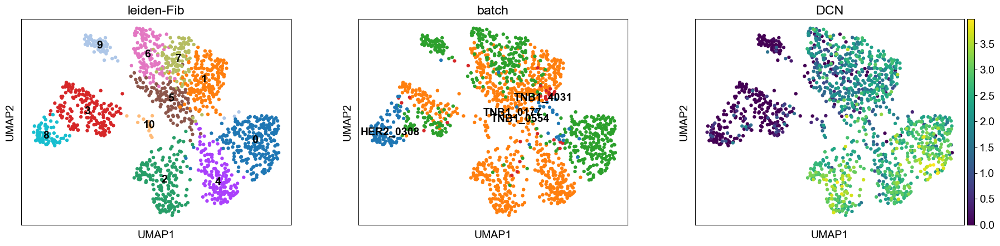

In [181]:
sc.pl.umap(adata_YBC_exter_Fib, color=['leiden-Fib', 'batch', 'DCN'], legend_loc='on data')

In [182]:
adata_YBC_exter_Fib = adata_YBC_exter_Fib[adata_YBC_exter_Fib.obs['leiden-Fib'].isin(['0', '1', '2', '4', '5', '6', '7', '10'])]
adata_YBC_exter_Fib

View of AnnData object with n_obs × n_vars = 1135 × 23936
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-major', 'major-type', 'leiden-Fib', 'groups'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dea_leiden-major', 'dendrogram_leiden-major', 'hvg', 'leiden-major', 'leiden-major_colors', 'log1p', 'major-type_colors', 'neighbors', 'pca', 'scrublet', 'umap', 'leiden', 'leiden-Fib_colors', 'batch_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [175]:
adata_OBC_exter_Fib = adata_OBC_exter_Fib[adata_OBC_exter_Fib.obs['annotation'].isin(['Fibroblast'])]
adata_OBC_exter_Fib

View of AnnData object with n_obs × n_vars = 3535 × 21864
    obs: 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'batch', 'mt_frac', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocytes', 'UCell_Myeloid-derived suppressor cells', 'UCell_NK cells', 'UCell_Natural killer T cells', 'UCell_Neutrophils', 'UCell_Nuocytes', 'UCell_Plasma cells', 'UCell_Plasmacytoid dendritic cells', 'UCell_Platelets', 'UCell_Red pulp macrophages', 'UCell_Reticulocytes', 'UCell_T cells', 'UCell_T cytotoxic cells', 'UCell_T follicular helper cells', 'UCell_T helper cells', 'UCell_T memory cells

In [184]:
adata1 = adata_YBC_native_Fib
adata3 = adata_YBC_exter_Fib
adata4 = adata_OBC_exter_Fib
adata_Fib = adata1.concatenate([adata3, adata4], batch_key='attr', batch_categories=['YBC_native','YBC_exter', 'OBC_exter']) #  
adata_Fib

/tmp/ipykernel_3871064/447741722.py:4: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_Fib = adata1.concatenate([adata3, adata4], batch_key='attr', batch_categories=['YBC_native','YBC_exter', 'OBC_exter']) #
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn

AnnData object with n_obs × n_vars = 34122 × 17134
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'leiden-Fib', 'Fib-type', 'anno-Fib', 'tech', 'sample', 'groups', 'IHC', 'leiden-major', 'major-type', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocytes', 'UCell_Myeloid-derived su

Ignoring processing doublet cells...
Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


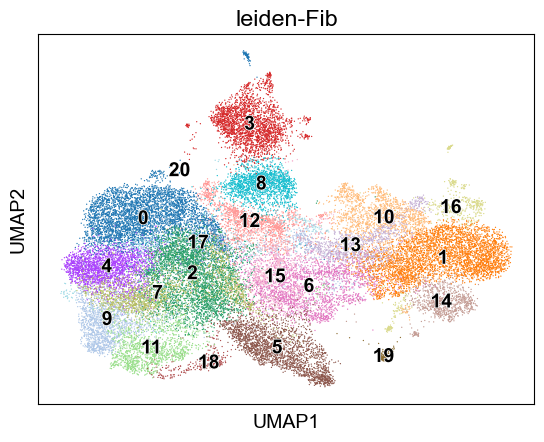

In [ ]:
adata_Fib = clu(adata_Fib, 'leiden-Fib', rep='X_pca', do_har=False, resolution=2)

In [187]:
sc.tl.leiden(adata_Fib,resolution=2, key_added='leiden-Fib')

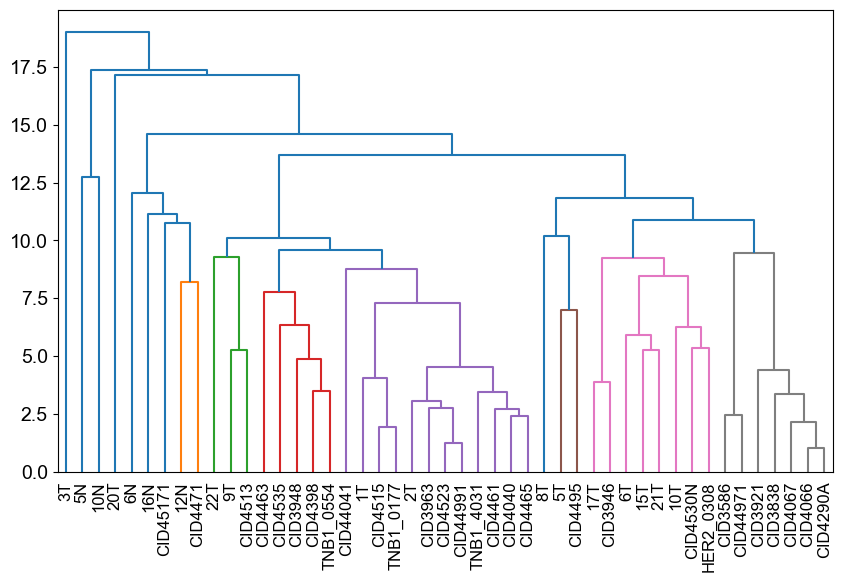

In [188]:
adata_Fib = get_batch_groups(adata_Fib, 'batch', 'leiden-Fib', 'groups')

Ignoring processing doublet cells...


2025-04-22 14:13:57,561 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-22 14:14:10,506 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-22 14:14:10,709 - harmonypy - INFO - Iteration 1 of 20
2025-04-22 14:14:22,922 - harmonypy - INFO - Iteration 2 of 20
2025-04-22 14:14:34,830 - harmonypy - INFO - Converged after 2 iterations


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


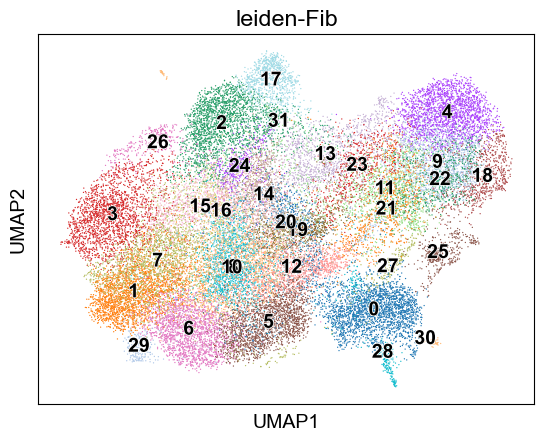

In [190]:
adata_Fib = clu(adata_Fib, 'leiden-Fib', do_har=True, resolution=2, har_key='groups')

In [195]:
sc.tl.leiden(adata_Fib, resolution=1, key_added='leiden-Fib1')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


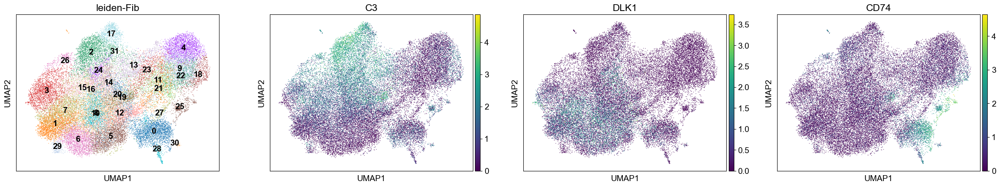

In [197]:
sc.pl.umap(adata_Fib, color=['leiden-Fib', 'C3', 'DLK1', 'CD74'], legend_loc='on data')

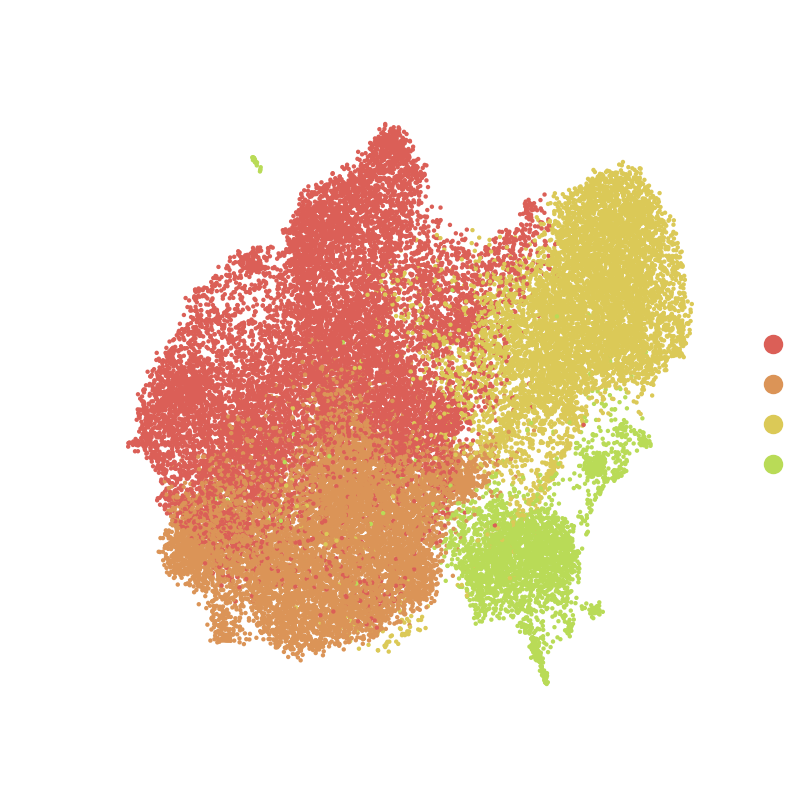

In [686]:
annot = {
  'C1_iCAF1_C3': ['17', '2', '31', '26', '24', '3', '7', '15', '16', '14', '13', '20', '19'],
  'C2_iCAF2_DLK1': ['1', '6', '5', '8', '10', '12', '29'],
  'C3_mCAF_LRRC15': ['4', '9', '18', '22', '23', '11', '21', '27'],
  'C4_aCAF_CD74': ['0', '28','30', '25'],
}
adata_Fib = anno(adata_Fib, annot, 'anno-Fib', 'leiden-Fib')
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_Fib, color=['anno-Fib'], palette=palette,size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_Fib_all.png', dpi=400, bbox_inches='tight')

In [200]:
annot = {
  'Young': ['YBC_native', 'YBC_exter'],
  'Non-young': ['OBC_exter']
}
adata_Fib = anno(adata_Fib, annot, 'age', 'attr')

In [204]:
adata_Fib.obs_names_make_unique()

In [205]:
conDict = {
  'left': ['Young',],
  'right': ['Non-young']
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_Fib, conDict, 'TorN', 'age')
adata_no_knn.obs = adata_no_knn.obs[['batch', 'anno-Fib', 'age', 'TorN']]
adata_no_knn

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_3871064/749089994.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


AnnData object with n_obs × n_vars = 34122 × 17134
    obs: 'batch', 'anno-Fib', 'age', 'TorN'
    var: 'n_cells-OBC_exter', 'highly_variable-OBC_exter', 'means-OBC_exter', 'dispersions-OBC_exter', 'dispersions_norm-OBC_exter', 'type-OBC_exter', 'n_cells_by_counts-YBC_exter', 'mean_counts-YBC_exter', 'log1p_mean_counts-YBC_exter', 'pct_dropout_by_counts-YBC_exter', 'total_counts-YBC_exter', 'log1p_total_counts-YBC_exter', 'n_cells-YBC_exter', 'highly_variable-YBC_exter', 'means-YBC_exter', 'dispersions-YBC_exter', 'dispersions_norm-YBC_exter', 'ID-YBC_exter', 'name-YBC_exter', 'type-YBC_exter', 'n_cells_by_counts-YBC_native', 'mean_counts-YBC_native', 'log1p_mean_counts-YBC_native', 'pct_dropout_by_counts-YBC_native', 'total_counts-YBC_native', 'log1p_total_counts-YBC_native', 'n_cells-YBC_native', 'highly_variable-YBC_native', 'means-YBC_native', 'dispersions-YBC_native', 'dispersions_norm-YBC_native', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'pca'

In [206]:
%%R -i adata_no_knn
library(miloR)
library(igraph)
library(ggplot2)
library(ggbeeswarm)
library(colorspace)
milo <- Milo(adata_no_knn)

In [207]:
%%R -i knn_adjacency
milo_graph <- buildFromAdjacency(knn_adjacency, k=20, is.binary=TRUE)
graph(milo) <- miloR::graph(milo_graph)

milo <- buildGraph(milo, k=20, d=30)

## Define neighbourhoods
milo <- makeNhoods(milo, prop = 0.1, k = 20, d=30, refined = TRUE)
## Count cells in neighbourhoods
milo <- countCells(milo, meta.data = data.frame(colData(milo)), sample="batch")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
milo <- calcNhoodDistance(milo, d=30)

Constructing kNN graph with k:20
Checking valid object
Running refined sampling with reduced_dim
Checking meta.data validity
Counting cells in neighbourhoods
In addition: Warning messages:
1: In (function (to_check, X, clust_centers, clust_info, dtype, nn,  :
  detected tied distances to neighbors, see ?'BiocNeighbors-ties'
2: In (function (to_check, X, clust_centers, clust_info, dtype, nn,  :
  detected tied distances to neighbors, see ?'BiocNeighbors-ties'
3: In (function (to_check, X, clust_centers, clust_info, dtype, nn,  :
  detected tied distances to neighbors, see ?'BiocNeighbors-ties'


In [208]:
%%R -i design_df -o DA_results

## Test for differential abundance
DA_results <- testNhoods(milo, design = ~ TorN, design.df = design_df)

## Annotate differential abundance
milo <- buildNhoodGraph(milo)
DA_results <- annotateNhoods(milo, DA_results, coldata_col = "anno.Fib")

Using TMM normalisation
Performing spatial FDR correction withk-distance weighting
In addition: Warning messages:
1: In testNhoods(milo, design = ~TorN, design.df = design_df) :
  Sample names in design matrix and nhood counts are not matched. Reordering
2: In max(abs(logR)) : no non-missing arguments to max; returning -Inf
3: In max(abs(logR)) : no non-missing arguments to max; returning -Inf
4: In max(abs(logR)) : no non-missing arguments to max; returning -Inf
5: In max(abs(logR)) : no non-missing arguments to max; returning -Inf
6: In max(abs(logR)) : no non-missing arguments to max; returning -Inf


In [209]:
%%R 
DA_results <- DA_results[order(DA_results[['anno.Fib']], decreasing=T), ]
p <- ggplot(DA_results, aes(x = logFC, y = anno.Fib)) +
  geom_quasirandom(data=DA_results[DA_results$FDR > 0.1,], alpha=0.5, colour='grey50', size=1) + 
  geom_quasirandom(data=DA_results[DA_results$FDR <= 0.1,], aes(colour=logFC, alpha=abs(logFC)), size=1.5) + 
  geom_violin(color = "#44403f", alpha=0) +
  theme_bw() +
  scale_colour_gradient2(low=darken('blue'), mid='grey80', high=darken('#ff0000'), midpoint=0) +
  labs(x="Log Fold Change", y=" subtypes") +
  theme(axis.text.y=element_text(size=12,colour='black'), axis.title.y=element_text(size=14),
        axis.text.x=element_text(size=12,colour='black'), axis.title.x=element_text(size=14),
        panel.grid.major = element_blank(), 
        panel.grid.minor = element_blank()) +
  stat_summary(aes(label = sprintf("%.2f",..x..)),
        fun = mean, geom = "text") +
  guides(colour=FALSE, alpha=FALSE)
ggsave("~/figure-1.23/DA_Fib_Young.pdf", p, width = 4.5, height = 2, units = "in")

Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`
Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`


In [ ]:
mCAF_degs = DE_memento_1d(adata_Fib[adata_Fib.obs['anno-Fib'].isin(['C3_mCAF_LRRC15'])], ctleft=['Young'], ctright=['Non-young'], groupby='age')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.


In [ ]:
iCAF2_degs = DE_memento_1d(adata_Fib[adata_Fib.obs['anno-Fib'].isin(['C2_iCAF2_DLK1'])], ctleft=['Young'], ctright=['Non-young'], groupby='age')

In [218]:
iCAF1_degs = DE_memento_1d(adata_Fib[adata_Fib.obs['anno-Fib'].isin(['C1_iCAF1_C3'])], ctleft=['Young'], ctright=['Non-young'], groupby='age')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    5.2s
[Parallel(n_jobs=16)]: Done  63 out of  63 | elapsed:   22.9s finished


In [220]:
CAF_degs = DE_memento_1d(adata_Fib, ctleft=['Young'], ctright=['Non-young'], groupby='age')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requi

In [215]:
%%R -i mCAF_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(mCAF_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_mCAF_Age.pdf", p, width = 3, height = 3, units = "in")

In [225]:
%%R -i iCAF2_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(iCAF2_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_iCAF2_Age.pdf", p, width = 3, height = 3, units = "in")

In [224]:
%%R -i iCAF1_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(iCAF1_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_iCAF1_Age.pdf", p, width = 3, height = 3, units = "in")

In [222]:
%%R -i CAF_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(CAF_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_CAF_Age.pdf", p, width = 3, height = 3, units = "in")

In [226]:
%%R
library(monocle)
library(monocle3)

Loading required package: VGAM
Loading required package: splines
Loading required package: DDRTree
Loading required package: irlba

Attaching package: ‘monocle3’

The following objects are masked from ‘package:monocle’:

    plot_genes_in_pseudotime, plot_genes_violin,
    plot_pc_variance_explained

The following object is masked from ‘package:igraph’:

    clusters

The following objects are masked from ‘package:Biobase’:

    exprs, fData, fData<-, pData, pData<-



In [228]:
from scipy.sparse import csr_matrix
adata_YBC_native_Fib_raw = ad.AnnData(X=csr_matrix(adata_YBC_native_Fib.X), 
              obs=adata_YBC_native_Fib.obs[['batch','anno-Fib']], 
              var=adata_YBC_native_Fib.var,
              obsm=adata_YBC_native_Fib.obsm)
adata_YBC_native_Fib_raw

AnnData object with n_obs × n_vars = 29452 × 41733
    obs: 'batch', 'anno-Fib'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'

In [229]:
%%R -i adata_YBC_native_Fib
sce <- adata_YBC_native_Fib

gene_metadata <- as.data.frame(rownames(sce))
rownames(gene_metadata) <- rownames(sce)
colnames(gene_metadata) <- c("gene_short_name")
gene_metadata

cds <- new_cell_data_set(expression_data = sce@assays@data$X, 
                         cell_metadata = as.data.frame(sce@colData),
                         gene_metadata = gene_metadata)

reducedDim(cds, "UMAP") <- reducedDim(sce, "UMAP")

/usr/lib/python3.10/functools.py:889: NotConvertedWarning: Conversion 'py2rpy' not defined for objects of type '<class 'NoneType'>'


  |======================================================================| 100%


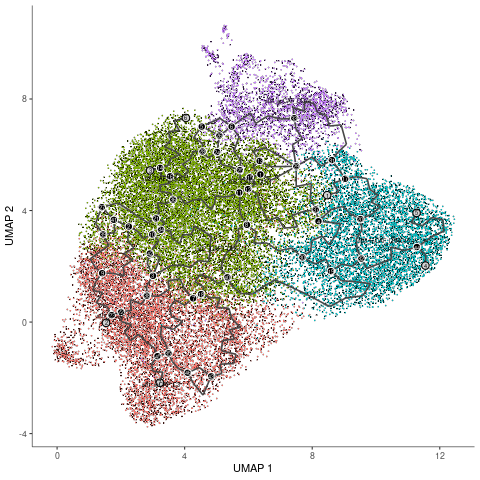

In [230]:
%%R
cds <- cluster_cells(cds)
cds <- learn_graph(cds)
plot_cells(cds, color_cells_by="anno.Fib")

In [231]:
%%R
pdf("figure-1.23/Fib-monocle3-anno.pdf", width = 8, height = 6)

# 绘制图形
p <- plot_cells(cds, 
                color_cells_by = "anno.Fib", 
                reduction_method = "UMAP",
                label_principal_points = TRUE)
print(p)

# 关闭 PDF 设备
dev.off()

png 
  2 


In [252]:
%%R
pdf("figure-1.23/Fib-monocle3-pseudotime1.pdf", width = 6, height = 5)
cds <- order_cells(cds, root_pr_nodes = "Y_262")
p <- plot_cells(
  cds,
  color_cells_by = "pseudotime",
  label_groups_by_cluster = FALSE,
  label_leaves = FALSE,
  label_branch_points = FALSE,
  graph_label_size = 3
)
print(p)
dev.off()

png 
  2 


Cells aren't colored in a way that allows them to be grouped.


In [ ]:
%%R
pdf("figure-1.23/Fib-monocle3-markers.pdf", width = 7.5, height = 3)
Track_genes_sig <- c("COL14A1", 'COL15A1', 'FAP', 'HLA-DRA')
p <- plot_genes_in_pseudotime(cds[Track_genes_sig,], color_cells_by="anno.Fib", 
                              min_expr=0.4, 
                              ncol = 2,
                              vertical_jitter=0.18, 
                              horizontal_jitter=1, 
                              cell_size = 0.1) + 
      scale_color_manual(values=c("#d15c54", '#d39157', '#d3c358', '#b2d259'))
print(p)
dev.off()

png 
  2 


In [ ]:
%%R
?plot_genes_in_pseudotime

Help on topic ‘plot_genes_in_pseudotime’ was found in the following
packages:

  Package               Library
  monocle               /home/rzh/R/x86_64-pc-linux-gnu-library/4.3
  monocle3              /home/rzh/R/x86_64-pc-linux-gnu-library/4.3

Choose one 

1: Plots expression for one or more genes as a function of pseudotime {monocle}
2: Plots expression for one or more genes as a function of pseudotime {monocle3}

File: /tmp/RtmpQyYcVF/Rtxt3b11585cd67283
plot_genes_in_pseudotime        package:monocle        R Documentation



Plots expression for one or more genes as a function of pseudotime



Description:



     Plots expression for one or more genes as a function of

     pseudotime. Plotting allows you determine if the ordering produced

     by orderCells() is correct and it does not need to be flipped

     using the "reverse" flag in orderCells



Usage:



     plot_genes_in_pseudotime(

       cds_subset,

       min_expr = NULL,

       cell_size = 0.75,

       nrow =

In [238]:
%%R
pdf("figure-1.23/Fib-monocle3-anno.pdf", width = 6, height = 5)

# 绘制图形
p <- plot_cells(cds, 
                color_cells_by = "anno.Fib", 
                reduction_method = "UMAP",
                label_principal_points = TRUE)
print(p)

# 关闭 PDF 设备
dev.off()

png 
  2 


In [ ]:
adata_stromal = sc.read_h5ad(f"{datapath}/adata-YBC-native-Stromal-4.22.h5ad")

In [ ]:
adata_stromal = clu(adata_stromal, key_added='leiden-stromal', do_har=True)

Ignoring processing doublet cells...


2025-04-23 09:05:53,671 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-23 09:06:12,357 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-23 09:06:12,618 - harmonypy - INFO - Iteration 1 of 20
2025-04-23 09:06:31,611 - harmonypy - INFO - Iteration 2 of 20
2025-04-23 09:06:49,542 - harmonypy - INFO - Iteration 3 of 20
2025-04-23 09:07:07,073 - harmonypy - INFO - Iteration 4 of 20
2025-04-23 09:07:25,986 - harmonypy - INFO - Iteration 5 of 20
2025-04-23 09:07:43,222 - harmonypy - INFO - Iteration 6 of 20
2025-04-23 09:07:52,213 - harmonypy - INFO - Iteration 7 of 20
2025-04-23 09:08:01,523 - harmonypy - INFO - Iteration 8 of 20
2025-04-23 09:08:14,805 - harmonypy - INFO - Iteration 9 of 20
2025-04-23 09:08:27,270 - harmonypy - INFO - Iteration 10 of 20
2025-04-23 09:08:37,814 - harmonypy - INFO - Iteration 11 of 20
2025-04-23 09:08:46,914 - harmonypy - INFO - Iteration 12 of 20
2025-04-23 09:08:55,849 - harmonypy - INFO - Iteration 13 of

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


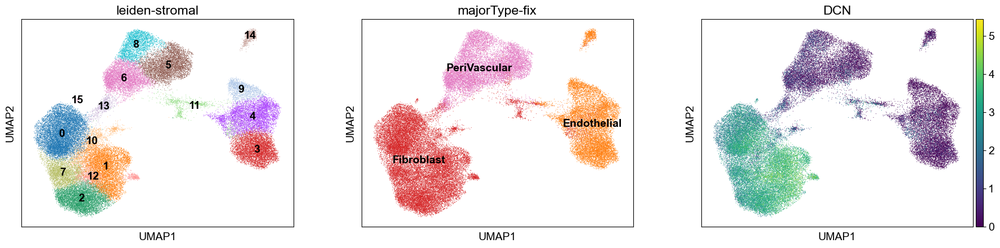

In [247]:
sc.pl.umap(adata_stromal, color=['leiden-stromal', 'majorType-fix', 'DCN'], legend_loc='on data')

In [249]:
adata_stromal.obs['anno-stromal'] = adata_stromal.obs['majorType-fix']

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


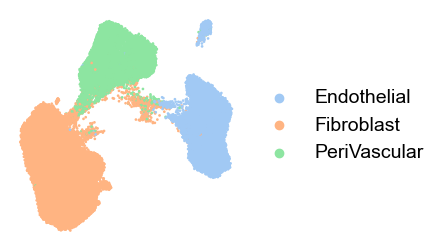

In [251]:
fig, ax = plt.subplots(1, 1, figsize=(3, 3))
palette = sns.color_palette("pastel", 3)
sc.pl.umap(adata_stromal, color=['anno-stromal'], palette=palette,size=15,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_stromal.png', dpi=400, bbox_inches='tight')

In [268]:
adata_PVL = adata_stromal[adata_stromal.obs['anno-stromal'] == 'PeriVascular']
adata_PVL

View of AnnData object with n_obs × n_vars = 12342 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'IHC', 'leiden-stromal', 'anno-stromal'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'CellphoneDB', 'batch_colors', 'dendrogram_leiden', 'epi-subtype_colors', 'gender_colors', 'hvg', 'leiden', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'majorType-fix_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'min

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}


Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


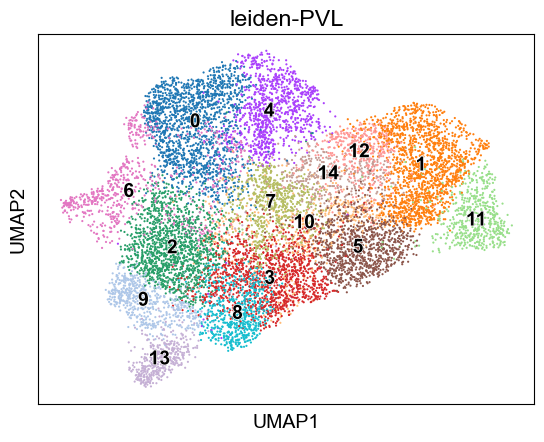

In [269]:
adata_PVL = clu(adata_PVL, key_added='leiden-PVL', do_har=False, rep='X_pca', resolution=1)

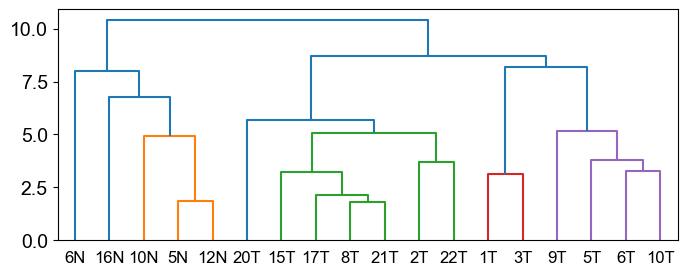

In [271]:
adata_PVL = get_batch_groups(adata_PVL, groupby='batch', clusters='leiden-PVL', key_added='groups')

Ignoring processing doublet cells...


2025-05-10 10:19:51,100 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-10 10:19:57,353 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-10 10:19:57,407 - harmonypy - INFO - Iteration 1 of 20
2025-05-10 10:19:59,881 - harmonypy - INFO - Iteration 2 of 20
2025-05-10 10:20:02,379 - harmonypy - INFO - Iteration 3 of 20
2025-05-10 10:20:04,941 - harmonypy - INFO - Converged after 3 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


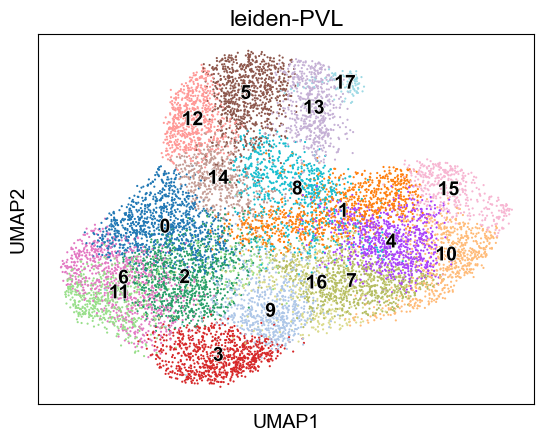

In [300]:
adata_PVL = clu(adata_PVL, key_added='leiden-PVL', do_har=True, har_key='groups', resolution=2)

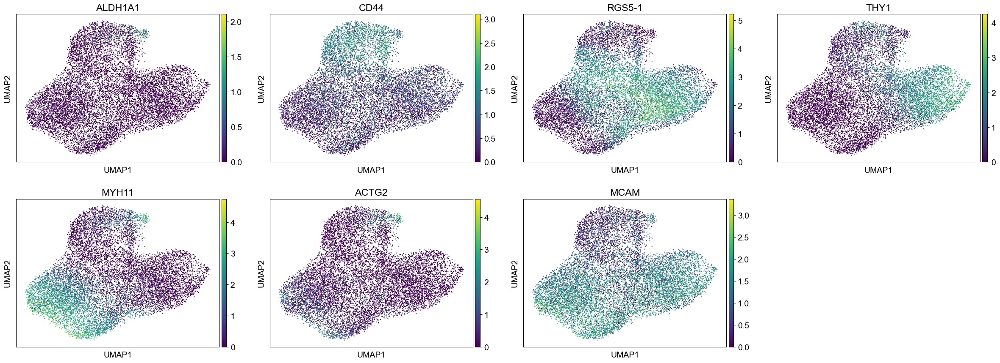

In [327]:
sc.pl.umap(adata_PVL, color=['ALDH1A1', 'CD44', 'RGS5-1', 'THY1', 'MYH11', 'ACTG2', 'MCAM'])

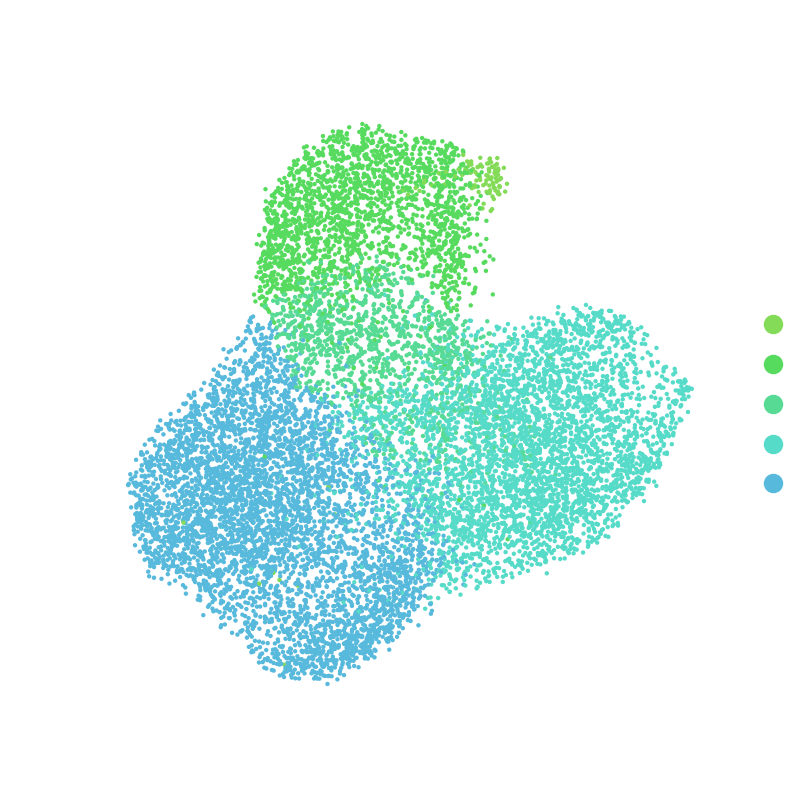

In [351]:
annot = {
  's05_Peri1_ALDH1A1': ['17'],
  's06_Peri2_CD44': ['5', '12', '13'],
  's07_Peri3_CD36': ['14', '8'],
  's08_Peri4_THY1': ['1', '4', '7', '10', '15', '16'],
  's09_VSMC_MYH11':['0', '2', '3', '6', '9', '11']
}
adata_PVL = anno(adata_PVL, annot, 'anno-PVL', 'leiden-PVL')
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
palette = sns.color_palette("hls", 15)
sc.pl.umap(adata_PVL, color=['anno-PVL'], palette=palette[4:],size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_PVL.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


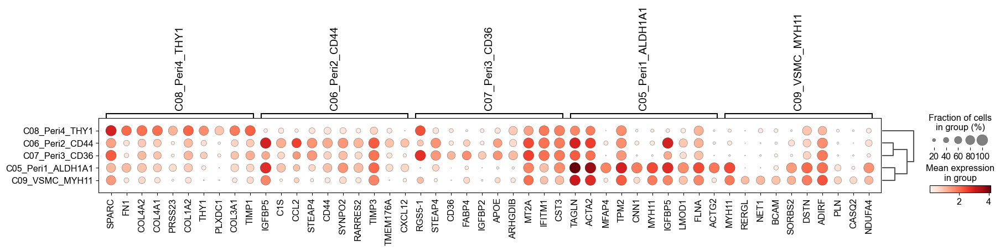

In [307]:
sc.tl.rank_genes_groups(adata_PVL, groupby='anno-PVL')
sc.tl.dendrogram(adata_PVL, groupby='anno-PVL')
sc.pl.rank_genes_groups_dotplot(adata_PVL, n_genes=10)

In [308]:
adata_Endo = adata_stromal[adata_stromal.obs['anno-stromal'] == 'Endothelial']
adata_Endo

View of AnnData object with n_obs × n_vars = 12647 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'IHC', 'leiden-stromal', 'anno-stromal'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'CellphoneDB', 'batch_colors', 'dendrogram_leiden', 'epi-subtype_colors', 'gender_colors', 'hvg', 'leiden', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'majorType-fix_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'min

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}


Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


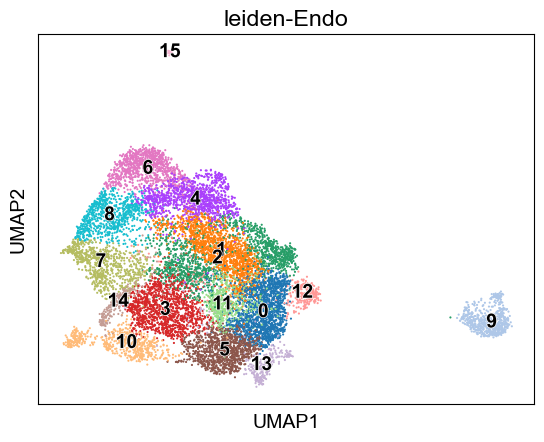

In [309]:
adata_Endo = clu(adata_Endo, key_added='leiden-Endo', do_har=False, rep='X_pca', resolution=1)

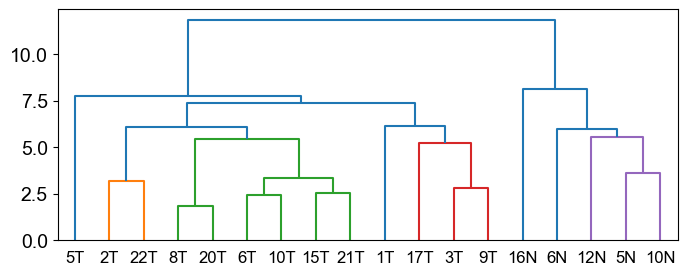

In [311]:
adata_Endo = get_batch_groups(adata_Endo, groupby='batch', clusters='leiden-Endo', key_added='groups')

Ignoring processing doublet cells...


2025-05-10 10:40:17,626 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-05-10 10:40:23,959 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-10 10:40:24,027 - harmonypy - INFO - Iteration 1 of 20
2025-05-10 10:40:26,797 - harmonypy - INFO - Iteration 2 of 20
2025-05-10 10:40:29,578 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


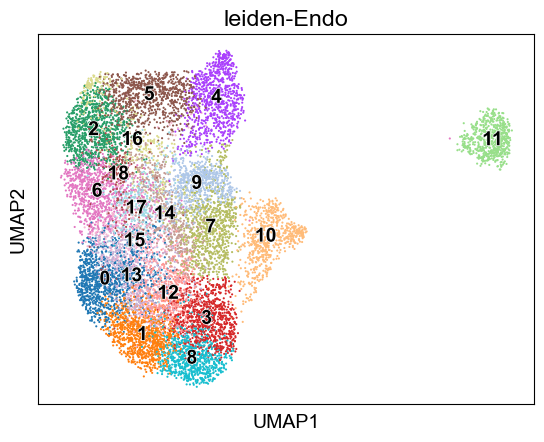

In [312]:
adata_Endo = clu(adata_Endo, key_added='leiden-Endo', do_har=True, har_key='groups', resolution=2)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


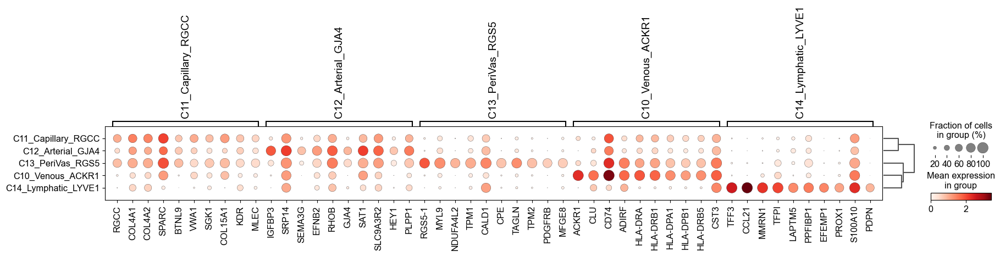

In [390]:
sc.tl.rank_genes_groups(adata_Endo, groupby='anno-Endo')
sc.tl.dendrogram(adata_Endo, groupby='anno-Endo')
sc.pl.rank_genes_groups_dotplot(adata_Endo, n_genes=10)

In [346]:
temp_fibnames = adata_YBC_native_Fib.obs_names
adata_YBC_native_Fib.obs_names = [f"{s.split('-')[0]}-{s.split('-')[2]}" for s in adata_YBC_native_Fib.obs_names]

In [347]:
stromal_sub = pd.concat([adata_YBC_native_Fib.obs['anno-Fib'],
                         adata_PVL.obs['anno-PVL'],
                         adata_Endo.obs['anno-Endo']])
stromal_sub

AAACCCATCGGAATTC-1T           s01_stCAF_C3
AAACGAATCCATAGAC-1T          s02_iCAF_DLK1
AAAGAACAGACGACGT-1T          s02_iCAF_DLK1
AAATGGAAGTCGCTAT-1T        s03_mCAF_LRRC15
AAATGGATCAAGGTGG-1T          s02_iCAF_DLK1
                               ...        
GACGGCTCATAGACTC-22T    s11_Capillary_RGCC
GCAAACTGTGGACGAT-22T    s11_Capillary_RGCC
GCGCGATAGCGATAGC-22T    s11_Capillary_RGCC
GTATCTTCACGTCAGC-22T    s11_Capillary_RGCC
TCACAAGAGGCTAGAC-22T    s11_Capillary_RGCC
Length: 54441, dtype: object

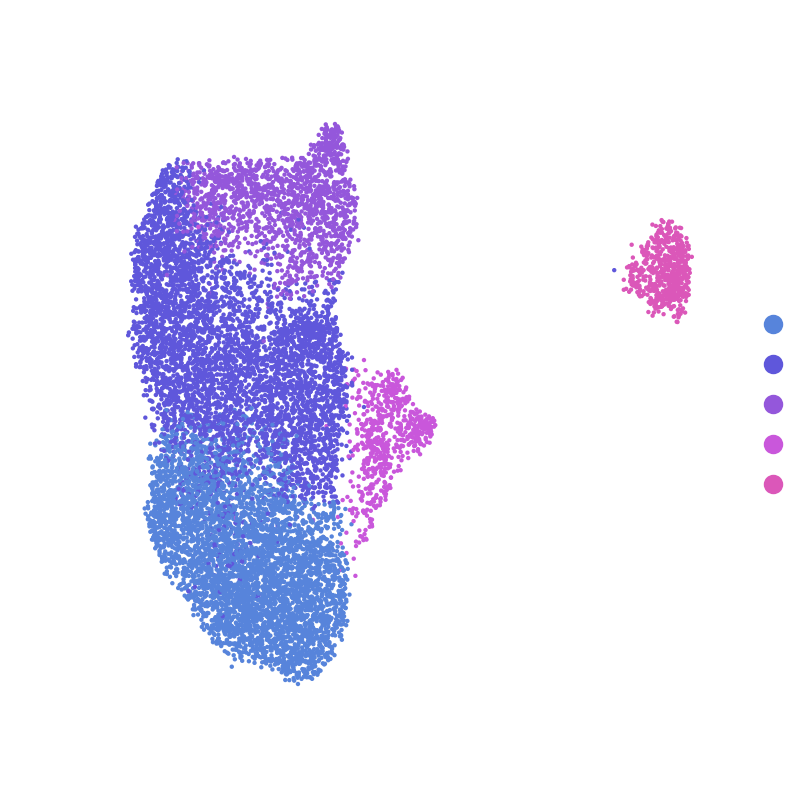

In [349]:
annot = {
  's10_Venous_ACKR1': ['0', '1', '3', '8', '12', '13'],
  's11_Capillary_RGCC': ['2', '6', '7', '9', '14', '15', '16', '17', '18'],
  's12_Arterial_GJA4': ['4', '5'],
  's13_PeriVas_RGS5': ['10'],
  's14_Lymphatic_LYVE1':['11']
}
adata_Endo = anno(adata_Endo, annot, 'anno-Endo', 'leiden-Endo')
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
palette = sns.color_palette("hls", 15)
sc.pl.umap(adata_Endo, color=['anno-Endo'], palette=palette[9:],size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_Endo.png', dpi=400, bbox_inches='tight')

In [ ]:
adata_stromal.obs['anno-subStromal1'] = stromal_sub

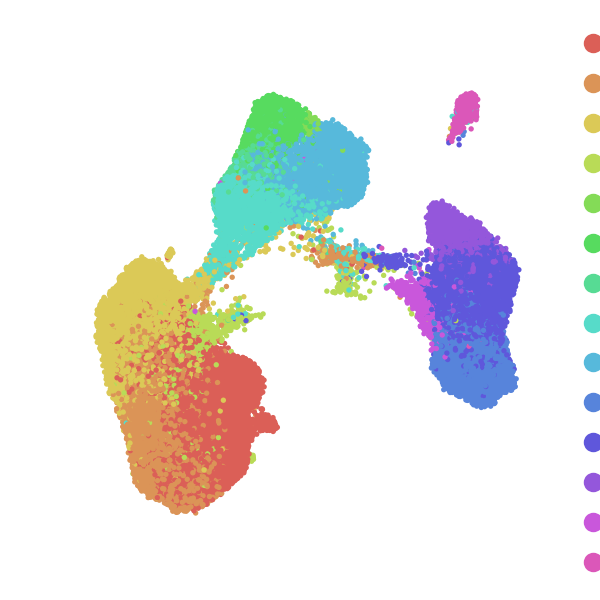

In [354]:
fig, ax = plt.subplots(1, 1, figsize=(3, 3))
sc.pl.umap(adata_stromal, color=['anno-subStromal1'], palette=palette,size=15,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_stromal.png', dpi=400, bbox_inches='tight')

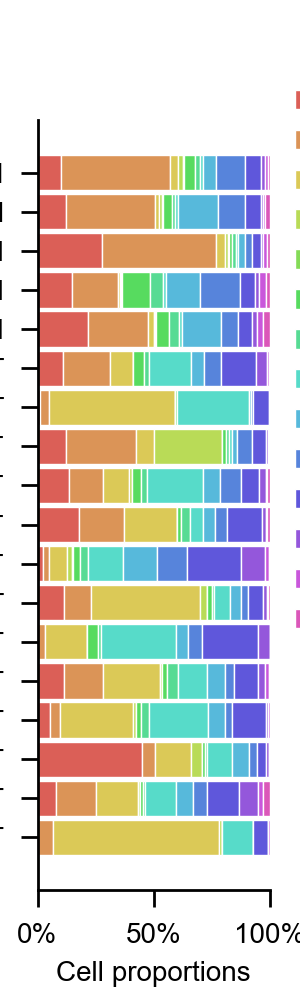

In [ ]:
barlabels = ['5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T']
barlabels.reverse()
cell_types = list(adata_stromal.obs['anno-subStromal1'].unique())
cell_types.sort()
colors = sns.color_palette("hls", 15)
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_stromal.obs["anno-subStromal1"] == ct) & (adata_stromal.obs["batch"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors= colors)
fig0.savefig(f"{figPath}/Stromal_attr_proportions.svg",bbox_inches='tight')

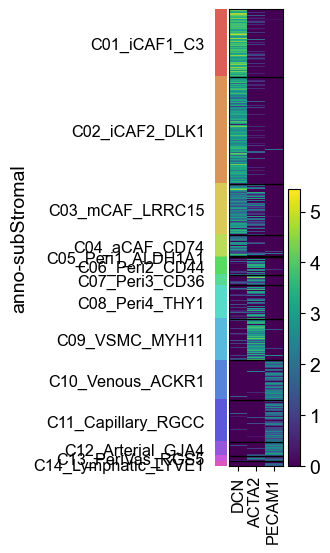

In [371]:
sc.pl.heatmap(adata_stromal, var_names=['DCN', 'ACTA2', 'PECAM1'], groupby='anno-subStromal', save='stromal.svg')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


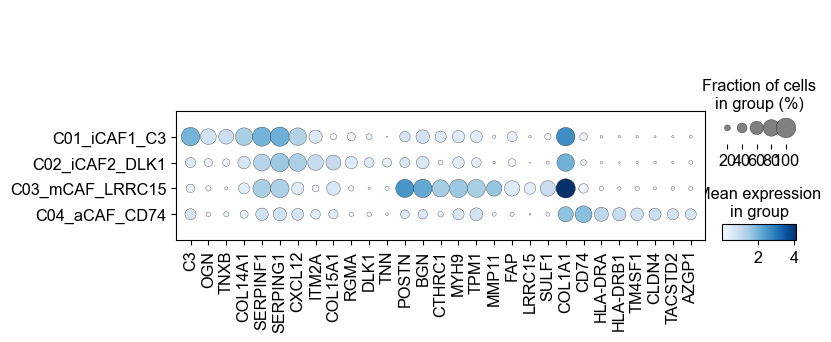

In [394]:
fig, ax = plt.subplots(1,1, figsize=(8,3))
sc.pl.dotplot(adata_YBC_native_Fib, cmap='Blues', groupby='anno-Fib',var_names=[
  'C3', 'OGN', 'TNXB', 'COL14A1','SERPINF1', 'SERPING1', 'CXCL12', 
  'ITM2A', 'COL15A1', 'RGMA', 'DLK1','TNN', 
  'POSTN', 'BGN', 'CTHRC1', 'MYH9', 'TPM1', 'MMP11', 'FAP', 'LRRC15', 'SULF1','COL1A1',
  'CD74', 'HLA-DRA', 'HLA-DRB1', 'TM4SF1', 'CLDN4', 'TACSTD2', 'AZGP1',
], ax=ax,)
fig.savefig(f"{figPath}/Heatmap-Fib.svg", bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


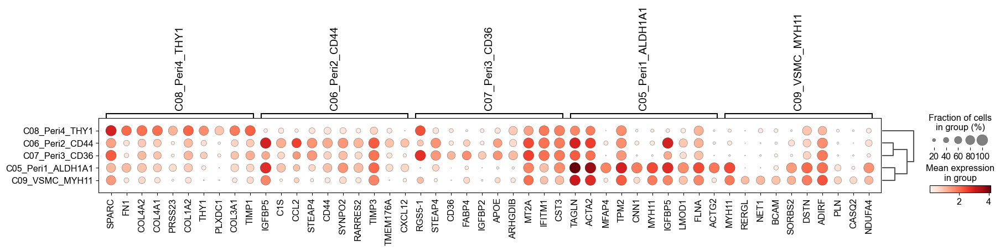

In [383]:
sc.pl.rank_genes_groups_dotplot(adata_PVL, n_genes=10)

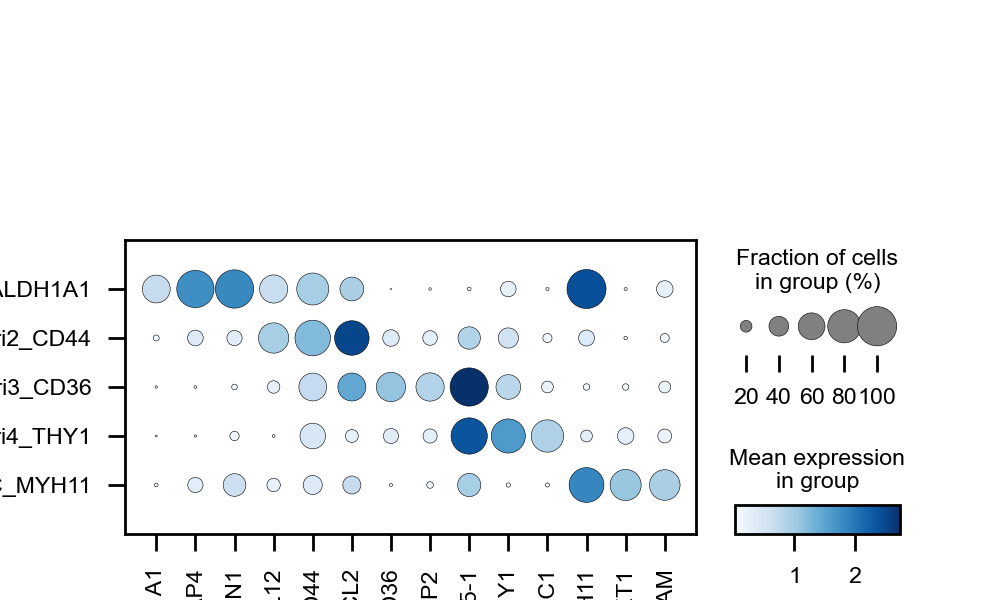

In [397]:
fig, ax = plt.subplots(1,1, figsize=(5,3))
sc.pl.dotplot(adata_PVL, cmap='Blues', groupby='anno-PVL',var_names=[
  'ALDH1A1', 'MFAP4', 'CNN1','CXCL12',  'CD44', 
  'CCL2', 'CD36', 'IGFBP2', 'RGS5-1', 'THY1', 'PLXDC1', 
  "MYH11", 'NET1', 'BCAM'
], ax=ax,)
fig.savefig(f"{figPath}/Heatmap-PVL.svg", bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


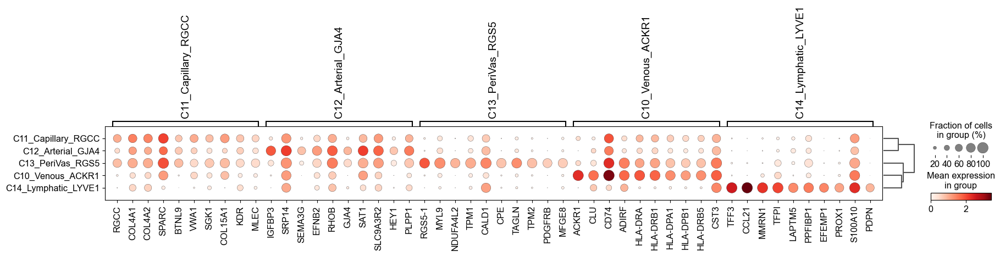

In [391]:
sc.pl.rank_genes_groups_dotplot(adata_Endo, n_genes=10)

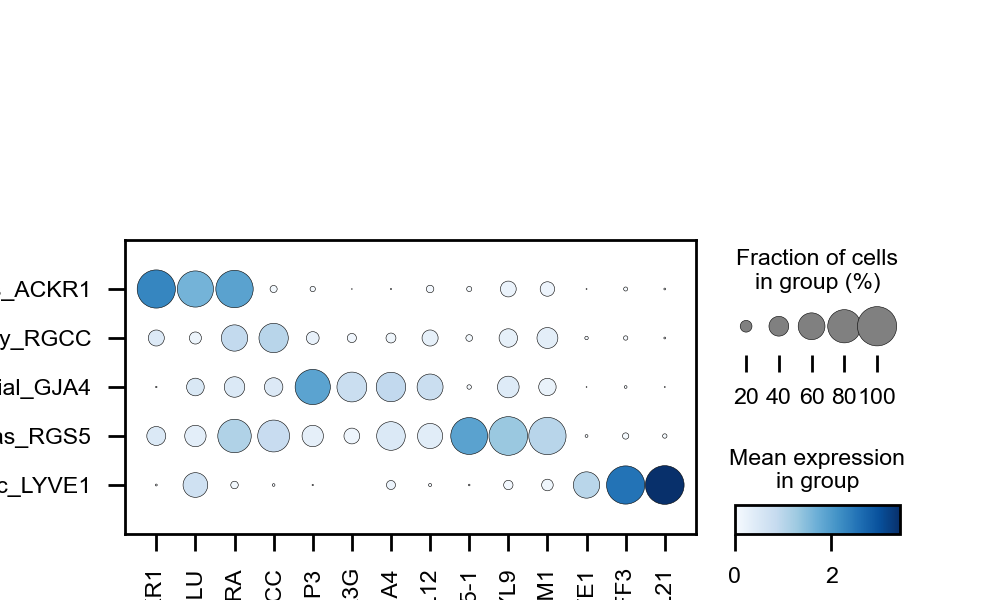

In [399]:
fig, ax = plt.subplots(1,1, figsize=(5,3))
sc.pl.dotplot(adata_Endo, cmap='Blues', groupby='anno-Endo',var_names=[
  'ACKR1', 'CLU', 'HLA-DRA','RGCC',   
  'IGFBP3','SEMA3G', 'GJA4', 'CXCL12', 'RGS5-1', 'MYL9', 'TPM1', 
  "LYVE1", 'TFF3', 'CCL21'
], ax=ax,)
fig.savefig(f"{figPath}/Heatmap-Endo.svg", bbox_inches='tight')

In [402]:
adata_Fib.obs['age']

AAACCCATCGGAATTC-1-1T-YBC_native                    Young
AAACGAATCCATAGAC-1-1T-YBC_native                    Young
AAAGAACAGACGACGT-1-1T-YBC_native                    Young
AAATGGAAGTCGCTAT-1-1T-YBC_native                    Young
AAATGGATCAAGGTGG-1-1T-YBC_native                    Young
                                                  ...    
CID4513_CACAAACGTCCCTTGT-CID4513-OBC_exter      Non-young
CID3946_CCTCACATCCCAATAG-CID3946-OBC_exter-1    Non-young
CID44991_CGGACTGAGTACATGA-CID44991-OBC_exter    Non-young
CID3838_TAGTGCACAGCTATTG-CID3838-OBC_exter-1    Non-young
CID4066_ATTTCTGTCTGCGGCA-CID4066-OBC_exter-1    Non-young
Name: age, Length: 34122, dtype: category
Categories (2, object): ['Non-young', 'Young']

In [403]:
conDict = {
  'left': ['Non-young',],
  'right': ['Young']
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_Fib, conDict, 'TorN', 'age')
adata_no_knn.obs = adata_no_knn.obs[['batch',  'anno-Fib', 'IHC', 'TorN']]
adata_no_knn

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_3871064/749089994.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


AnnData object with n_obs × n_vars = 34122 × 17134
    obs: 'batch', 'anno-Fib', 'IHC', 'TorN'
    var: 'n_cells-OBC_exter', 'highly_variable-OBC_exter', 'means-OBC_exter', 'dispersions-OBC_exter', 'dispersions_norm-OBC_exter', 'type-OBC_exter', 'n_cells_by_counts-YBC_exter', 'mean_counts-YBC_exter', 'log1p_mean_counts-YBC_exter', 'pct_dropout_by_counts-YBC_exter', 'total_counts-YBC_exter', 'log1p_total_counts-YBC_exter', 'n_cells-YBC_exter', 'highly_variable-YBC_exter', 'means-YBC_exter', 'dispersions-YBC_exter', 'dispersions_norm-YBC_exter', 'ID-YBC_exter', 'name-YBC_exter', 'type-YBC_exter', 'n_cells_by_counts-YBC_native', 'mean_counts-YBC_native', 'log1p_mean_counts-YBC_native', 'pct_dropout_by_counts-YBC_native', 'total_counts-YBC_native', 'log1p_total_counts-YBC_native', 'n_cells-YBC_native', 'highly_variable-YBC_native', 'means-YBC_native', 'dispersions-YBC_native', 'dispersions_norm-YBC_native', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'pca'

In [404]:
%%R -i adata_no_knn
library(miloR)
library(igraph)
library(ggplot2)
library(ggbeeswarm)
library(colorspace)
milo <- Milo(adata_no_knn)

In [405]:
%%R -i knn_adjacency
milo_graph <- buildFromAdjacency(knn_adjacency, k=20, is.binary=TRUE)
graph(milo) <- miloR::graph(milo_graph)

milo <- buildGraph(milo, k=20, d=30)

## Define neighbourhoods
milo <- makeNhoods(milo, prop = 0.1, k = 20, d=30, refined = TRUE)
## Count cells in neighbourhoods
milo <- countCells(milo, meta.data = data.frame(colData(milo)), sample="batch")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
milo <- calcNhoodDistance(milo, d=30)

Constructing kNN graph with k:20
Checking valid object
Running refined sampling with reduced_dim
Checking meta.data validity
Counting cells in neighbourhoods
In addition: Warning messages:
1: In (function (to_check, X, clust_centers, clust_info, dtype, nn,  :
  detected tied distances to neighbors, see ?'BiocNeighbors-ties'
2: In (function (to_check, X, clust_centers, clust_info, dtype, nn,  :
  detected tied distances to neighbors, see ?'BiocNeighbors-ties'
3: In (function (to_check, X, clust_centers, clust_info, dtype, nn,  :
  detected tied distances to neighbors, see ?'BiocNeighbors-ties'


In [406]:
%%R -i design_df -o DA_results

## Test for differential abundance
DA_results <- testNhoods(milo, design = ~ TorN, design.df = design_df)

## Annotate differential abundance
milo <- buildNhoodGraph(milo)
DA_results <- annotateNhoods(milo, DA_results, coldata_col = "anno.Fib")

Using TMM normalisation
Performing spatial FDR correction withk-distance weighting
In addition: Warning messages:
1: In testNhoods(milo, design = ~TorN, design.df = design_df) :
  Sample names in design matrix and nhood counts are not matched. Reordering
2: In max(abs(logR)) : no non-missing arguments to max; returning -Inf
3: In max(abs(logR)) : no non-missing arguments to max; returning -Inf


In [407]:
%%R 
DA_results <- DA_results[order(DA_results[['anno.Fib']], decreasing=T), ]
p <- ggplot(DA_results, aes(x = logFC, y = anno.Fib)) +
  geom_quasirandom(data=DA_results[DA_results$FDR > 0.1,], alpha=0.5, colour='grey50', size=1) + 
  geom_quasirandom(data=DA_results[DA_results$FDR <= 0.1,], aes(colour=logFC, alpha=abs(logFC)), size=1.5) + 
  geom_violin(color = "#44403f", alpha=0) +
  theme_bw() +
  scale_colour_gradient2(low=darken('blue'), mid='grey80', high=darken('#ff0000'), midpoint=0) +
  labs(x="Log Fold Change", y=" subtypes") +
  theme(axis.text.y=element_text(size=12,colour='black'), axis.title.y=element_text(size=14),
        axis.text.x=element_text(size=12,colour='black'), axis.title.x=element_text(size=14),
        panel.grid.major = element_blank(), 
        panel.grid.minor = element_blank()) +
  stat_summary(aes(label = sprintf("%.2f",..x..)),
        fun = mean, geom = "text") +
  guides(colour=FALSE, alpha=FALSE)
ggsave("~/figure-1.23/DA_Fib_Young.pdf", p, width = 4.5, height = 2, units = "in")

Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`
Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`


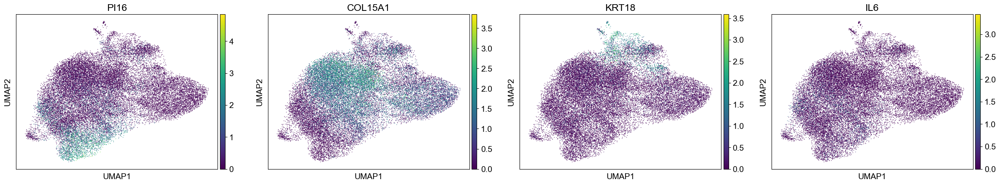

In [414]:
sc.pl.umap(adata_YBC_native_Fib, color=['PI16', 'COL15A1', 'KRT18', 'IL6'])

In [417]:
adata_PVL.write_h5ad("adata-YBC-native-PVL-5.12.h5ad")

In [ ]:
adata_epi_norm = sc.read_h5ad(f"{datapath}/adata-epi-norm-12.6.h5ad")

In [421]:
adata_epi_norm

AnnData object with n_obs × n_vars = 15756 × 39735
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'cnv_leiden', 'cnv_score', 'cnv_status', 'IHC', 'epi-leiden', 'epi-normtype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'symbol', 'ensg', 'chromosome', 'start', 'end'
    uns: 'CellphoneDB', 'IHC_colors', 'batch_colors', 'cnv', 'cnv_leiden_colors', 'cnv_neighbors', 'cnv_status_colors', 'dendrogram_epi-leiden', 'dendrogram_leiden', 'epi-leiden_colors', 'epi-normtype_colors', 'epi-subtype_colors', 'gender_colors', 

In [ ]:
%%R
library(monocle)
library(monocle3)

In [425]:
%%R -i adata_epi_norm
sce <- adata_epi_norm

gene_metadata <- as.data.frame(rownames(sce))
rownames(gene_metadata) <- rownames(sce)
colnames(gene_metadata) <- c("gene_short_name")
gene_metadata

cds <- new_cell_data_set(expression_data = sce@assays@data$X, 
                         cell_metadata = as.data.frame(sce@colData),
                         gene_metadata = gene_metadata)

reducedDim(cds, "UMAP") <- reducedDim(sce, "UMAP")

  |======================================================================| 100%


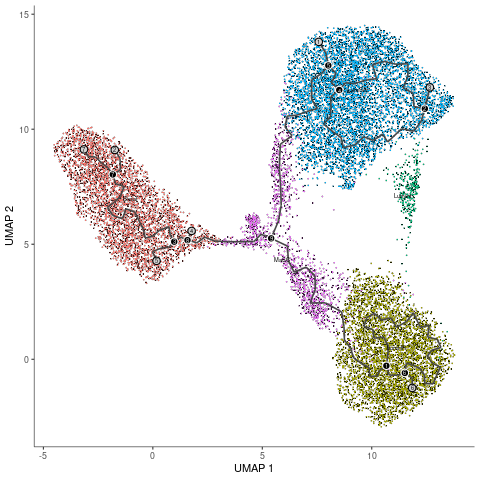

In [426]:
%%R
cds <- cluster_cells(cds)
cds <- learn_graph(cds)
plot_cells(cds, color_cells_by="epi.normtype")

In [427]:
%%R
pdf("figure-1.23/Epi-monocle3-anno.pdf", width = 8, height = 6)

# 绘制图形
p <- plot_cells(cds, 
                color_cells_by = "epi.normtype", 
                reduction_method = "UMAP",
                label_principal_points = TRUE)
print(p)

# 关闭 PDF 设备
dev.off()

png 
  2 


In [428]:
%%R
pdf("figure-1.23/Epi-monocle3-pseudotime.pdf", width = 6, height = 5)
cds <- order_cells(cds, root_pr_nodes = "Y_143")
p <- plot_cells(
  cds,
  color_cells_by = "pseudotime",
  label_groups_by_cluster = FALSE,
  label_leaves = FALSE,
  label_branch_points = FALSE,
  graph_label_size = 3
)
print(p)
dev.off()

png 
  2 


Cells aren't colored in a way that allows them to be grouped.


In [431]:
sc.tl.paga(adata_epi_norm, groups='epi-normtype')

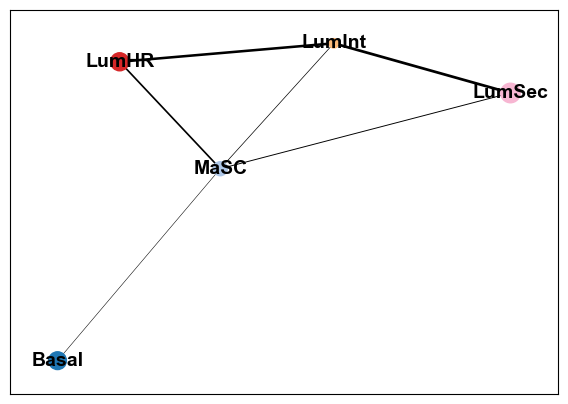

In [440]:
sc.pl.paga(adata_epi_norm, threshold=0.05)

In [ ]:
adata_CD8T = sc.read_h5ad(f"{datapath}/adata-CD8T.h5ad")

In [ ]:
adata_Mye = sc.read_h5ad(f"{datapath}/adata-YBC-native-Mye-4.9.h5ad")

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


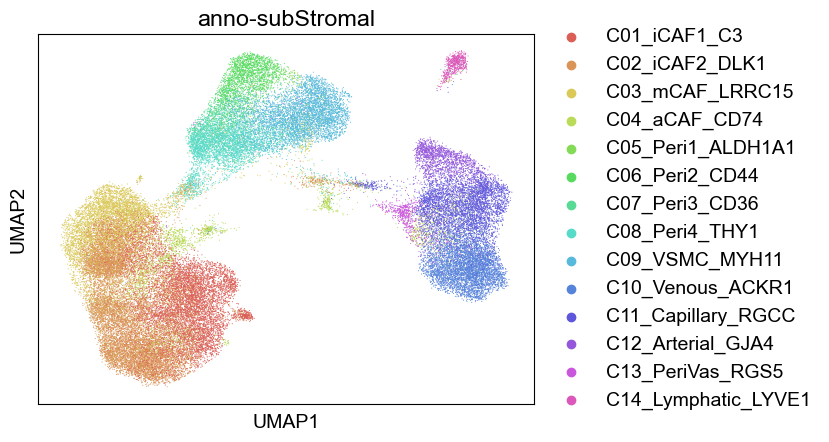

In [450]:
sc.pl.umap(adata_stromal, color='anno-subStromal')

In [ ]:
adata_epi = sc.read_h5ad(f"{datapath}/adata-epi-concat-12.17.h5ad")
adata_epi

AnnData object with n_obs × n_vars = 76216 × 17269
    obs: 'batch', 'age', 'majorType-fix', 'IHC', 'study', 'annotation', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation'
    var: 'n_cells-Non-young', 'highly_variable-Non-young', 'means-Non-young', 'dispersions-Non-young', 'dispersions_norm-Non-young', 'type-Non-young', 'n_cells_by_counts-Young', 'mean_counts-Young', 'log1p_mean_counts-Young', 'pct_dropout_by_counts-Young', 'total_counts-Young', 'log1p_total_counts-Young', 'n_cells-Young', 'highly_variable-Young', 'means-Young', 'dispersions-Young', 'dispersions_norm-Young', 'symbol-Young', 'ensg-Young', 'chromosome-Young', 'start-Young', 'end-Young', 'n_cells_by_counts-Young-inter', 'mean_counts-Young-inter', 'log1p_mean_counts-Young-inter', 'pct_dropout_by_counts-Young-inter', 'total_counts-Young-inter', 'log1p_total_counts-Young-inter', 'n_cells-Young-inter', 'highly_variable-Young-inter', 'means-Young-inter', 'dispersions-Young-inter', 'dispersions_norm-Young-inter', 'type-

In [466]:
adata_CD8T.obs['annotation'] = adata_CD8T.obs['anno-newCD8T']
adata_Mye.obs['annotation'] = adata_Mye.obs['anno-Mye']
adata_stromal.obs['annotation'] = adata_stromal.obs['anno-subStromal']
adata_CCI = adata_CD8T.concatenate([adata_Mye, adata_stromal])
adata_CCI.obs['batch'] = adata_CCI.obs['sample']
adata_CCI

/tmp/ipykernel_3871064/1942492611.py:4: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_CCI = adata_CD8T.concatenate([adata_Mye, adata_stromal])
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/merge.py:1337: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


AnnData object with n_obs × n_vars = 98638 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'anno-CD8T-har', 'cptype', 'cytotoxicity', 'MANAscore', 'exhaustion', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-newCD8T', 'annotation', 'leiden-B', 'leiden-Mye', 'Mye-type', 'leiden-Mye1.5', 'leiden-Mye1.8', 'leiden-Mye2.0', 'har_group', 'leiden-Mye2.5', 'anno-mye', 'anno-Mye', 'attr', 'IHC', 'leiden-stromal', 'anno-stromal', 'anno-subStromal'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_d

In [699]:
adata_epi.obs['sample'] = adata_epi.obs['batch'] 
adata_epi.obs['cptype'] = adata_epi.obs['annotation']

In [700]:
adata_YBC = adata_CCI.concatenate(adata_epi[adata_epi.obs['age'] == 'Young'])
adata_YBC.obs['batch'] = adata_YBC.obs['sample']
adata_YBC.obs_names = [s[:-2] for s in adata_YBC.obs_names]
adata_YBC

AnnData object with n_obs × n_vars = 161267 × 17133
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'anno-CD8T-har', 'cptype', 'cytotoxicity', 'MANAscore', 'exhaustion', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-newCD8T', 'annotation', 'leiden-B', 'leiden-Mye', 'Mye-type', 'leiden-Mye1.5', 'leiden-Mye1.8', 'leiden-Mye2.0', 'har_group', 'leiden-Mye2.5', 'anno-mye', 'anno-Mye', 'attr', 'IHC', 'leiden-stromal', 'anno-stromal', 'anno-subStromal', 'age', 'study', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation

In [706]:
adata_OBC = adata_CCI.concatenate(adata_epi[adata_epi.obs['age'] == 'Non-young'])
adata_OBC.obs['batch'] = adata_OBC.obs['sample']
adata_OBC.obs_names = [s[:-2] for s in adata_OBC.obs_names]
adata_OBC

AnnData object with n_obs × n_vars = 112225 × 17133
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'anno-CD8T-har', 'cptype', 'cytotoxicity', 'MANAscore', 'exhaustion', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-newCD8T', 'annotation', 'leiden-B', 'leiden-Mye', 'Mye-type', 'leiden-Mye1.5', 'leiden-Mye1.8', 'leiden-Mye2.0', 'har_group', 'leiden-Mye2.5', 'anno-mye', 'anno-Mye', 'attr', 'IHC', 'leiden-stromal', 'anno-stromal', 'anno-subStromal', 'age', 'study', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation

In [701]:
adata_YBC.obs['cptype'] = adata_YBC.obs['cptype'].astype("category")

In [469]:
adata_CCI.obs_names = [s[:-2] for s in adata_CCI.obs_names]

In [477]:
annot = {
    'M01_Mac1_SPP1': ['C01_Mac1_SPP1'],
    'T01_Tn/Tcm_CCR7': ['C01_Tn/Tcm_CCR7'],
    'S01_iCAF1_C3': ['C01_iCAF1_C3'],
    'M02_Mac2_CXCL10': ['C02_Mac2_CXCL10'],
    'T02_Tcm_ISG15': ['C02_Tcm_ISG15'],
    'S02_iCAF2_DLK1': ['C02_iCAF2_DLK1'],
    'M03_Mac3_FOLR2': ['C03_Mac3_FOLR2'],
    'T03_Teff_GZMK': ['C03_Teff_GZMK'],
    'S03_mCAF_LRRC15': ['C03_mCAF_LRRC15'],
    'M04_Mac4_C3': ['C04_Mac4_C3'],
    'T04_Trm_XCL1': ['C04_Trm_XCL1'],
    'S04_aCAF_CD74': ['C04_aCAF_CD74'],
    'M05_Mac5_Myo': ['C05_Mac5_Myo'],
    'S05_Peri1_ALDH1A1': ['C05_Peri1_ALDH1A1'],
    'T05_pTex_IFNG': ['C05_pTex_IFNG'],
    'M06_Monocyte': ['C06_Monocyte'],
    'S06_Peri2_CD44': ['C06_Peri2_CD44'],
    'T06_tTex_early': ['C06_tTex_early'],
    'M07_Neutrophil': ['C07_Neutrophil'],
    'S07_Peri3_CD36': ['C07_Peri3_CD36'],
    'T07_tTex_late': ['C07_tTex_late'],
    'S08_Peri4_THY1': ['C08_Peri4_THY1'],
    'T08_Tprolif_MKI67': ['C08_Tprolif_MKI67'],
    'M08_cDC1': ['C08_cDC1'],
    'T09_NK_NCAM1': ['C09_NK_NCAM1'],
    'S09_VSMC_MYH11': ['C09_VSMC_MYH11'],
    'M09_cDC2': ['C09_cDC2'],
    'M10_LC': ['C10_LC'],
    'T10_NKT_FGFBP2': ['C10_NKT_FGFBP2'],
    'S10_Venous_ACKR1': ['C10_Venous_ACKR1'],
    'S11_Capillary_RGCC': ['C11_Capillary_RGCC'],
    'M11_mDC': ['C11_mDC'],
    'S12_Arterial_GJA4': ['C12_Arterial_GJA4'],
    'M12_pDC': ['C12_pDC'],
    'S13_PeriVas_RGS5': ['C13_PeriVas_RGS5'],
    'S14_Lymphatic_LYVE1': ['C14_Lymphatic_LYVE1']
}
adata_CCI = anno(adata_CCI, annot, 'cptype', 'annotation')
adata_CCI.obs['cptype'] = adata_CCI.obs['cptype'].astype("category")

In [479]:
adata_CCI.write_h5ad("adata-CCI-5.17.h5ad")

In [471]:
from cellphonedb.src.core.methods import cpdb_statistical_analysis_method
import ktplotspy as kpy

In [480]:
meta = pd.DataFrame(adata_CCI.obs['cptype'].copy())
meta = meta.reset_index()
meta.columns=['Cell', 'cell_type']
meta.to_csv("meta.txt", sep='\t', index=False)
cpdb_res_imm = cpdb_statistical_analysis_method.call(
  cpdb_file_path="cellphonedb.zip",
  meta_file_path="meta.txt",
  counts_file_path="adata-CCI-5.17.h5ad",
  counts_data='hgnc_symbol',
  output_path="cpdb",
  threads=16,
)

Reading user files...
The following user files were loaded successfully:
adata-CCI-5.17.h5ad
meta.txt
[ ][CORE][17/05/25-14:09:15][INFO] [Cluster Statistical Analysis] Threshold:0.1 Iterations:1000 Debug-seed:-1 Threads:16 Precision:3
[ ][CORE][17/05/25-14:09:36][INFO] Running Real Analysis
[ ][CORE][17/05/25-14:09:36][INFO] Running Statistical Analysis


100%|██████████| 1000/1000 [25:10<00:00,  1.51s/it]


[ ][CORE][17/05/25-14:34:51][INFO] Building Pvalues result
[ ][CORE][17/05/25-14:34:57][INFO] Building results
Saved deconvoluted to cpdb/statistical_analysis_deconvoluted_05_17_2025_143458.txt
Saved deconvoluted_percents to cpdb/statistical_analysis_deconvoluted_percents_05_17_2025_143458.txt
Saved means to cpdb/statistical_analysis_means_05_17_2025_143458.txt
Saved pvalues to cpdb/statistical_analysis_pvalues_05_17_2025_143458.txt
Saved significant_means to cpdb/statistical_analysis_significant_means_05_17_2025_143458.txt


In [703]:
adata_YBC.write_h5ad("adata-YBC-CCI-5.23.h5ad")

In [704]:
meta = pd.DataFrame(adata_YBC.obs['cptype'].copy())
meta = meta.reset_index()
meta.columns=['Cell', 'cell_type']
meta.to_csv("meta.txt", sep='\t', index=False)
cpdb_res_YBC = cpdb_statistical_analysis_method.call(
  cpdb_file_path="cellphonedb.zip",
  meta_file_path="meta.txt",
  counts_file_path="adata-YBC-CCI-5.23.h5ad",
  counts_data='hgnc_symbol',
  output_path="cpdb",
  threads=32,
)

Reading user files...
The following user files were loaded successfully:
adata-YBC-CCI-5.23.h5ad
meta.txt
[ ][CORE][23/05/25-13:52:39][INFO] [Cluster Statistical Analysis] Threshold:0.1 Iterations:1000 Debug-seed:-1 Threads:32 Precision:3
[ ][CORE][23/05/25-13:52:49][INFO] Running Real Analysis
[ ][CORE][23/05/25-13:52:51][INFO] Running Statistical Analysis


100%|██████████| 1000/1000 [35:39<00:00,  2.14s/it]


[ ][CORE][23/05/25-14:28:53][INFO] Building Pvalues result
[ ][CORE][23/05/25-14:29:00][INFO] Building results
Saved deconvoluted to cpdb/statistical_analysis_deconvoluted_05_23_2025_142903.txt
Saved deconvoluted_percents to cpdb/statistical_analysis_deconvoluted_percents_05_23_2025_142903.txt
Saved means to cpdb/statistical_analysis_means_05_23_2025_142903.txt
Saved pvalues to cpdb/statistical_analysis_pvalues_05_23_2025_142903.txt
Saved significant_means to cpdb/statistical_analysis_significant_means_05_23_2025_142903.txt


In [718]:
adata_OBC.obs_names_make_unique()

In [719]:
adata_OBC.write_h5ad("adata-OBC-CCI-5.23.h5ad")

In [ ]:
meta = pd.DataFrame(adata_OBC.obs['cptype'].copy())
meta = meta.reset_index()
meta.columns=['Cell', 'cell_type']
meta.to_csv("meta.txt", sep='\t', index=False)
cpdb_res_OBC = cpdb_statistical_analysis_method.call(
  cpdb_file_path="cellphonedb.zip",
  meta_file_path="meta.txt",
  counts_file_path="adata-OBC-CCI-5.23.h5ad",
  counts_data='hgnc_symbol',
  output_path="cpdb",
  threads=32,
)

Reading user files...
The following user files were loaded successfully:
adata-OBC-CCI-5.23.h5ad
meta.txt
[ ][CORE][23/05/25-14:48:44][INFO] [Cluster Statistical Analysis] Threshold:0.1 Iterations:1000 Debug-seed:-1 Threads:32 Precision:3
[ ][CORE][23/05/25-14:48:50][INFO] Running Real Analysis
[ ][CORE][23/05/25-14:48:51][INFO] Running Statistical Analysis


  3%|▎         | 31/1000 [01:00<29:40,  1.84s/it] 

In [482]:
ax = kpy.plot_cpdb(
  adata=adata_CCI,
  cell_type1="T06_tTex_early",
  cell_type2='M01_Mac1_SPP1|M02_Mac2_CXCL10|M03_Mac3_FOLR2|M04_Mac4_C3|M05_Mac5_Myo|M06_Monocyte|M07_Neutrophil|M08_cDC1|M09_cDC2|M10_LC|M11_mDC|M12_pDC',
  means=cpdb_res_imm['means'],
  pvals=cpdb_res_imm['pvalues'],
  genes=["PDCD1", 'CTLA4', 'TIGIT', 'CD274', 'HLE', 'CXC', 'CCL', 'CD2', 'ENTPD1', 'CD86', 'IL10', 'DPP4'],
  celltype_key='cptype',
  max_size=4,
  max_highlight_size=1,
  highlight_size=0.75,
  degs_analysis=False,
  standard_scale=True,
  figsize=(14,14),
)
ax.save(f'figure-1.23/cpdb_Tex_Mye.png', dpi=300)

In [ ]:
from plotnine import (
    aes,
    element_blank,
    element_rect,
    element_text,
    geom_point,
    ggplot,
    ggtitle,
    guide_colourbar,
    guide_legend,
    guides,
    options,
    scale_alpha_continuous,
    scale_x_discrete,
    scale_colour_continuous,
    scale_colour_manual,
    scale_fill_continuous,
    scale_fill_manual,
    scale_size_continuous,
    theme,
    theme_bw,
    theme_matplotlib
)

In [825]:
def myplot_cpdb(df, figure_size = (5,6), xlabels=None):
    options.figure_size = figure_size
    colm = "scaled_means"
    highlight_size = 0.75
    max_size = 4
    max_highlight_size = 0.75
    stroke = "x_stroke"
    default_style = True
    highlight_col = "#d62728"
    cmap_name = "viridis"
    DEFAULT_SEP = ">@<"
    # set global figure size

    g = ggplot(
        df,
        aes(
            x="celltype_group",
            y="interaction_group",
            colour="significant",
            fill=colm,
            size=colm,
            stroke=stroke,
        ),
    )
    g = (
        g
        + geom_point(
            na_rm=True,
        )
        + theme_bw()
        # + theme_matplotlib(rc={"figure.figsize": (4,6), 'font.family': 'Arial'})
        + theme(
            axis_text_x=element_text(angle=90, hjust=0, colour="#000000"),
            axis_text_y=element_text(colour="#000000"),
            axis_ticks=element_blank(),
            axis_title_x=element_blank(),
            axis_title_y=element_blank(),
            legend_key=element_rect(alpha=0, width=0, height=0),
            legend_direction="vertical",
            legend_box="vertical",
        )
        + scale_size_continuous(range=(0, max_size), aesthetics=["size"])
        + scale_size_continuous(range=(0, max_highlight_size), aesthetics=["stroke"])
    )
    if default_style:
        g = (
            g
            + scale_colour_manual(values=highlight_col, na_translate=False)
            + guides(
                fill=guide_colourbar(barwidth=4, label=True, ticks=True, draw_ulim=True, draw_llim=True, order=1),
                size=guide_legend(
                    reverse=True,
                    order=2,
                ),
                stroke=guide_legend(
                    reverse=True,
                    order=3,
                ),
            )
            + scale_fill_continuous(cmap_name=cmap_name)
        )
    if highlight_size is not None:
        g = g + guides(stroke=None)
    if xlabels is not None:
        g = g + scale_x_discrete(labels=xlabels)
    return g

In [ ]:
ax_etTex_mac = kpy.plot_cpdb(
  adata=adata_CCI,
  cell_type1="T05_pTex_IFNG|T06_tTex_early|T07_tTex_late",
  cell_type2='M01_Mac1_SPP1|M02_Mac2_CXCL10|M03_Mac3_FOLR2|M04_Mac4_C3|M05_Mac5_Myo|M06_Monocyte|M07_Neutrophil|M08_cDC1|M09_cDC2|M10_LC|M11_mDC|M12_pDC|S01_iCAF1_C3|S02_iCAF2_DLK1|S03_mCAF_LRRC15|S04_aCAF_CD74',
  means=cpdb_res_imm['means'],
  pvals=cpdb_res_imm['pvalues'],
  celltype_key='cptype',
  max_size=4,
  max_highlight_size=1,
  highlight_size=0.75,
  degs_analysis=False,
  standard_scale=True,
  figsize=(14,14),
  return_table=True
)

In [ ]:
df_mac_fib = kpy.plot_cpdb(
  adata=adata_CCI,
  cell_type1="S03_mCAF_LRRC15|S04_aCAF_CD74",
  cell_type2='M01_Mac1_SPP1|M05_Mac5_Myo',
  means=cpdb_res_imm['means'],
  pvals=cpdb_res_imm['pvalues'],
  celltype_key='cptype',
  max_size=4,
  max_highlight_size=1,
  highlight_size=0.75,
  degs_analysis=False,
  standard_scale=True,
  figsize=(14,14),
  return_table=True
)

In [ ]:
df_etTex_fib = ax_etTex_fib

In [ ]:
df_etTex_mac = ax_etTex_mac

In [ ]:
DEFAULT_SEP = ">@<"
df_etTex_mac.interaction_group = [c.split(DEFAULT_SEP * 3)[1] for c in df_etTex_mac.interaction_group]

In [ ]:
DEFAULT_SEP = ">@<"
df_etTex_fib.interaction_group = [c.split(DEFAULT_SEP * 3)[1] for c in df_etTex_fib.interaction_group]

In [ ]:
y_order = ['CD274-PDCD1', 'PDCD1LG2-PDCD1','CD274-CD80', 'NECTIN2-TIGIT', 'PVR-TIGIT', 
           'LGALS9-HAVCR2','CD86-CTLA4', 'CD80-CTLA4', 'CD86-CD28','SPP1-integrin-a4b1-complex', 'CD70-CD27',
            'CXCL10-CXCR3', 'CXCL9-CXCR3',
            'TNFSF9-TNFRSF9','CD58-CD2','ICOSLG-ICOS',
            'CD200-CD200R1','HLA-E-KLRC1', 'HLA-E-CD94:NKG2A','CDH1-KLRG1',]
y_order.reverse()
df_etTex_mac_sub = df_etTex_mac[df_etTex_mac['interaction_group'].isin(y_order)]
df_etTex_mac_sub['interaction_group'] = pd.Categorical(df_etTex_mac_sub['interaction_group'], categories=y_order, ordered=True)

/tmp/ipykernel_3871064/188433417.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [ ]:
def find_strings_with_substring(lst, substring):
    return [s for s in lst if substring in s]
lst = df_etTex_mac_sub['celltype_group'].cat.categories
cell_group = find_strings_with_substring(lst, "-T05_pTex_IFNG")
df_T05_mac_sub = df_etTex_mac_sub[df_etTex_mac_sub['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "-T06_tTex_early")
df_T06_mac_sub = df_etTex_mac_sub[df_etTex_mac_sub['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "-T07_tTex_late")
df_T07_mac_sub = df_etTex_mac_sub[df_etTex_mac_sub['celltype_group'].isin(cell_group)]

In [ ]:
adata_Mye.obs['anno-Mye'].cat.categories

Index(['C01_Mac1_SPP1', 'C02_Mac2_CXCL10', 'C03_Mac3_FOLR2', 'C04_Mac4_C3',
       'C05_Mac5_Myo', 'C06_Monocyte', 'C07_Neutrophil', 'C08_cDC1',
       'C09_cDC2', 'C10_LC', 'C11_mDC', 'C12_pDC'],
      dtype='object')

In [ ]:
xlabels = ['Mac1_SPP1', 'Mac2_CXCL10', 'Mac3_FOLR2', 'Mac4_C3',
       'Mac5_Myo', 'Monocyte', 'Neutrophil', 'cDC1',
       'cDC2', 'LC', 'mDC', 'pDC','stCAF','iCAF','mCAF', 'apCAF']
ax_T05_mac = myplot_cpdb(df_T05_mac_sub, 
                         figure_size = (5.2,4.8), 
                         xlabels=xlabels)
ax_T05_mac.save(f"{figPath}/cpdb-T05-mac-filtered.pdf")

In [ ]:
ax_T06_mac = myplot_cpdb(df_T06_mac_sub, 
                         figure_size = (5.2,4.8), 
                         xlabels=xlabels)
ax_T06_mac.save(f"{figPath}/cpdb-T06-mac-filtered.pdf")

In [ ]:
ax_T07_mac = myplot_cpdb(df_T07_mac_sub, 
                         figure_size = (5.2,4.8), 
                         xlabels=xlabels)
ax_T07_mac.save(f"{figPath}/cpdb-T07-mac-filtered.pdf")

In [ ]:
df_YBC = kpy.plot_cpdb(
  adata=adata_YBC,
  cell_type1="HR+HER2+|HR+HER2-|HR-HER2+|TNBC|LumHR|LumSec|MaSC",
  cell_type2="T05_pTex_IFNG|T06_tTex_early|T07_tTex_late|T09_NK_NCAM1|T10_NKT_FGFBP2|M01_Mac1_SPP1|M02_Mac2_CXCL10|M05_Mac5_Myo|M10_LC|M11_mDC|S03_mCAF_LRRC15|S04_aCAF_CD74",
  means=cpdb_res_YBC['means'],
  pvals=cpdb_res_YBC['pvalues'],
  celltype_key='cptype',
  max_size=4,
  max_highlight_size=1,
  highlight_size=0.75,
  degs_analysis=False,
  standard_scale=True,
  figsize=(14,14),
  return_table=True
)

In [729]:
DEFAULT_SEP = ">@<"
df_YBC.interaction_group = [c.split(DEFAULT_SEP * 3)[1] for c in df_YBC.interaction_group]

In [874]:
def find_strings_with_substring(lst, substring):
    return [s for s in lst if substring in s]
lst = df_YBC['celltype_group'].cat.categories
cell_group = find_strings_with_substring(lst, "HR+HER2+-")
df_HRHER2 = df_YBC[df_YBC['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "HR-HER2+-")
df_HER2 = df_YBC[df_YBC['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "HR+HER2--")
df_HR = df_YBC[df_YBC['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "TNBC-")
df_TNBC = df_YBC[df_YBC['celltype_group'].isin(cell_group)]

In [831]:

df_YBC[df_YBC['interaction_group'].isin([
           'CCL3-CCR1', 
           'CCL3-CCR5',
           'CCL4-CCR5', 
           'CCL5-CCR1','ENTPD1-ADORA2A',
           'CD80-CTLA4',
           'CD86-CTLA4', 
           'CD200-CD200R1',
           'CD70-CD27',
         'CXCL2-DPP4',
         'CXCL9-DPP4',])]

,interaction_group,celltype_group,scaled_means,pvals,x_means,y_means,x_stroke,neglog10p,significant,is_integrin,directionality,classification
CPI-SS0CDAC688B>@<>@<>@<CXCL2-DPP4>@<>@<>@<HR+HER2+>@<M01_Mac1_SPP1,CXCL2-DPP4,HR+HER2+-M01_Mac1_SPP1,0.034965,1.0,0.034965,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Chemokines
CPI-SS0E90C46BC>@<>@<>@<ENTPD1-ADORA2A>@<>@<>@<HR+HER2+>@<M01_Mac1_SPP1,ENTPD1-ADORA2A,HR+HER2+-M01_Mac1_SPP1,0.014423,1.0,0.014423,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Ectonucleoside
CPI-SS0CDAC688B>@<>@<>@<CXCL2-DPP4>@<>@<>@<HR+HER2+>@<M02_Mac2_CXCL10,CXCL2-DPP4,HR+HER2+-M02_Mac2_CXCL10,0.023310,1.0,0.023310,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Chemokines
CPI-SS0E90C46BC>@<>@<>@<ENTPD1-ADORA2A>@<>@<>@<HR+HER2+>@<M02_Mac2_CXCL10,ENTPD1-ADORA2A,HR+HER2+-M02_Mac2_CXCL10,0.009615,1.0,0.009615,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Ectonucleoside
CPI-SS0CDAC688B>@<>@<>@<CXCL2-DPP4>@<>@<>@<HR+HER2+>@<M05_Mac5_Myo,CXCL2-DPP4,HR+HER2+-M05_Mac5_Myo,0.032634,1.0,0.032634,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Chemokines
...,...,...,...,...,...,...,...,...,...,...,...,...
CPI-SS0E90C46BC>@<>@<>@<ENTPD1-ADORA2A>@<>@<>@<TNBC>@<T07_tTex_late,ENTPD1-ADORA2A,TNBC-T07_tTex_late,0.048077,1.0,0.048077,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Ectonucleoside
CPI-SS0CDAC688B>@<>@<>@<CXCL2-DPP4>@<>@<>@<TNBC>@<T09_NK_NCAM1,CXCL2-DPP4,TNBC-T09_NK_NCAM1,0.081585,1.0,0.081585,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Chemokines
CPI-SS0E90C46BC>@<>@<>@<ENTPD1-ADORA2A>@<>@<>@<TNBC>@<T09_NK_NCAM1,ENTPD1-ADORA2A,TNBC-T09_NK_NCAM1,0.033654,1.0,0.033654,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Ectonucleoside
CPI-SS0CDAC688B>@<>@<>@<CXCL2-DPP4>@<>@<>@<TNBC>@<T10_NKT_FGFBP2,CXCL2-DPP4,TNBC-T10_NKT_FGFBP2,0.086247,1.0,0.086247,NaN,0.0,0.0,NaN,False,Ligand-Receptor,Signaling by Chemokines


In [753]:
df_YBC['classification'].unique()

array(['Signaling by Amyloid-beta precursor protein',
       'Adhesion by Osteopontin', 'Signaling by Apolipoprotein',
       'Adhesion by Fibronectin', 'Adhesion by Collagen/Integrin',
       'Signaling by Semaphorin', 'Signaling by Chemokines', nan,
       'Signaling by Galectin', 'Signaling by Prostaglandin',
       'Signaling by Amyloid-like protein', 'Signaling by Annexin',
       'Signaling by WNT inhibition',
       'Signaling by Epidermal growth factor',
       'Signaling by Plasminogen Activator', 'Adhesion by antigen THY1',
       'Signaling by Integrin', 'Signaling by Colony-Stimulating factor',
       'Signaling by Interleukin',
       'Signaling by Thrombospondin precursor',
       'Adhesion by Thrombospondin',
       'Signaling by Vascular endothelial growth factor',
       'Signaling by Complement', 'Signaling by Tumor necrosis factor',
       'Adhesion by ICAM', 'Signaling by Cholesterol',
       'Signaling by Insulin-like growth factor', 'Adhesion by Desmosome',
      

In [878]:
# selected_pathways = ['Adhesion by Cadherin', 'Signaling by HLA', 'Adhesion by Osteopontin','Signaling by Galectin','Signaling by Poliovirus receptor', 'Signaling by Chemokines','Signaling by Amyloid-beta precursor protein', 'Signaling by Vascular endothelial growth factor', 'Signaling by Transforming growth factor', 'Signaling by Epidermal growth factor', 'Signaling by Ectonucleoside']
# selected_pathways = ['Adhesion by Cadherin', 'Signaling by HLA', 'Adhesion by Osteopontin','Signaling by Galectin','Signaling by Poliovirus receptor', 'Signaling by Chemokines','Signaling by Amyloid-beta precursor protein', 'Signaling by Vascular endothelial growth factor']
selected_pathways = ['Adhesion by Cadherin', 'Signaling by HLA','Signaling by Chemokines']

In [882]:
ax_HRHER2_CDH1 = myplot_cpdb(df_HRHER2[df_HRHER2['classification'].isin(selected_pathways)], 
                         figure_size = (4.5,4))
ax_HRHER2_CDH1.save(f"{figPath}/cpdb-YBC-HRHER2.pdf")

In [886]:
ax_HER2_CDH1 = myplot_cpdb(df_HER2[df_HER2['classification'].isin(selected_pathways)], 
                         figure_size = (4.5,4))
ax_HER2_CDH1.save(f"{figPath}/cpdb-YBC-HER2.pdf")

In [889]:
ax_HR_CDH1 = myplot_cpdb(df_HR[df_HR['classification'].isin(selected_pathways)], 
                         figure_size = (4.5,4))
ax_HR_CDH1.save(f"{figPath}/cpdb-YBC-HR.pdf")

In [894]:
ax_TNBC_CDH1 = myplot_cpdb(df_TNBC[df_TNBC['classification'].isin(selected_pathways)], 
                         figure_size = (4.5,3.7))
ax_TNBC_CDH1.save(f"{figPath}/cpdb-YBC-TNBC.pdf")
# ax_T07_mac.save(f"{figPath}/cpdb-TNBC_CDH1.pdf")

In [ ]:
lst = df_YBC['celltype_group'].cat.categories
cell_group = find_strings_with_substring(lst, "LumHR-")
df_LumHR = df_YBC[df_YBC['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "LumSec-")
df_LumSec = df_YBC[df_YBC['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "MaSC-")
df_MaSC = df_YBC[df_YBC['celltype_group'].isin(cell_group)]

In [853]:
ax_LumHR_CDH1 = myplot_cpdb(df_LumHR[df_LumHR['classification'].isin(selected_pathways)], 
                         figure_size = (5.2,7))
ax_LumHR_CDH1.save(f"{figPath}/cpdb-YBC-LumHR.pdf")

In [854]:
ax_MaSC_CDH1 = myplot_cpdb(df_MaSC[df_MaSC['classification'].isin(selected_pathways)], 
                         figure_size = (5.2,7))
ax_MaSC_CDH1.save(f"{figPath}/cpdb-YBC-MaSC.pdf")

In [855]:
ax_LumSec_CDH1 = myplot_cpdb(df_LumSec[df_LumSec['classification'].isin(selected_pathways)], 
                         figure_size = (5.2,7))
ax_LumSec_CDH1.save(f"{figPath}/cpdb-YBC-LumSec.pdf")

In [860]:
df_OBC = kpy.plot_cpdb(
  adata=adata_OBC,
  cell_type1="HR+HER2+|HR+HER2-|HR-HER2+|TNBC|LumHR|LumSec|MaSC",
  cell_type2="T05_pTex_IFNG|T06_tTex_early|T07_tTex_late|T09_NK_NCAM1|T10_NKT_FGFBP2|M01_Mac1_SPP1|M02_Mac2_CXCL10|M05_Mac5_Myo|M10_LC|M11_mDC|S03_mCAF_LRRC15|S04_aCAF_CD74",
  means=cpdb_res_OBC['means'],
  pvals=cpdb_res_OBC['pvalues'],
  celltype_key='cptype',
  max_size=4,
  max_highlight_size=1,
  highlight_size=0.75,
  degs_analysis=False,
  standard_scale=True,
  figsize=(14,14),
  return_table=True
)

In [867]:
DEFAULT_SEP = ">@<"
df_OBC.interaction_group = [c.split(DEFAULT_SEP * 3)[1] for c in df_OBC.interaction_group]

In [895]:
def find_strings_with_substring(lst, substring):
    return [s for s in lst if substring in s]
lst = df_OBC['celltype_group'].cat.categories
cell_group = find_strings_with_substring(lst, "HR+HER2+-")
df_HRHER2 = df_OBC[df_OBC['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "HR-HER2+-")
df_HER2 = df_OBC[df_OBC['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "HR+HER2--")
df_HR = df_OBC[df_OBC['celltype_group'].isin(cell_group)]
cell_group = find_strings_with_substring(lst, "TNBC-")
df_TNBC = df_OBC[df_OBC['celltype_group'].isin(cell_group)]

In [910]:
df_OBC['interaction_group'] = df_OBC['interaction_group'].astype('category')

In [923]:
lst = df_OBC['interaction_group'].cat.categories
filter_group = find_strings_with_substring(lst, "-ACKR2")
df = df_HRHER2[df_HRHER2['classification'].isin(selected_pathways)]
df = df[~df['interaction_group'].isin(filter_group)]
ax_HRHER2_CDH1 = myplot_cpdb(df, 
                         figure_size = (4.5,4.2))
ax_HRHER2_CDH1.save(f"{figPath}/cpdb-OBC-HRHER2.pdf")

In [925]:
lst = df_OBC['interaction_group'].cat.categories
filter_group = find_strings_with_substring(lst, "-ACKR2")
df = df_HER2[df_HER2['classification'].isin(selected_pathways)]
df = df[~df['interaction_group'].isin(filter_group)]
ax_HER2_CDH1 = myplot_cpdb(df, 
                         figure_size = (4.5,4.2))
ax_HER2_CDH1.save(f"{figPath}/cpdb-OBC-HER2.pdf")

In [926]:
lst = df_OBC['interaction_group'].cat.categories
filter_group = find_strings_with_substring(lst, "-ACKR2")
df = df_HR[df_HR['classification'].isin(selected_pathways)]
df = df[~df['interaction_group'].isin(filter_group)]
ax_HR_CDH1 = myplot_cpdb(df, 
                         figure_size = (4.5,4.2))
ax_HR_CDH1.save(f"{figPath}/cpdb-OBC-HR.pdf")

In [929]:
lst = df_OBC['interaction_group'].cat.categories
filter_group = find_strings_with_substring(lst, "-ACKR2")
df = df_TNBC[df_TNBC['classification'].isin(selected_pathways)]
df = df[~df['interaction_group'].isin(filter_group)]
ax_TNBC_CDH1 = myplot_cpdb(df, 
                         figure_size = (4.5,3.9))
ax_TNBC_CDH1.save(f"{figPath}/cpdb-OBC-TNBC.pdf")

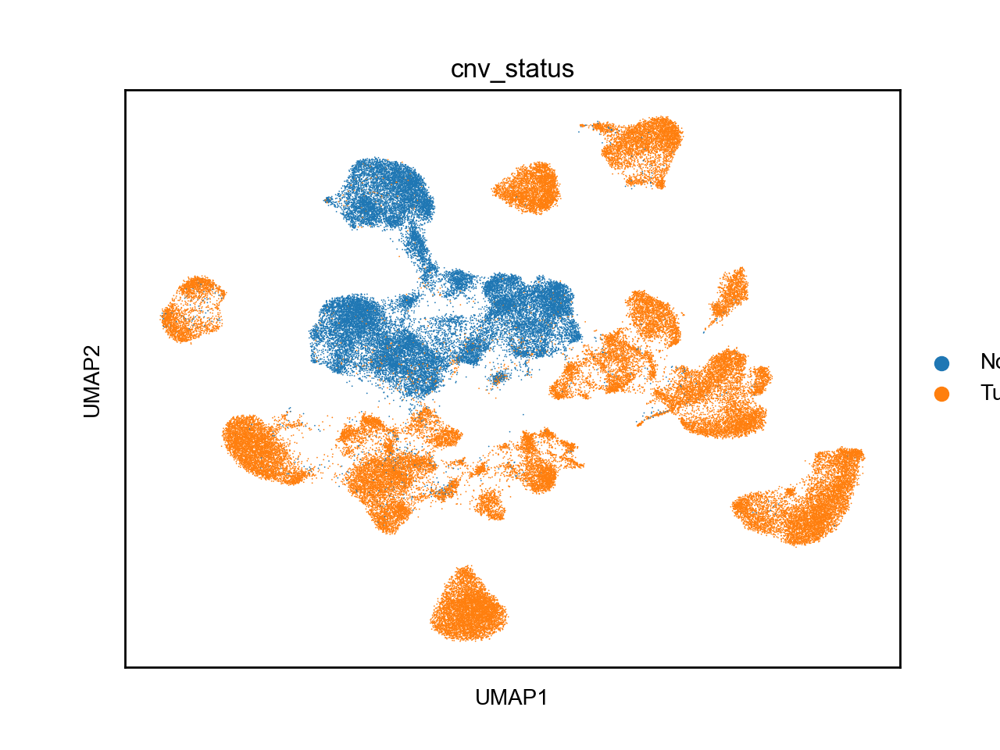

In [938]:
sc.pl.umap(adata_epi,color=['cnv_status'])

In [1296]:
import memento
import anndata as ad
import pandas as pd
def DE_memento_1d(adata: ad.AnnData, ctleft: list, ctright: list, groupby='annotation', use_raw=True):
  """
  使用 Memento 包分析单细胞测序数据中的动态变化。

  Args:
      adata (ad.AnnData): 单细胞测序数据的 AnnData 对象,adata.X requires raw data。
      ctleft (list): 左条件列表，表示刺激前的细胞类型或状态。
      ctright (list): 右条件列表，表示刺激后的细胞类型或状态。
      groupby (str, optional): 用于分组的注释列名。默认为 'annotation'。

  Returns:
      pd.DataFrame: Memento 分析的结果，包括差异表达分析、HT 1D moments 分析等。

  """
  _adata = adata[adata.obs[groupby].isin(ctleft + ctright)].copy()
  if use_raw:
    _adata = ad.AnnData(_adata.layers['Raw'], obs = _adata.obs, var = _adata.var)
  _adata.obs['stim'] = _adata.obs[groupby].isin(ctright)
  _adata.obs['stim'] = _adata.obs['stim'].astype('int')
  _adata.obs['capture_rate'] = 0.07
  memento.setup_memento(_adata, q_column='capture_rate')
  memento.create_groups(_adata, label_columns=['stim'])
  memento.compute_1d_moments(_adata, min_perc_group=.7)
  meta_df = memento.get_groups(_adata)
  meta_df['intercept'] = 1
  convariate = meta_df[['intercept']]
  treatment = (meta_df[['stim']] == 1).astype(float)
  
  memento.ht_1d_moments(_adata,
  covariate=convariate,
  treatment=treatment,
  num_cpus=16,
  resample_rep=False,
  )
  memento_results = memento.get_1d_ht_result(_adata)
  return(memento_results)

In [940]:
import scanpy as sc
import gseapy as gp
from gseapy import Msigdb
def prep_enrichr(adata, groupby):
  # de analysis
  sc.tl.rank_genes_groups(adata, groupby=groupby)
  sc.tl.dendrogram(adata, groupby=groupby)
  # get deg result
  result = adata.uns['rank_genes_groups']
  groups = result['names'].dtype.names
  degs = pd.DataFrame(
      {group + '_' + key: result[key][group]
      for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})
  return degs

def run_enrichr_genelist(genelist):
  kegg = gp.enrichr(genelist,
                  gene_sets='KEGG_2021_Human',
                  outdir=None)
  cc = gp.enrichr(genelist,
                      gene_sets='GO_Cellular_Component_2023',
                      outdir=None)
  hm = gp.enrichr(genelist,
                      gene_sets=['MSigDB_Hallmark_2020'],
                      outdir=None)
  mf = gp.enrichr(genelist,
                      gene_sets='GO_Molecular_Function_2023',
                      outdir=None)
  bp = gp.enrichr(genelist,
                      gene_sets=['GO_Biological_Process_2023'],
                      outdir=None)
  return kegg, cc, hm, mf, bp

def run_enrichr_scanpy(degs, group,direction='up', top_term=15, all_term=False, plot=True):
  # subset up or down regulated genes
  degs_sig = degs[degs[f'{group}_pvals_adj'] < 0.05]
  degs_up = degs_sig[degs_sig[f'{group}_logfoldchanges'] > 0]
  degs_dw = degs_sig[degs_sig[f'{group}_logfoldchanges'] < 0]
  degs_used = degs_up[f'{group}_names'] if direction == 'up' else degs_dw[f'{group}_names']
  kegg, cc, hm, mf, bp = run_enrichr_genelist(degs_used)
  go_res = pd.concat([kegg.res2d.head(top_term),
                    hm.res2d.head(top_term), 
                    cc.res2d.head(top_term), 
                    bp.res2d.head(top_term), 
                    mf.res2d.head(top_term)])
  if plot:
    ax = gp.barplot(go_res, figsize=(6,20),
                group ='Gene_set',
                top_term=top_term,
                color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
                title ="The Most Enriched Terms")
  else:
    ax = None
  if all_term:
    go_res = pd.concat([kegg.res2d, hm.res2d, cc.res2d, bp.res2d, mf.res2d])
  return go_res, ax
  
def run_enrichr_memento(memento_results,direction='up', top_term=15):
  memento_sig = memento_results[memento_results['de_pval'] < 0.05]
  memento_up = memento_sig[memento_sig['de_coef'] > 0]
  memento_dw = memento_sig[memento_sig['de_coef'] < 0]
  degs_used = memento_up['gene'] if direction == 'up' else memento_dw['gene']
  kegg, cc, hm, mf, bp = run_enrichr_genelist(degs_used)
  go_res = pd.concat([kegg.res2d.head(15),
                      hm.res2d.head(15), 
                      cc.res2d.head(15), 
                      bp.res2d.head(15), 
                      mf.res2d.head(15)])
  ax = gp.barplot(go_res, figsize=(6,20),
              group ='Gene_set',
              top_term=top_term,
              color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
              title ="The Most Enriched Terms")
  return go_res, ax

In [941]:
Young_degs = prep_enrichr(adata_epi, groupby='age')

In [962]:
Young_enr, ax = run_enrichr_scanpy(Young_degs,'Young',direction='up', top_term=15, all_term=True, plot=False)

In [963]:
NonYoung_enr, ax = run_enrichr_scanpy(Young_degs,'Non-young',direction='up', top_term=15, all_term=True, plot=False)

In [975]:
selected_pathways = [
  'Pathways in cancer',
  'Epithelial Mesenchymal Transition',
  'Breast cancer',
  'Mitotic Spindle',
  'Thyroid hormone signaling pathway',
  'ECM-receptor interaction',
  'Estrogen Response Early',
  'ErbB signaling pathway',
  'MAPK signaling pathway',
  'PI3K-Akt signaling pathway',

  'Hedgehog Signaling',
  'Apical Junction',
  'Hypoxia',
  'Wnt-beta Catenin Signaling',
  'G2-M Checkpoint',
  'Notch Signaling',
  'TNF-alpha Signaling via NF-kB',
    'Estrogen Response Late',
  'mTORC1 Signaling',
  'Oxidative phosphorylation',
  'Myc Targets V1',
  'Pathways of neurodegeneration',
  'Fatty Acid Metabolism',
  'Xenobiotic Metabolism',
  'E2F Targets',
  'p53 Pathway',
  'Interferon Gamma Response',
]

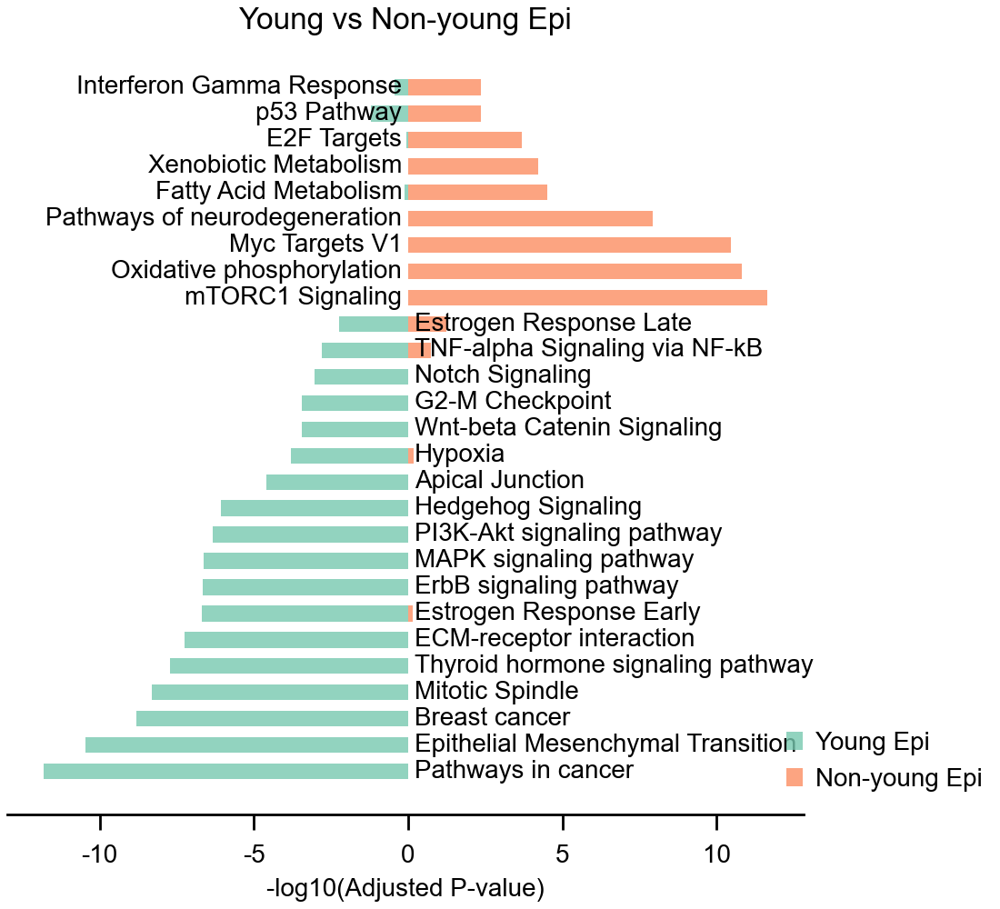

In [976]:
# 设置图形大小
use_pathway_left = Young_enr[Young_enr['Term'].isin(selected_pathways)]
use_pathway_right = NonYoung_enr[NonYoung_enr['Term'].isin(selected_pathways)]
use_pathway_left.index = use_pathway_left['Term']
use_pathway_right.index = use_pathway_right['Term']
use_pathway_left = use_pathway_left.loc[selected_pathways, :]
use_pathway_right = use_pathway_right.loc[selected_pathways, :]
fig, ax = plt.subplots(figsize=(5.5, 5), constrained_layout=True)

# 绘制柱状图
rects = ax.barh(use_pathway_left['Term'], 
                 np.log10(use_pathway_left['Adjusted P-value']), 
                 height=0.6, alpha=0.8,
                 color='#77c8af',
                 label='Young Epi')
rects = ax.barh(use_pathway_right['Term'], 
                -np.log10(use_pathway_right['Adjusted P-value']), 
                height=0.6, 
                alpha=0.8,
                color='#fc8d62',
                label='Non-young Epi')
# 绘制基因名称
for i, row in enumerate(use_pathway_left['Term'][:18]):
    ax.text(0.2, i, row, ha='left', va='center', fontsize=10)
for i, row in enumerate(use_pathway_right['Term'][18:]):
    ax.text(-0.2, i+18, row, ha='right', va='center', fontsize=10)
ax.legend( bbox_to_anchor=(0.95, 0), 
            handletextpad=0.5, frameon=False,
                        borderpad=0.4,
                        columnspacing=1,
                        handlelength=0.65,
            loc='lower left')

# 设置轴标签和标题
ax.set_xlabel('-log10(Adjusted P-value)')
ax.set_ylabel('')
ax.spines.top.set_visible(False)
ax.spines.left.set_visible(False)
ax.spines.right.set_visible(False)
# 设置刻度
# ax.set_xticks(np.arange(int(-np.max(-np.log10(use_pathway_left['Adjusted P-value']))-2),
#                       int(np.max(-np.log10(use_pathway_right['Adjusted P-value']))+2), 4))
ax.set_yticks([])
ax.set_title("Young vs Non-young Epi")
fig.savefig(f"{figPath}/FigureS3a.svg", bbox_inches='tight')

In [1021]:
adata_epiYBC = adata_epi[adata_epi.obs['age'] == 'Young']
adata_epiOBC = adata_epi[adata_epi.obs['age'] == 'Non-young']

In [1062]:
YoungT_degs = prep_enrichr(adata_epiYBC, groupby='cnv_status')
NonYoungT_degs = prep_enrichr(adata_epiOBC, groupby='cnv_status')

In [1063]:
YoungT_enr, ax = run_enrichr_scanpy(YoungT_degs,'Tumor',direction='up', top_term=15, all_term=False, plot=False)
YoungN_enr, ax = run_enrichr_scanpy(YoungT_degs,'Normal',direction='up', top_term=15, all_term=False, plot=False)

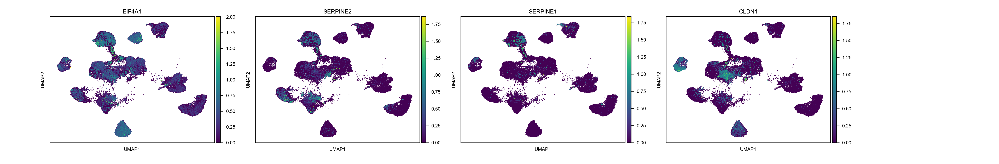

In [1080]:
sc.pl.umap(adata_epiYBC,color=["EIF4A1","SERPINE2","SERPINE1","CLDN1"], size=10)

In [1069]:
YoungN_enr[:50]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,KEGG_2021_Human,Focal adhesion,110/201,5.615899e-15,1.791472e-12,0,0,3.061121,100.445094,TNC;ACTB;MYLK;ACTG1;COMP;PPP1CB;CCND3;CCND2;TN...
1,KEGG_2021_Human,ECM-receptor interaction,57/88,1.800701e-12,2.872119e-10,0,0,4.632196,125.267771,ITGB1;ITGB4;LAMC3;ITGB3;TNC;LAMC2;LAMC1;COMP;T...
2,KEGG_2021_Human,Cell adhesion molecules,82/148,6.597702e-12,7.015556e-10,0,0,3.136167,80.738430,ITGB1;CD40;CNTNAP1;ICAM2;PTPRM;CLDN1;PVR;ICAM1...
3,KEGG_2021_Human,PI3K-Akt signaling pathway,160/354,1.518601e-11,1.211085e-09,0,0,2.092069,52.114791,ATF2;CSF3;CHRM1;CSF1;IRS1;TNC;PPP2R2A;FGF1;FGF...
4,KEGG_2021_Human,MAPK signaling pathway,137/294,3.219477e-11,2.054026e-09,0,0,2.210157,53.395659,ATF2;CSF1;IL1RAP;FGF1;FGF2;TNF;FGF7;MYC;AKT3;K...
5,KEGG_2021_Human,Pathways in cancer,217/531,5.172715e-10,2.750160e-08,0,0,1.756115,37.550037,RB1;SPI1;CALML3;FZD10;EDNRA;RASSF1;EDNRB;MYC;R...
6,KEGG_2021_Human,Arrhythmogenic right ventricular cardiomyopathy,48/77,7.080306e-10,3.226596e-08,0,0,4.163779,87.724728,ITGB1;RYR2;LAMA2;ITGB4;LAMA1;ITGB3;LEF1;TCF7;A...
7,KEGG_2021_Human,Malaria,35/50,1.495875e-09,5.963762e-08,0,0,5.862089,119.120902,CD40;CSF3;CXCL8;GYPC;KLRB1;LRP1;CD81;HBB;THBS2...
8,KEGG_2021_Human,NF-kappa B signaling pathway,59/104,1.682566e-09,5.963762e-08,0,0,3.300959,66.689089,CD40;CXCL8;EDA;CCL4L2;TNFAIP3;CXCL1;TNFRSF13C;...
9,KEGG_2021_Human,TNF signaling pathway,59/112,6.700891e-08,2.096832e-06,0,0,2.801126,46.270236,ATF2;CXCL6;CSF1;PIK3CD;TNFAIP3;CXCL1;CXCL3;TNF...


In [1066]:
YoungT_enr[:50]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,KEGG_2021_Human,Huntington disease,198/306,5.820730e-17,1.862633e-14,0,0,2.656863,99.320227,PSMD8;PSMD9;PSMD6;PSMD7;PSMD4;CREB3L4;PSMD2;PS...
1,KEGG_2021_Human,Amyotrophic lateral sclerosis,216/364,1.536733e-12,2.408522e-10,0,0,2.112514,57.463269,NUP107;GLE1;PSMD8;PSMD9;PSMD6;PSMD7;TBK1;PSMD4...
2,KEGG_2021_Human,Parkinson disease,157/249,2.257989e-12,2.408522e-10,0,0,2.463920,66.073827,NDUFA13;CALML5;NDUFA11;NDUFA12;NDUFA10;UBE2L6;...
3,KEGG_2021_Human,Non-alcoholic fatty liver disease,106/155,6.263404e-12,5.010723e-10,0,0,3.115230,80.361392,NDUFA13;NDUFA11;NDUFA12;NDUFA10;COX6A1;COX6A2;...
4,KEGG_2021_Human,Pathways of neurodegeneration,262/475,3.833811e-10,2.453639e-08,0,0,1.780692,38.608955,CALML5;UBE2L6;UBE2L3;PSMD8;PSMD9;PSMD6;FRAT1;P...
5,KEGG_2021_Human,Oxidative phosphorylation,90/133,5.694541e-10,2.795799e-08,0,0,3.009700,64.065510,NDUFA13;COX7B;NDUFA11;NDUFA12;COX4I1;NDUFA10;T...
6,KEGG_2021_Human,Alzheimer disease,210/369,6.115810e-10,2.795799e-08,0,0,1.908506,40.488909,CALML5;PSMD8;PSMD9;FRAT1;PSMD6;FRAT2;PSMD7;PSM...
7,KEGG_2021_Human,Prion disease,162/273,9.230827e-10,3.692331e-08,0,0,2.105076,43.792542,NDUFA13;NCF1;NDUFA11;NCF2;NDUFA12;NDUFA10;COX6...
8,KEGG_2021_Human,Cell cycle,83/124,5.852127e-09,2.080756e-07,0,0,2.909006,55.144459,GSK3B;CDKN1B;MCM7;YWHAB;BUB1B;SMC3;CDC20;CCND1...
9,KEGG_2021_Human,Proteasome,38/46,9.674100e-09,3.095712e-07,0,0,6.807310,125.620832,PSMD12;PSMD11;PSMD14;POMP;PSMA7;PSMB10;PSMA8;P...


In [1064]:
NonYoungT_enr, ax = run_enrichr_scanpy(NonYoungT_degs,'Tumor',direction='up', top_term=15, all_term=False, plot=False)
NonYoungN_enr, ax = run_enrichr_scanpy(NonYoungT_degs,'Normal',direction='up', top_term=15, all_term=False, plot=False)

In [ ]:
LumBHer2_list = ['TRIM37', 'SKA2', 'YPEL2', 'MIEN1', 'PTRH2', 'CLTC', 'BST2', 'IFI6', 'GRB7', 'S100A14', 'LRRC59', 'COMT', 'TOM1L1', 'SLC25A1', "ISG15",'APPBP2','TAGLN2', 'USP32', 'CDH1']
Her2_list = ['PSMB3', 'IFI27', 'S100A9', 'CISD3',"LASP1", 'MRPL45', 'PSMD3', 'TPI1', 'PFN1', 'TPT1', 'URI1', 'TUBB', "CDKN2A",'EGLN3','TMSB10', 'TMSB4X','ERBB2']
LumB_list = ['COX6C', 'PARD6B', 'CA12', 'TPM3',"H2AJ", 'PRSS23', 'SLC7A2', 'EEF1A2', 'ESR1', 'KCNE4', 'FLNB', 'IGFBP4', "RAB31",'HSPB1','FOXA1', 'GATA3','ADARB1', 'POFUT2', 'CDH1']
TNBC_list = ['PERP', 'GSTP1', 'YBX3', 'YBX1',"CALD1", 'IGKC', 'B2M', 'PTMA', 'CXCL14', 'UBE2C']
Normal_list = ['ZFP36', 'APP', 'SFRP1', 'EGR1', 'PNRC1', 'PER1', 'EEF2', "SRSF5", 'CXCL2', 'XIST']

In [1356]:
LumBHer2_list = ['TRIM37', 'SKA2', 'YPEL2', 'MIEN1', 'PTRH2', 'CLTC', 'BST2', 'IFI6', 'GRB7', 'S100A14', 'LRRC59', 'COMT', 'TOM1L1', 'SLC25A1', 'ISG15', 'APPBP2', 'TAGLN2', 'USP32', 'CDH1', 'SCGB1D2', 'SCGB2A2', 'ECI2']
Her2_list = ['S100A9', 'LASP1', 'MRPL45', 'PSMD3', 'URI1', 'TUBB', 'CDKN2A', 'EGLN3', 'ERBB2', 'DUSP6', 'HIF1A', 'PGAP3']
LumB_list = ['COX6C', 'CA12', 'TPM3', 'H2AJ', 'PRSS23', 'SLC7A2', 'EEF1A2', 'ESR1', 'KCNE4', 'FLNB', 'IGFBP4', 'RAB31', 'HSPB1', 'FOXA1', 'GATA3', 'ADARB1', 'POFUT2', 'BC051808', 'EVL', 'SYS1']
TNBC_list = ['PERP', 'GSTP1', 'YBX3', 'YBX1', 'CALD1', 'IGKC', 'B2M', 'CXCL14', 'UBE2C']
Normal_list = ['ZFP36', 'APP', 'SFRP1', 'EGR1', 'PNRC1', 'PER1', 'EEF2', "SRSF5", 'CXCL2']

In [ ]:
# single-cell level BCYtype
sc.tl.score_genes(adata_epiYBC, score_name='HR+HER2+',gene_list=LumBHer2_list)
sc.tl.score_genes(adata_epiYBC, score_name='HR-HER2+',gene_list=Her2_list)
sc.tl.score_genes(adata_epiYBC, score_name='HR+HER2-',gene_list=LumB_list)
sc.tl.score_genes(adata_epiYBC, score_name='TNBC',gene_list=TNBC_list)
sc.tl.score_genes(adata_epiYBC, score_name='Normal',gene_list=Normal_list)
subtypes = ['HR+HER2+', 'HR-HER2+', 'HR+HER2-', 'TNBC', 'Normal']
arg = np.argmax(np.array(adata_epiYBC.obs[['HR+HER2+', 'HR-HER2+', 'HR+HER2-', 'TNBC', 'Normal']]), axis=1)
adata_epiYBC.obs['BCYType'] = [subtypes[s] for s in arg]

In [1285]:
# single-cell level BCYtype
sc.tl.score_genes(adata_epiYBC, score_name='HR+HER2+1',gene_list=LumBHer2_list)
sc.tl.score_genes(adata_epiYBC, score_name='HR-HER2+1',gene_list=Her2_list)
sc.tl.score_genes(adata_epiYBC, score_name='HR+HER2-1',gene_list=LumB_list)
sc.tl.score_genes(adata_epiYBC, score_name='TNBC1',gene_list=TNBC_list)
sc.tl.score_genes(adata_epiYBC, score_name='Normal1',gene_list=Normal_list)
subtypes = ['HR+HER2+', 'HR-HER2+', 'HR+HER2-', 'TNBC', 'Normal']
arg = np.argmax(np.array(adata_epiYBC.obs[['HR+HER2+1', 'HR-HER2+1', 'HR+HER2-1', 'TNBC1', 'Normal1']]), axis=1)
adata_epiYBC.obs['BCYType1'] = [subtypes[s] for s in arg]
adata_epiYBC.obs['BCYType1']

AAACCCAAGACCAAGC-1T                                  TNBC
AAACCCATCACTTTGT-1T                                  TNBC
AAACGAAAGCGGATCA-1T                                  TNBC
AAACGAACACAGTGTT-1T                                  TNBC
AAACGCTCAAGCAATA-1T                                  TNBC
                                                   ...   
TTTGGTTTCTCAAACG-1-GSM4909289_HER2_0308-Young    HR-HER2+
TTTGTCACAGACGCTC-1-GSM4909289_HER2_0308-Young        TNBC
TTTGTCAGTAGCACGA-1-GSM4909289_HER2_0308-Young      Normal
TTTGTCAGTAGGCATG-1-GSM4909289_HER2_0308-Young        TNBC
TTTGTCATCCGTTGCT-1-GSM4909289_HER2_0308-Young        TNBC
Name: BCYType1, Length: 62629, dtype: object

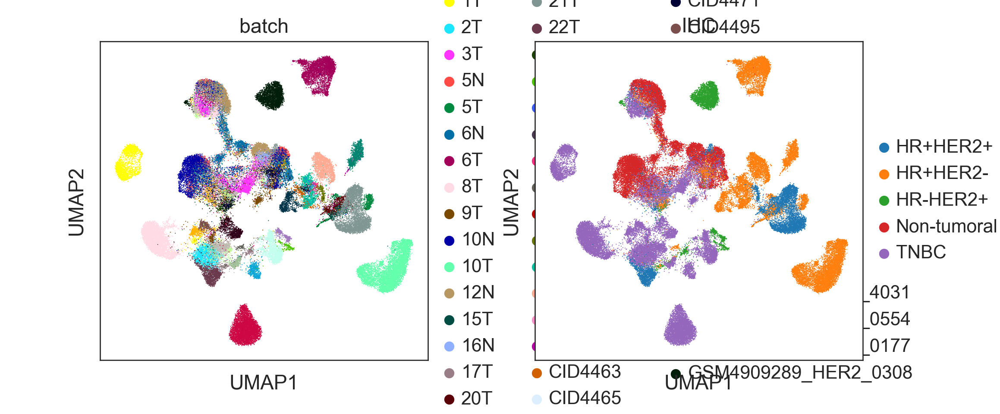

In [1358]:
sc.pl.umap(adata_epi,color=['batch','IHC'])

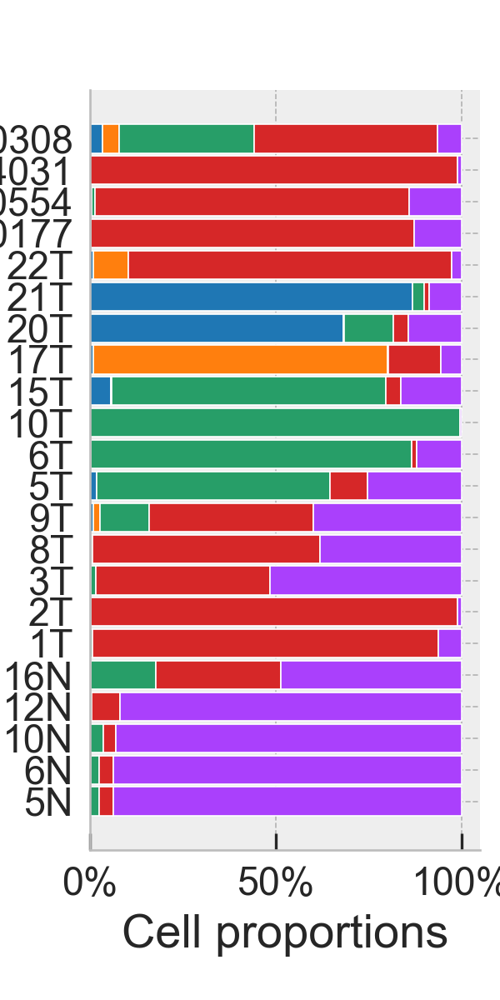

In [1286]:
subtypes = ['HR+HER2+', 'HR-HER2+', 'HR+HER2-', 'TNBC', 'Normal']
barlabels = ['5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T', 'GSM4909288_TNB1_0177', 'GSM4909287_TNB1_0554', 'GSM4909285_TNB1_4031', 'GSM4909289_HER2_0308']
age_df = pd.DataFrame(columns = list(subtypes))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_epiYBC[(adata_epiYBC.obs['BCYType1'] == ct) & (adata_epiYBC.obs["batch"] == bar)]) for ct in list(subtypes)], index = list(subtypes), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
with plt.style.context('bmh'):
    fig, ax = plt.subplots(figsize=(2.5,5))
    propPlot(age_df, barlabels, ax)
    fig.savefig(f"{figPath}/3j-BCYtype-prop3.pdf", bbox_inches='tight')

In [1306]:
adata_epi.obs['study']

AAACCCAAGACCAAGC-1T                                    Young
AAACCCATCACTTTGT-1T                                    Young
AAACGAAAGCGGATCA-1T                                    Young
AAACGAACACAGTGTT-1T                                    Young
AAACGCTCAAGCAATA-1T                                    Young
                                                    ...     
TTTGGTTTCTCAAACG-1-GSM4909289_HER2_0308-Young    Young-inter
TTTGTCACAGACGCTC-1-GSM4909289_HER2_0308-Young    Young-inter
TTTGTCAGTAGCACGA-1-GSM4909289_HER2_0308-Young    Young-inter
TTTGTCAGTAGGCATG-1-GSM4909289_HER2_0308-Young    Young-inter
TTTGTCATCCGTTGCT-1-GSM4909289_HER2_0308-Young    Young-inter
Name: study, Length: 76216, dtype: category
Categories (3, object): ['Young', 'Non-young', 'Young-inter']

In [1323]:
adata_epi1 = adata_epi[adata_epi.obs['study'].isin(['Young', 'Non-young'])]
adata_epi1_TNBC = adata_epi1[adata_epi1.obs['IHC'].isin(['TNBC'])]
dds=ov.bulk.pyDEG(pd.DataFrame(adata_epi1_TNBC.X.todense(), 
                               index=list(adata_epi1_TNBC.obs_names),
                               columns=list(adata_epi1_TNBC.var_names)).T)
treatment_groups=list(adata_epi1_TNBC[adata_epi1_TNBC.obs['age'].isin(['Young'])].obs_names)
control_groups=list(adata_epi1_TNBC[adata_epi1_TNBC.obs['age'].isin(['Non-young'])].obs_names)
result=dds.deg_analysis(treatment_groups,control_groups,method='ttest')

In [1355]:
TNBC_degs = result.loc[(result['log2FC']>2) * (result['qvalue']<0.05), :]
'CXCL14' in TNBC_degs.index

True

In [1347]:
dds.result.loc[(dds.result['log2FC']>2) * (dds.result['qvalue']<0.05),:]

,pvalue,qvalue,FoldChange,MaxBaseMean,BaseMean,log2(BaseMean),log2FC,abs(log2FC),size,-log(pvalue),-log(qvalue),sig
PLCH2,0.000000e+00,0.000000e+00,6.511305,0.021545,0.012426,-6.330464,2.702947,2.702947,0.651131,inf,6.000000,up
TTC34,6.434729e-04,9.538312e-04,7.715749,0.000837,0.000472,-11.048937,2.947806,2.947806,0.771575,3.191470,3.020528,up
HES5,3.177034e-08,5.860307e-08,5.719489,0.002932,0.001722,-9.181813,2.515886,2.515886,0.571949,7.497978,6.000000,up
AJAP1,7.179630e-04,1.060608e-03,42.562592,0.000829,0.000424,-11.204639,5.411514,5.411514,4.256259,3.143898,2.974445,up
TMEM51-AS1,2.250046e-21,6.104641e-21,8.520791,0.006217,0.003473,-8.169696,3.090987,3.090987,0.852079,20.647810,6.000000,up
...,...,...,...,...,...,...,...,...,...,...,...,...
KCNE1B,3.074134e-02,3.953767e-02,345.364960,0.000421,0.000211,-12.213589,8.431978,8.431978,34.536495,1.512277,1.402989,up
ERG,3.382246e-15,7.824248e-15,11.627364,0.005972,0.003242,-8.268711,3.539452,3.539452,1.162736,14.470795,6.000000,up
GRIK1,2.062708e-03,2.955356e-03,9.072160,0.000446,0.000247,-11.983148,3.181446,3.181446,0.907216,2.685562,2.529390,up
B3GALT5,0.000000e+00,0.000000e+00,6.843987,0.024254,0.013899,-6.168909,2.774837,2.774837,0.684399,inf,6.000000,up


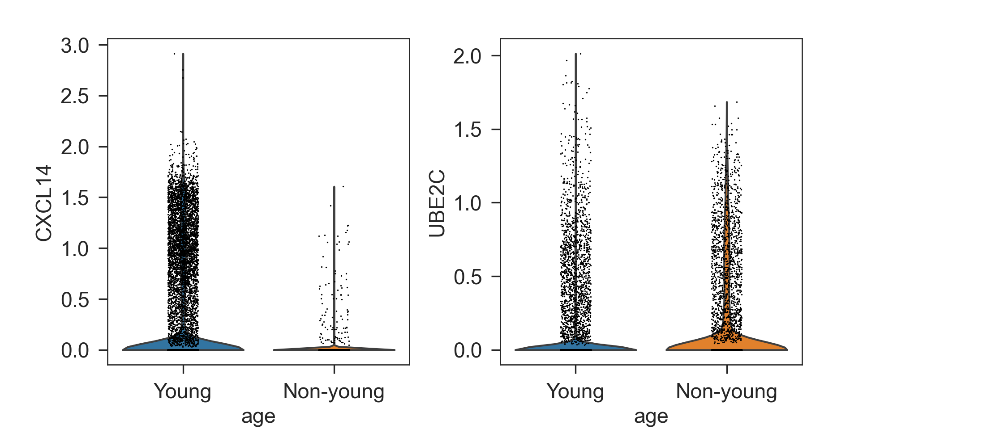

In [1331]:
sc.pl.violin(adata_epi1_TNBC, keys=['CXCL14', 'UBE2C'],  groupby='age')

... Fold change threshold: 2.4714455604553223


<AxesSubplot: title={'center': 'DEG Analysis'}, xlabel='$log_{2}FC$', ylabel='$-log_{10}(qvalue)$'>

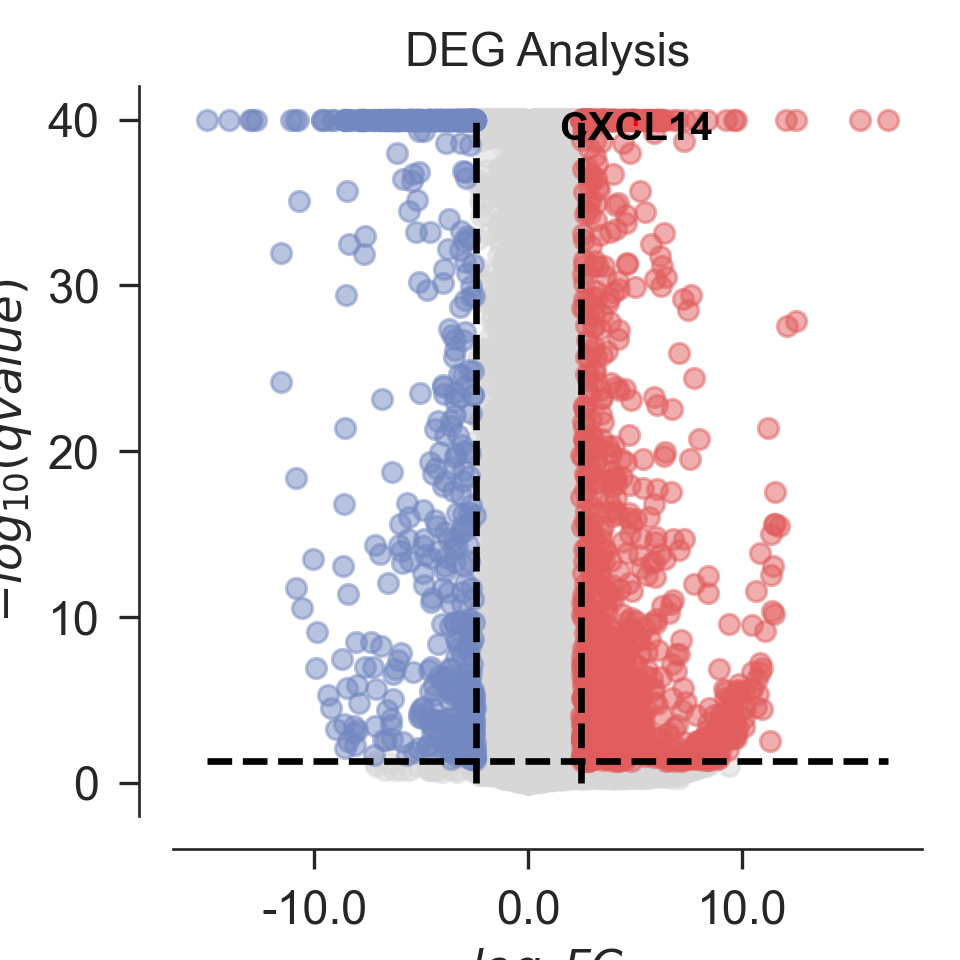

In [1335]:
dds.foldchange_set(fc_threshold=-1,
                   pval_threshold=0.05,
                   logp_max=40)
dds.plot_volcano(title='DEG Analysis',figsize=(4,4), plot_genes=['CXCL14'],up_fontcolor='black',
                 plot_genes_num=8,plot_genes_fontsize=12)

In [1308]:
# HRHer2_degs = DE_memento_1d(adata_epi[adata_epi.obs['IHC'].isin(['HR+HER2+'])], ctleft=['Young'], ctright=['Non-young'], groupby='age', use_raw=False)
TNBC_degs = DE_memento_1d(adata_epi1[adata_epi1.obs['IHC'].isin(['TNBC'])], ctleft=['Young'], ctright=['Non-young'], groupby='age', use_raw=False)

ValueError: [array([inf, nan, inf, ..., nan, nan, inf])] contains non-finite values.

In [1310]:
adata_epi1[adata_epi1.obs['IHC'].isin(['TNBC'])]

View of AnnData object with n_obs × n_vars = 22266 × 17269
    obs: 'batch', 'age', 'majorType-fix', 'IHC', 'study', 'annotation', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation', 'sample', 'cptype', 'straCDH1'
    var: 'n_cells-Non-young', 'highly_variable-Non-young', 'means-Non-young', 'dispersions-Non-young', 'dispersions_norm-Non-young', 'type-Non-young', 'n_cells_by_counts-Young', 'mean_counts-Young', 'log1p_mean_counts-Young', 'pct_dropout_by_counts-Young', 'total_counts-Young', 'log1p_total_counts-Young', 'n_cells-Young', 'highly_variable-Young', 'means-Young', 'dispersions-Young', 'dispersions_norm-Young', 'symbol-Young', 'ensg-Young', 'chromosome-Young', 'start-Young', 'end-Young', 'n_cells_by_counts-Young-inter', 'mean_counts-Young-inter', 'log1p_mean_counts-Young-inter', 'pct_dropout_by_counts-Young-inter', 'total_counts-Young-inter', 'log1p_total_counts-Young-inter', 'n_cells-Young-inter', 'highly_variable-Young-inter', 'means-Young-inter', 'dispersions-Young-inter'

In [1023]:
adata_epiYBC.obs['batch_mol'] = [f"{x}_{y}" for x, y in zip(adata_epiYBC.obs['batch'], adata_epiYBC.obs['IHC'])]

In [1002]:
annoDict = {
  'Non-tumoral': ['5N', '6N', '10N', '12N', '16N'],
  'TNBC': ['1T', '2T', '3T', '8T', '9T', 'CID44991', 'CID4513', 'CID4523', 'CID44971', 'CID4495', 'CID4465','CID44041','CID3946','GSM4909288_TNB1_0177', 'GSM4909287_TNB1_0554', 'GSM4909285_TNB1_4031', 'CID4515'],
  'HR+HER2-': ['5T', '6T', '10T', '15T', 'CID4535', 'CID4067', 'CID4463', 'CID4530N', 'CID4471', 'CID3948','CID4290A','CID4461','CID3941','CID3963','CID4040','CID4398',],
  'HR+HER2+': ['20T', '21T', '22T', 'CID4066', 'CID3586',],
  'HR-HER2+': ['17T', 'CID45171', 'CID3921','GSM4909289_HER2_0308'],
}
adata_YBC = anno(adata_YBC, annoDict, 'IHC', 'batch')

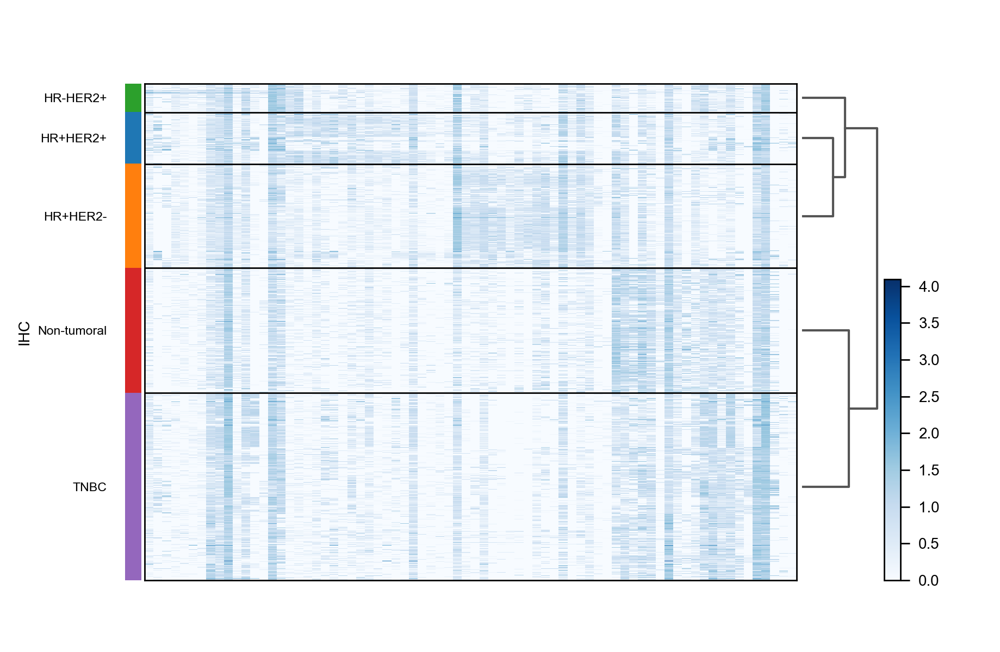

In [1086]:
# fig, ax = plt.subplots(1,1, figsize=(8,3))
sc.tl.rank_genes_groups(adata_epiYBC, groupby='IHC')
sc.tl.dendrogram(adata_epiYBC, groupby='IHC')
sc.pl.rank_genes_groups_heatmap(adata_epiYBC, cmap='Blues', var_names=[
    'PSMB3', 'IFI27', 'S100A9', 'CISD3',"LASP1", 'MRPL45', 'PSMD3', 'TPI1', 'PFN1', 'TPT1', 'URI1', 'TUBB', "CDKN2A",'EGLN3','TMSB10', 'TMSB4X','ERBB2',
   'MIEN1', 'PTRH2', 'CLTC', 'BST2', 'IFI6', 'GRB7', 'S100A14', 'LRRC59', 'COMT', 'TOM1L1', 'SLC25A1', "ISG15",'APPBP2','TAGLN2', 'USP32', 'TRIM37', 'SKA2', 'YPEL2', 
    'COX6C', 'PARD6B', 'CA12', 'TPM3','PRSS23', 'SLC7A2', 'EEF1A2', 'ESR1', 'KCNE4', 'FLNB', 'IGFBP4', "RAB31",'HSPB1','FOXA1', 'GATA3','CDH1', 'POFUT2', 'ADARB1',
   'ZFP36', 'APP', 'SFRP1', 'EGR1', 'PNRC1', 'PER1', 'EEF2', "SRSF5", 'CXCL2', 'XIST', 
    'PERP', 'GSTP1', 'YBX3', 'YBX1',"CALD1", 'IGKC', 'B2M', 'PTMA', 'CXCL14', 'UBE2C','AURKA'
], save='BCYtype-heatmap.svg')

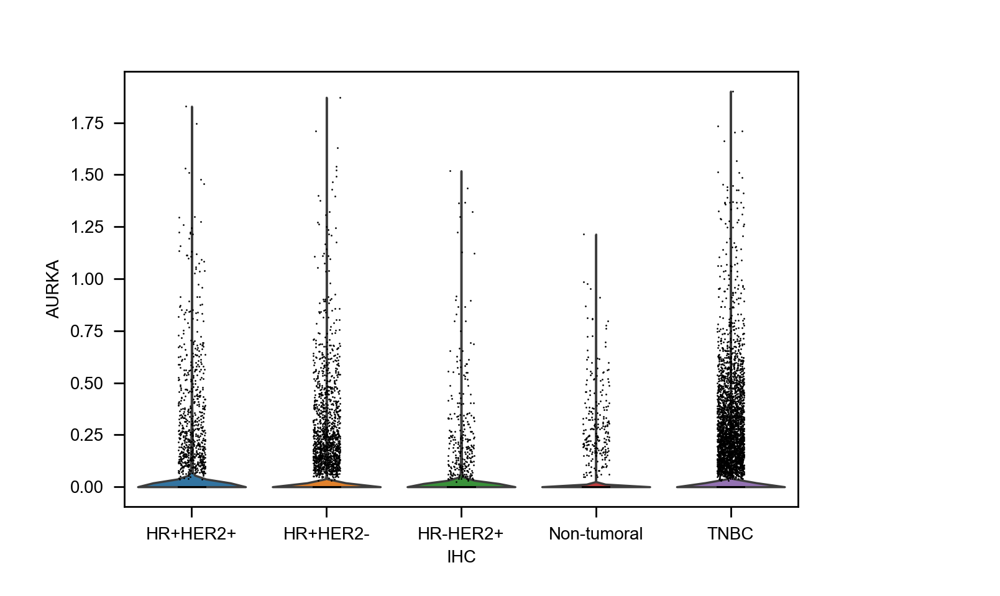

In [1089]:
sc.pl.violin(adata_epi, keys=['AURKA'], groupby='IHC')

In [1090]:
# single-cell level BCYtype
sc.tl.score_genes(adata_epiOBC, score_name='HR+HER2+',gene_list=LumBHer2_list)
sc.tl.score_genes(adata_epiOBC, score_name='HR-HER2+',gene_list=Her2_list)
sc.tl.score_genes(adata_epiOBC, score_name='HR+HER2-',gene_list=LumB_list)
sc.tl.score_genes(adata_epiOBC, score_name='TNBC',gene_list=TNBC_list)
sc.tl.score_genes(adata_epiOBC, score_name='Normal',gene_list=Normal_list)
subtypes = ['HR+HER2+', 'HR-HER2+', 'HR+HER2-', 'TNBC', 'Normal']
arg = np.argmax(np.array(adata_epiOBC.obs[['HR+HER2+', 'HR-HER2+', 'HR+HER2-', 'TNBC', 'Normal']]), axis=1)
adata_epiOBC.obs['BCYType'] = [subtypes[s] for s in arg]

In [1091]:
adata_epiOBC.obs['batch_mol'] = [f"{x}_{y}" for x, y in zip(adata_epiOBC.obs['batch'], adata_epiOBC.obs['IHC'])]

In [1095]:
adata_epiOBC.obs['batch_mol'] = adata_epiOBC.obs['batch_mol'].astype('category')

In [1205]:
import math
def get_pvals(adata, groups, lfc_th=0.5, pvl_th=1e-3):
  names = pd.DataFrame(adata.uns['rank_genes_groups']['names'])[groups]
  lfc = pd.DataFrame(adata.uns['rank_genes_groups']['logfoldchanges'])[groups]
  pvals_adj = pd.DataFrame(adata.uns['rank_genes_groups']['pvals_adj'], dtype='float64')[groups]
  pvals = pd.DataFrame(adata.uns['rank_genes_groups']['pvals'], dtype='float64')[groups]
  data = pd.concat([names, lfc, pvals, pvals_adj], axis=1)
  data.columns = ['genes', 'log2FC', 'p_value', 'p_adj']
  data.loc[(data.log2FC > lfc_th) & (data.p_value <pvl_th), 'type'] = 'up'
  data.loc[(data.log2FC < -lfc_th) & (data.p_value < pvl_th), 'type'] = 'down'
  data.loc[(abs(data.log2FC) <= lfc_th) | (data.p_value >= pvl_th), 'type'] = 'nosig'
  data['sig'] = data['type'].astype('category')
  data['-log10p'] = -(data['p_adj']+10e-20).astype('float').apply(math.log10)
  data.index = data['genes']
  return data

def get_degenes(adata, groupby, n_top=200, lfc_th=0.5, pvl_th=1e-3):
  groups = adata.obs[groupby].unique()
  assert len(groups) == 2, 'Please provide two groups'
  up_data = get_pvals(adata, groups[0],lfc_th)
  down_data = get_pvals(adata, groups[1],pvl_th)
  up_data = up_data[up_data['sig'] == 'up']
  down_data = down_data[down_data['sig'] == 'up']
  up_list = list(up_data.loc[:n_top, 'genes'])
  down_list = list(down_data.loc[:n_top, 'genes'])
  down_list.reverse()
  up_list.extend(down_list)
  return up_list

In [1144]:
adata_epiYBC.obs['study']

AAACCCAAGACCAAGC-1T                                    Young
AAACCCATCACTTTGT-1T                                    Young
AAACGAAAGCGGATCA-1T                                    Young
AAACGAACACAGTGTT-1T                                    Young
AAACGCTCAAGCAATA-1T                                    Young
                                                    ...     
TTTGGTTTCTCAAACG-1-GSM4909289_HER2_0308-Young    Young-inter
TTTGTCACAGACGCTC-1-GSM4909289_HER2_0308-Young    Young-inter
TTTGTCAGTAGCACGA-1-GSM4909289_HER2_0308-Young    Young-inter
TTTGTCAGTAGGCATG-1-GSM4909289_HER2_0308-Young    Young-inter
TTTGTCATCCGTTGCT-1-GSM4909289_HER2_0308-Young    Young-inter
Name: study, Length: 62629, dtype: category
Categories (2, object): ['Young', 'Young-inter']

In [1145]:
adata_epiYBCpure = adata_epiYBC[adata_epiYBC.obs['study'].isin(['Young'])]

In [1146]:
YoungT_degs = prep_enrichr(adata_epiYBCpure, groupby='cnv_status')
NonYoungT_degs = prep_enrichr(adata_epiOBC, groupby='cnv_status')

In [1162]:
Young_gene = Young_degs[(Young_degs['Young_logfoldchanges'] > 1) * (Young_degs['Young_pvals_adj'] < 1e-20)][:200]['Young_names']

In [ ]:
up_data = get_pvals(adata_epiYBCpure, 'Tumor')
up_data = up_data[up_data['sig'] == 'up']
up_data['genes']

,genes,log2FC,p_value,p_adj,type,sig,-log10p
genes,,,,,,,
COX6C,COX6C,1.586727,0.000000,0.000000,up,up,19.000000
TPM3,TPM3,1.518758,0.000000,0.000000,up,up,19.000000
PARD6B,PARD6B,2.231638,0.000000,0.000000,up,up,19.000000
HSPB1,HSPB1,1.479150,0.000000,0.000000,up,up,19.000000
EEF1A2,EEF1A2,3.407893,0.000000,0.000000,up,up,19.000000
...,...,...,...,...,...,...,...
HPN-AS1,HPN-AS1,0.780047,0.000921,0.001311,up,up,2.882323
GRIN3B,GRIN3B,2.022334,0.000930,0.001324,up,up,2.878241
VWA7,VWA7,0.564937,0.000944,0.001342,up,up,2.872245


In [1278]:
from scipy import stats
def Gexplot_adata(adata, gene, ax, group='batch'):
  sns.set_style("ticks")
  if gene in adata.obs.columns:
    data = adata.obs[[gene, group]]
  elif gene in adata.var_names:
    data = adata.obs[[group]]
    data[gene] = np.array(adata[:,gene].X.todense()).flatten()
  else:
    raise ValueError(f"{gene} not found in .obs or .var_names.")
  sc.pl.violin(adata, keys=[gene], groupby=group, width=.6, ax=ax, show=False)
  ax.set_ylim(min(data[gene])-0.05, max(data[gene]+0.3))
  ax.set_xticklabels(['NT', 'NN', 'YT HR-', 'YN', 'YT HR+'])
  # sns.lineplot(x=[0, 2], y=max(data[gene])+0.3, color='black', linewidth=1.2, ax=ax)
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)
  return ax

In [1173]:
YoungTgenes = list(set(Young_gene).intersection(up_data['genes']))

In [ ]:
OBCTup_data = get_pvals(adata_epiOBC, 'Tumor')
OBCTup_data = OBCTup_data[OBCTup_data['sig'] == 'up']
up_data['genes']

genes
S100P        S100P
SCD            SCD
HSPB1        HSPB1
HAGHL        HAGHL
PITX1        PITX1
            ...   
ABCB4        ABCB4
FAM71F1    FAM71F1
ASPHD1      ASPHD1
NOX4          NOX4
FBXO24      FBXO24
Name: genes, Length: 3339, dtype: object

In [1224]:
YBCTup_data = get_pvals(adata_epiYBCpure, 'Tumor')
YBCTup_data = YBCTup_data[YBCTup_data['sig'] == 'up']
YBCTdown_data = get_pvals(adata_epiYBCpure, 'Normal')
YBCTdown_data = YBCTdown_data[YBCTdown_data['sig'] == 'up']
OBCTup_data = get_pvals(adata_epiOBC, 'Tumor')
OBCTup_data = OBCTup_data[OBCTup_data['sig'] == 'up']
OBCTdown_data = get_pvals(adata_epiOBC, 'Normal', lfc_th=0.4)
OBCTdown_data = OBCTdown_data[OBCTdown_data['sig'] == 'up']
Young_gene = Young_degs[(Young_degs['Young_logfoldchanges'] > 1) * (Young_degs['Young_pvals_adj'] < 1e-20)][:200]['Young_names']
YoungTgenes = list(set(Young_gene).intersection(YBCTup_data['genes']))
req_list = list(set(YoungTgenes).difference(OBCTup_data['genes']))
myreq_list = list(set(YoungTgenes).intersection(OBCTdown_data['genes']))
required = YBCTup_data.loc[req_list, ['genes','log2FC','p_value','p_adj', '-log10p']]
myrequired = OBCTdown_data.loc[myreq_list, ['genes','log2FC','p_value','p_adj', '-log10p']]
required.to_csv('ytdf20250603.tsv', sep='\t')
myrequired.to_csv('ondf20250609.tsv', sep='\t')

In [1221]:
YBCTup_data = get_pvals(adata_epiYBCpure, 'Tumor')
YBCTup_data.loc['IGF1R', ['genes','log2FC','p_value','p_adj', '-log10p']]

genes         IGF1R
log2FC     0.609313
p_value         0.0
p_adj           0.0
-log10p        19.0
Name: IGF1R, dtype: object

In [1220]:
OBCTdown_data.loc['IGF1R', ['genes','log2FC','p_value','p_adj', '-log10p']]

genes         IGF1R
log2FC     1.218877
p_value         0.0
p_adj           0.0
-log10p        19.0
Name: IGF1R, dtype: object

In [1191]:
YBCTdown_data = get_pvals(adata_epiYBCpure, 'Normal')

In [1195]:
OBCTup_data = get_pvals(adata_epiOBC, 'Tumor')

In [1193]:
YBCTup_data.loc[['A2M', 'TAGLN', 'DST'], :]

,genes,log2FC,p_value,p_adj,type,sig,-log10p
genes,,,,,,,
A2M,A2M,-2.415784,0.0,0.0,down,down,19.0
TAGLN,TAGLN,-2.193662,0.0,0.0,down,down,19.0
DST,DST,-1.719559,0.0,0.0,down,down,19.0


In [1196]:
OBCTup_data.loc[['A2M', 'TAGLN', 'DST'], :]

,genes,log2FC,p_value,p_adj,type,sig,-log10p
genes,,,,,,,
A2M,A2M,-1.234290,3.082843e-06,1.040407e-05,down,down,4.982797
TAGLN,TAGLN,-1.929069,2.074781e-35,3.275082e-34,down,down,19.000000
DST,DST,-1.658425,4.619880e-83,2.516742e-81,down,down,19.000000


In [1223]:
import omicverse as ov

In [ ]:
dds=ov.bulk.pyDEG(adata_epi)

In [ ]:

def anno(adata:ad.AnnData, annoDict:dict, obsKey='cnv_status', obsVal='cnv_leiden', default="Unknown"):
  if default is not None:
    adata.obs[obsKey] = default
  for key in annoDict.keys():
    adata.obs.loc[adata.obs[obsVal].isin(annoDict[key]), obsKey] = key
  return adata

AnnData object with n_obs × n_vars = 76216 × 17269
    obs: 'batch', 'age', 'majorType-fix', 'IHC', 'study', 'annotation', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation', 'sample', 'cptype'
    var: 'n_cells-Non-young', 'highly_variable-Non-young', 'means-Non-young', 'dispersions-Non-young', 'dispersions_norm-Non-young', 'type-Non-young', 'n_cells_by_counts-Young', 'mean_counts-Young', 'log1p_mean_counts-Young', 'pct_dropout_by_counts-Young', 'total_counts-Young', 'log1p_total_counts-Young', 'n_cells-Young', 'highly_variable-Young', 'means-Young', 'dispersions-Young', 'dispersions_norm-Young', 'symbol-Young', 'ensg-Young', 'chromosome-Young', 'start-Young', 'end-Young', 'n_cells_by_counts-Young-inter', 'mean_counts-Young-inter', 'log1p_mean_counts-Young-inter', 'pct_dropout_by_counts-Young-inter', 'total_counts-Young-inter', 'log1p_total_counts-Young-inter', 'n_cells-Young-inter', 'highly_variable-Young-inter', 'means-Young-inter', 'dispersions-Young-inter', 'dispersions_norm-

In [1262]:
adata_epi.obs['straCDH1'] = '5Young HR+'
adata_epi.obs.loc[adata_epi.obs['IHC'].isin(['HR-HER2+', 'TNBC']), 'straCDH1'] = '3Young HR-'
adata_epi.obs.loc[adata_epi.obs['IHC'].isin(['Non-tumoral']), 'straCDH1'] = '4Young normal'
adata_epi.obs.loc[adata_epi.obs['age'].isin(['Non-young']), 'straCDH1'] = '1Non-young tumor'
adata_epi.obs.loc[adata_epi.obs['age'].isin(['Non-young']) & adata_epi.obs['cnv_status'].isin(['Normal']), 'straCDH1'] = '2Non-young normal'
adata_epi.obs['straCDH1'] = adata_epi.obs['straCDH1'].astype("category")
adata_epi.obs['straCDH1']

AAACCCAAGACCAAGC-1T                              3Young HR-
AAACCCATCACTTTGT-1T                              3Young HR-
AAACGAAAGCGGATCA-1T                              3Young HR-
AAACGAACACAGTGTT-1T                              3Young HR-
AAACGCTCAAGCAATA-1T                              3Young HR-
                                                    ...    
TTTGGTTTCTCAAACG-1-GSM4909289_HER2_0308-Young    3Young HR-
TTTGTCACAGACGCTC-1-GSM4909289_HER2_0308-Young    3Young HR-
TTTGTCAGTAGCACGA-1-GSM4909289_HER2_0308-Young    3Young HR-
TTTGTCAGTAGGCATG-1-GSM4909289_HER2_0308-Young    3Young HR-
TTTGTCATCCGTTGCT-1-GSM4909289_HER2_0308-Young    3Young HR-
Name: straCDH1, Length: 76216, dtype: category
Categories (5, object): ['1Non-young tumor', '2Non-young normal', '3Young HR-', '4Young normal', '5Young HR+']

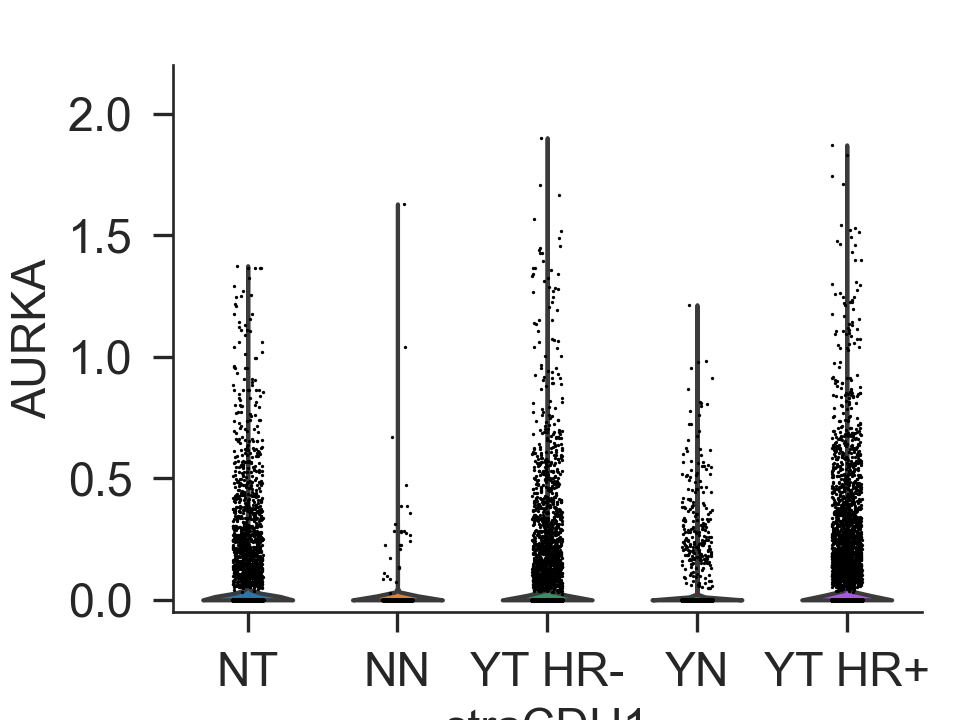

In [1279]:
fig, ax = plt.subplots(figsize=(4,3))
Gexplot_adata(adata_epi[adata_epi.obs['study'].isin(['Young', 'Non-young',])], gene='AURKA', ax=ax, group='straCDH1')
fig.savefig(f"{figPath}/AURKA_stra.svg", bbox_inches='tight')

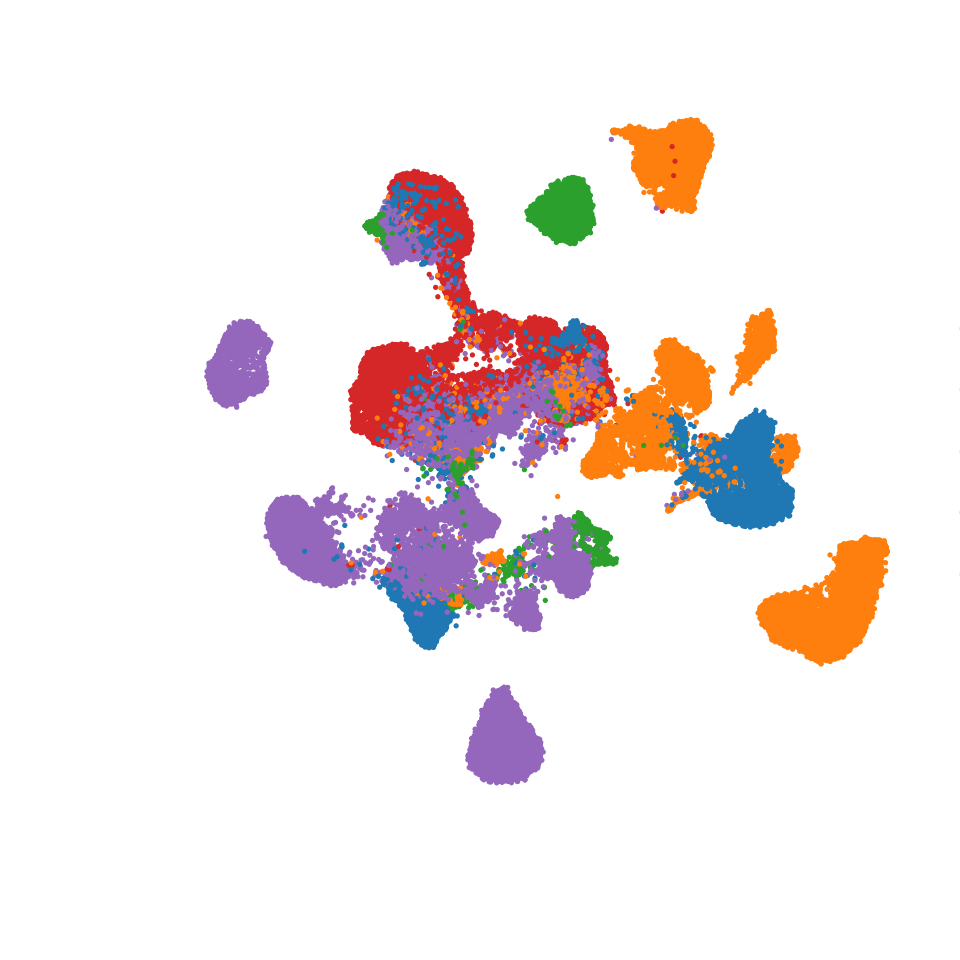

In [1359]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_epi, color=['IHC'],size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/S3-IHC.png', dpi=400, bbox_inches='tight')

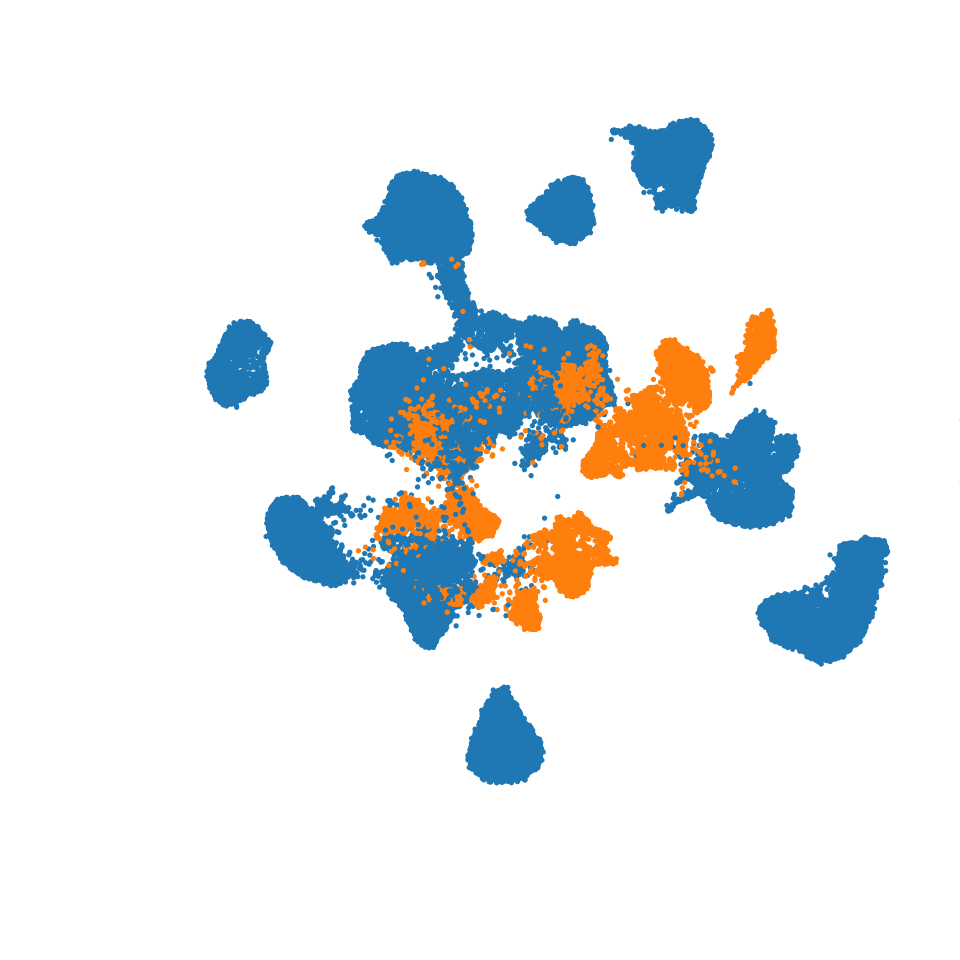

In [1360]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_epi, color=['age'],size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/S3-age.png', dpi=400, bbox_inches='tight')

In [1246]:
adata_epi[adata_epi.obs['age'].isin(['Non-young']) & adata_epi.obs['cnv_status'].isin(['Normal'])]

View of AnnData object with n_obs × n_vars = 1691 × 17269
    obs: 'batch', 'age', 'majorType-fix', 'IHC', 'study', 'annotation', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation', 'sample', 'cptype', 'CDH1'
    var: 'n_cells-Non-young', 'highly_variable-Non-young', 'means-Non-young', 'dispersions-Non-young', 'dispersions_norm-Non-young', 'type-Non-young', 'n_cells_by_counts-Young', 'mean_counts-Young', 'log1p_mean_counts-Young', 'pct_dropout_by_counts-Young', 'total_counts-Young', 'log1p_total_counts-Young', 'n_cells-Young', 'highly_variable-Young', 'means-Young', 'dispersions-Young', 'dispersions_norm-Young', 'symbol-Young', 'ensg-Young', 'chromosome-Young', 'start-Young', 'end-Young', 'n_cells_by_counts-Young-inter', 'mean_counts-Young-inter', 'log1p_mean_counts-Young-inter', 'pct_dropout_by_counts-Young-inter', 'total_counts-Young-inter', 'log1p_total_counts-Young-inter', 'n_cells-Young-inter', 'highly_variable-Young-inter', 'means-Young-inter', 'dispersions-Young-inter', 'di

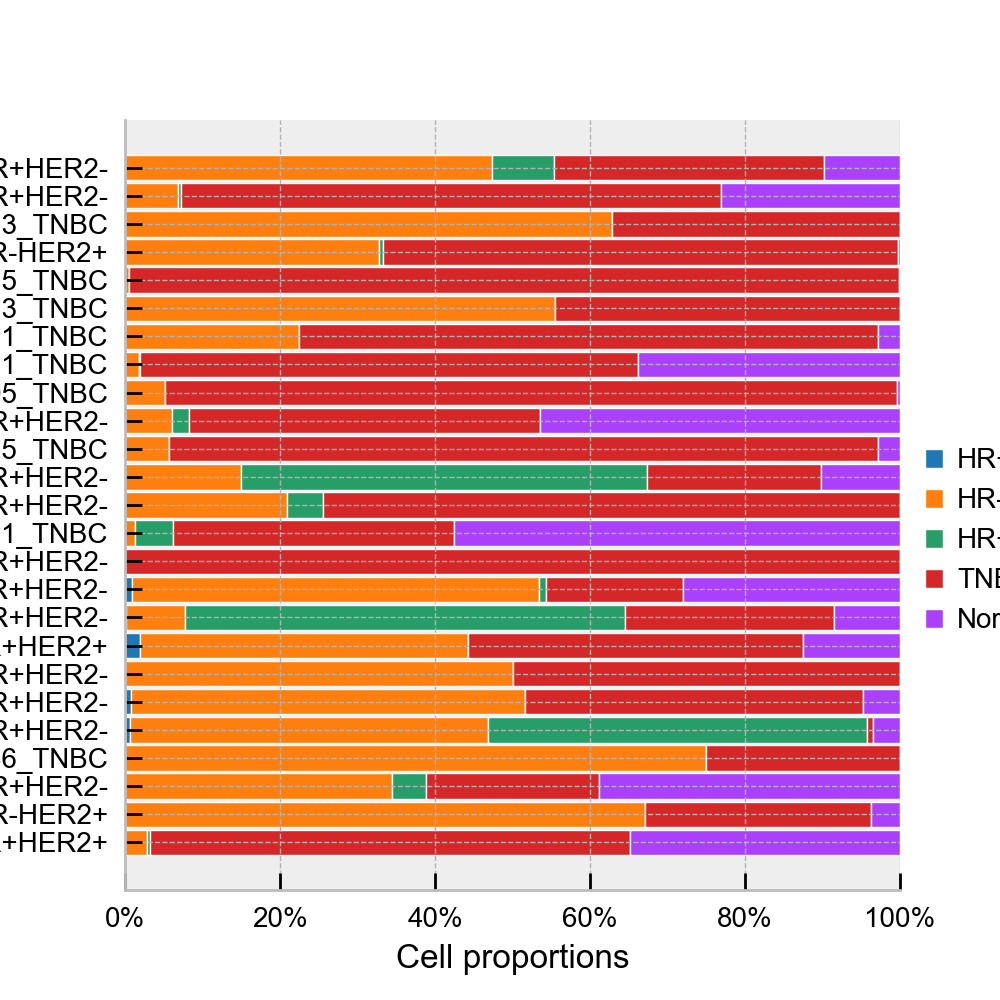

In [1098]:
subtypes = ['HR+HER2+', 'HR-HER2+', 'HR+HER2-', 'TNBC', 'Normal']
barlabels = adata_epiOBC.obs['batch_mol'].cat.categories
age_df = pd.DataFrame(columns = list(subtypes))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_epiOBC[(adata_epiOBC.obs['BCYType'] == ct) & (adata_epiOBC.obs["batch_mol"] == bar)]) for ct in list(subtypes)], index = list(subtypes), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
with plt.style.context('bmh'):
    fig, ax = plt.subplots(figsize=(5,5))
    propPlot(age_df, barlabels, ax)
    fig.savefig(f"{figPath}/3j-BCYtype-prop2.pdf", bbox_inches='tight')